<a href="https://colab.research.google.com/github/yongtaoliu/dual-GP/blob/main/DualGP_Manuscript_Notebook_HIP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dual GP

*  Dual GP developed by [Yongtao Liu](https://youngtaoliu.wixsite.com/yongtaoliu) using GP in GPax
*  Update April 7, 2024

# Install and Import

In [ ]:
!pip install gpax

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.4/103.4 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 330.2/330.2 kB 13.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 371.7/371.7 kB 33.1 MB/s eta 0:00:00


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.cm as cm

import gpax
import numpyro
import jax.random as jra
import jax.numpy as jnp
gpax.utils.enable_x64()
from sklearn.metrics import mean_squared_error

In [ ]:
import matplotlib as mpl
plt.rc('xtick', labelsize=12)
plt.rc('ytick', labelsize=12)
plt.rc('axes', labelsize=12)
mpl.rcParams['figure.dpi'] = 150

# Define test model data for optimization

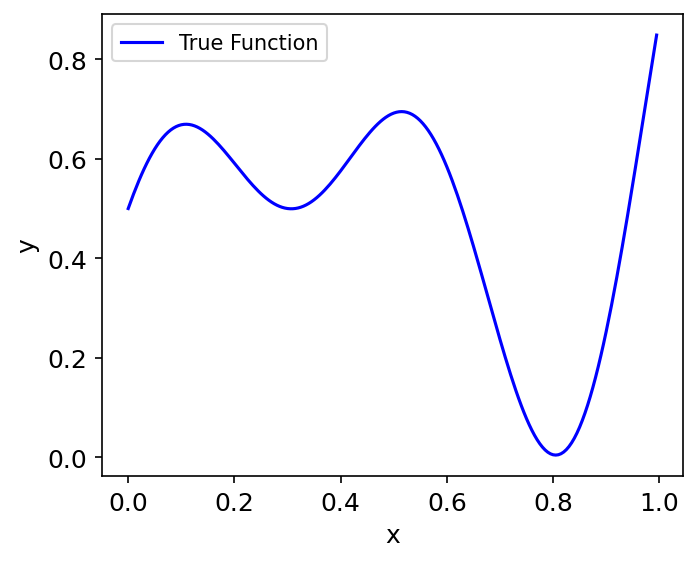

In [ ]:
# objective function
def objective(x, a, b, c):
 return (a + b * x) * np.sin(10*x) + c

np.random.seed(3)

# sample x uniformly
N = 200; i_min = 0; i_max = 1  #inputs number, minimum, and maximum
input_x = np.arange(i_min, i_max, (i_max-i_min)/N)
# compute y without noise
A = 0.3; B = -1; C = 0.5
output_y = objective(input_x, A, B, C)
# plot model data
plt.figure(figsize = (5, 4))
plt.plot(input_x, output_y, label = "True Function", color = "b")
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()

In [ ]:
# make a function to synthesize 1D gaussian peak

def make_gaussian_peak(x, amp, mu=0.5, sigma=0.05, noise_sigma = 0.01):
  """
  Gaussian peak function.

  Returns:
    Gaussian peak values.
  """
  gaussian_peak = amp*np.exp(-(x - mu)**2 / (2 * sigma**2))
  noise = np.random.normal(0, noise_sigma, size=x.shape)
  return gaussian_peak + noise

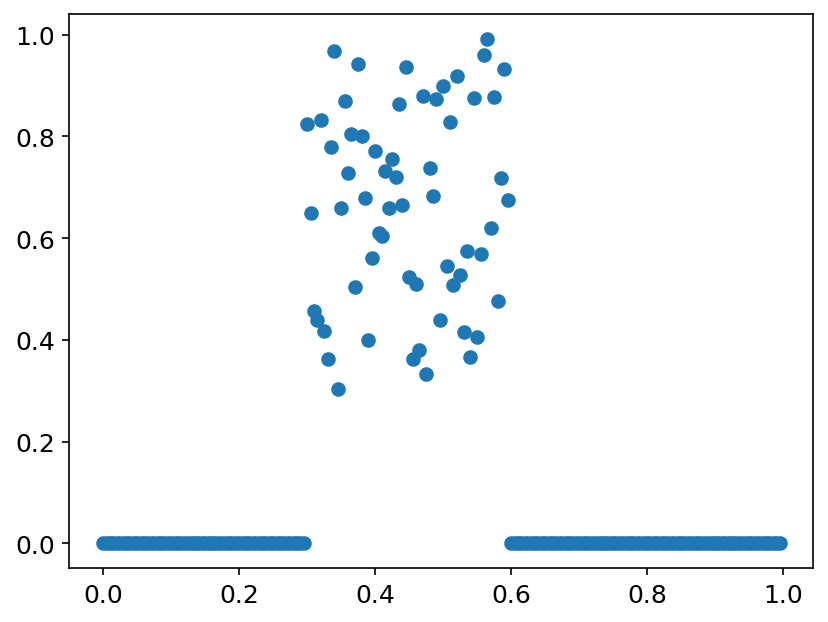

In [ ]:
# Add random distortion between 0.3-0.6 in true fucntion
distort_prob = np.random.uniform(0.3, 1, size=int(N*0.3))
distort_prob = np.append(np.zeros(int(N*0.3)), distort_prob)
distort_prob = np.append(distort_prob, np.zeros(int(N*0.4)))
plt.scatter(input_x, distort_prob)
plt.show()

Make raw peak data

In [ ]:
x_spec = np.linspace(0, 1, 100)
spec_peaks = np.zeros((N, len(x_spec)))
k = 0
np.random.seed(10)
distort_points = np.zeros((N))
def norm_ (z):
  return (z - np.min(z)) / (np.max(z) - np.min(z))
y_amp = output_y

for xi in range (N):
    spec_peaks[xi, :] = make_gaussian_peak(x_spec, y_amp[xi])

    # add distortion depending on the probablity from ZT
    if distort_prob[xi] > np.random.uniform(0.3, 0.7):
      k = k + 1
      distort_points[xi] = 1
      # Distortion is a random Gaussian Peak
      amp_ = np.random.uniform(0.2, 0.5)
      mu_ = np.random.uniform(0.1, 0.9)
      sigma_ = np.random.uniform(0.05, 0.3)
      spec_distortion = make_gaussian_peak(x_spec, amp_, mu_, sigma_)
      spec_peaks[xi, :] = spec_peaks[xi, :] + spec_distortion

syn_spec = spec_peaks

k

44

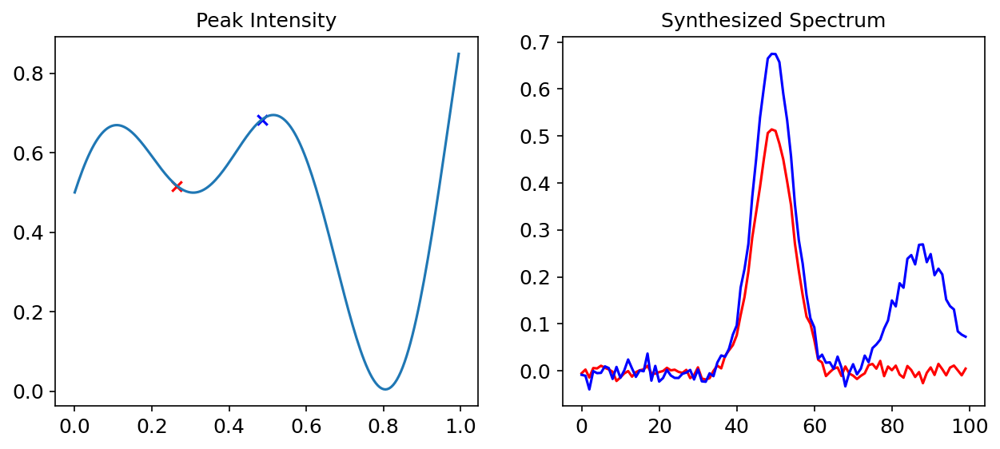

In [ ]:
plot1_idx = 53; plot2_idx = 97
f, (ax1, ax2) = plt.subplots(1, 2, figsize = (10, 4))
ax1.plot(input_x, y_amp)
ax1.scatter (input_x[plot1_idx], y_amp[plot1_idx], marker = 'x', color = 'r')
ax1.scatter (input_x[plot2_idx], y_amp[plot2_idx], marker = 'x', color = 'blue')
ax1.set_title('Peak Intensity')
ax2.plot(syn_spec[plot1_idx], color = 'r')
ax2.plot(syn_spec[plot2_idx], color = 'blue')
ax2.set_title('Synthesized Spectrum')

plt.show()

Extract scalarizer from synthesized peak data

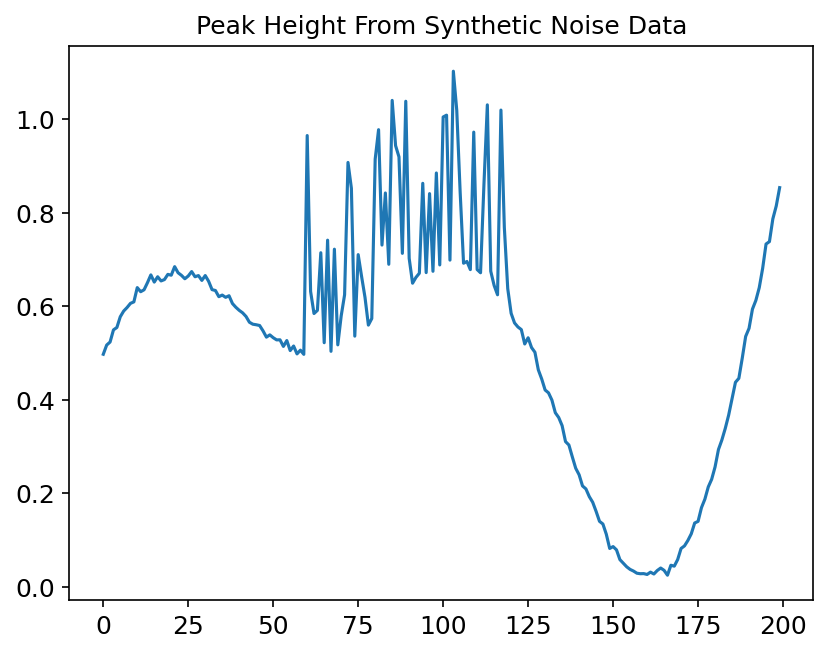

In [ ]:
from scipy.signal import find_peaks

# Define a function to extract peak height
def peak_height(spec_):
  peaks, properties = find_peaks(spec_, height=0.01)
  pk_height = properties['peak_heights'].max()
  return pk_height

peak_heights = np.zeros(N)
for xi in range (N):
    peak_heights[xi] = peak_height(syn_spec[xi])

plt.figure()
plt.plot(peak_heights)
plt.title("Peak Height From Synthetic Noise Data")
plt.show()

# Help functions

In [ ]:
# Help function for initilizing training
def init_training_data_exp(X, Y, num_seed_points=2, rng_seed=42, list_of_indices=None):
    np.random.seed(rng_seed)
    indices = jnp.arange(len(X))
    idx = list_of_indices
    if idx is not None:
        idx = np.array(idx)
    else:
        idx = np.random.randint(0, len(X), num_seed_points)
    idx = np.unique(idx)
    X_train, y_train = X[idx], Y[idx]
    indices_train = indices[idx]
    X_test = jnp.delete(X, idx)
    y_test = jnp.delete(Y, idx, 0)
    indices_test = jnp.delete(indices, idx)
    return X_train, y_train, X_test, y_test, indices_train, indices_test

# Help function for updating train/test data
def update_data(next_point_idx, X_train, X_test, y_train,
                y_train_spec, y_test_spec, indices_train, indices_test):
    X_train = jnp.append(X_train, X_test[next_point_idx][None], 0)
    X_test = jnp.delete(X_test, next_point_idx, 0)
    y_train_spec = jnp.append(y_train_spec, y_test_spec[next_point_idx][None], 0)
    y_train = jnp.append(y_train, scalarizer_function(y_test_spec[next_point_idx][None]))
    y_test_spec = jnp.delete(y_test_spec, next_point_idx, 0)
    indices_train = jnp.append(indices_train, indices_test[next_point_idx])
    indices_test = jnp.delete(indices_test, next_point_idx)
    return X_train, X_test, y_train, y_train_spec, y_test_spec, indices_train, indices_test

def scalarizer_function (all_spec):
  spec_scal = []
  for i in range (len(all_spec)):
    spec_scal.append(peak_height(all_spec[i]))
  return np.asarray(spec_scal)

# GP function

In [ ]:
# Function for performing a GP step, here we use structure GP (sGP)
def run_GP (xtrain, ytrain, xtest, fn = None, fn_priors = None):
  rng_key, rng_key_predict = gpax.utils.get_keys(1)
  # Obtain/update GP posterior
  gp_model = gpax.ExactGP(1, kernel='Matern', mean_fn=fn, mean_fn_prior=fn_priors)
  gp_model.fit(rng_key, xtrain, ytrain)
  # Compute acquisition function
  obj = gpax.acquisition.UE(rng_key_predict, gp_model, X_test)
  # Get GP prediction
  posterior_mean, f_samples = gp_model.predict(rng_key_predict, xtest, n = 200)
  return gp_model, obj, posterior_mean, f_samples

# Functions for sGP mean function and priors
from typing import Dict
# structure mean function
def custom_structure(x, params):
    """Custom structure function"""
    return (params["a"] + params["b"] * x) * jnp.sin(10*x) + params["c"]

# Priors over the mean function
def custom_structure_priors():
    """Priors over linear coefficients"""
    a = numpyro.sample("a", numpyro.distributions.Normal(0, 1))
    b = numpyro.sample("b", numpyro.distributions.Normal(0, 1))
    c = numpyro.sample("c", numpyro.distributions.Normal(0, 1))
    return {"a": a, "b": b, "c": c}

# Perform single GP exploration

### Initialize training data

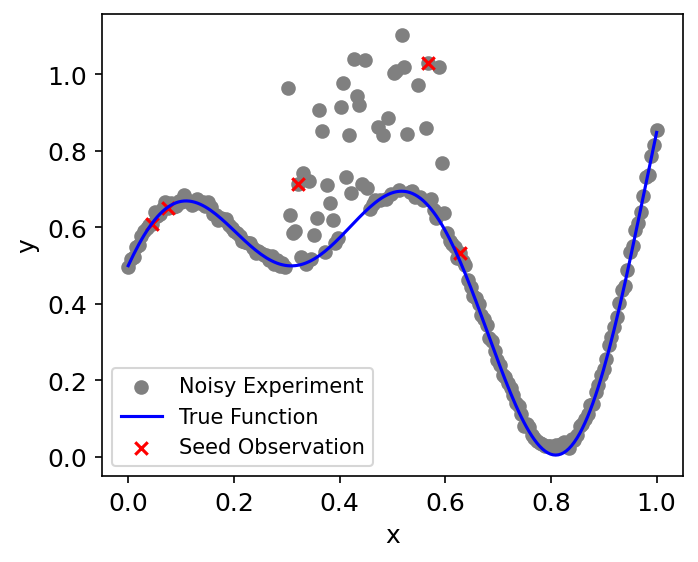

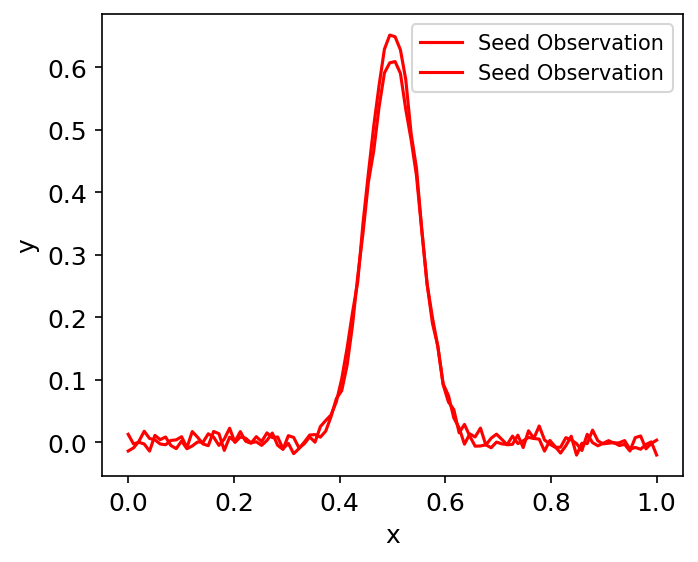

In [ ]:
# Select random initial points
init_points = 5 # number of initial points

# Full dataset
X = jnp.asarray(input_x)
X = norm_(X)
Y_spec = syn_spec

# initialize training data
(X_train, y_train_spec, X_test, y_test_spec,
 indices_train, indices_test) = init_training_data_exp(X, Y_spec, num_seed_points=init_points, rng_seed=10)

y_train = scalarizer_function(y_train_spec)
# Plot initial trian dataset
plt.figure(figsize = (5, 4))
plt.scatter(X, peak_heights, label = "Noisy Experiment", color = "Gray")
plt.plot(X, y_amp, label = "True Function", color = "blue")
plt.scatter(X_train, y_train, label = "Seed Observation", color = 'red', marker = 'x')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()

plt.figure(figsize = (5, 4))
plt.plot(x_spec, y_train_spec[0], label = "Seed Observation", color = 'red')
plt.plot(x_spec, y_train_spec[1], label = "Seed Observation", color = 'red')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()

In [ ]:
# Copy seed points
X_seed = X_train.copy(); y_seed = y_train.copy()

### Start single GP exploration


Exploration step 1


sample: 100%|██████████| 4000/4000 [00:14<00:00, 274.41it/s, 7 steps of size 4.92e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.17      0.60     -0.19     -1.14      0.81   1971.09      1.00
          b     -0.20      0.92     -0.23     -1.61      1.32   2184.43      1.00
          c      0.43      0.68      0.44     -0.78      1.46   1725.62      1.00
k_length[0]      2.06      2.41      1.34      0.07      4.23   1502.53      1.00
    k_scale      1.11      1.24      0.72      0.05      2.42   1597.91      1.00
      noise      0.40      0.43      0.27      0.02      0.83   1437.14      1.00



/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


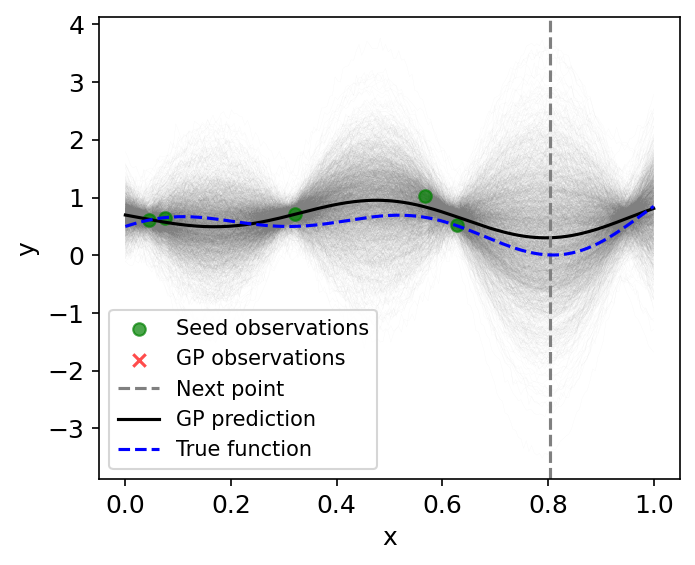


Exploration step 2


sample: 100%|██████████| 4000/4000 [00:17<00:00, 229.32it/s, 15 steps of size 4.07e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.21      0.55     -0.22     -1.07      0.66   1116.80      1.00
          b     -0.35      0.74     -0.36     -1.49      0.91   1225.59      1.00
          c      0.40      0.67      0.45     -0.63      1.50   1210.94      1.00
k_length[0]      2.18      2.51      1.39      0.10      4.61   1253.44      1.00
    k_scale      1.07      1.18      0.70      0.03      2.26   1609.10      1.00
      noise      0.32      0.36      0.21      0.02      0.67   1104.16      1.00



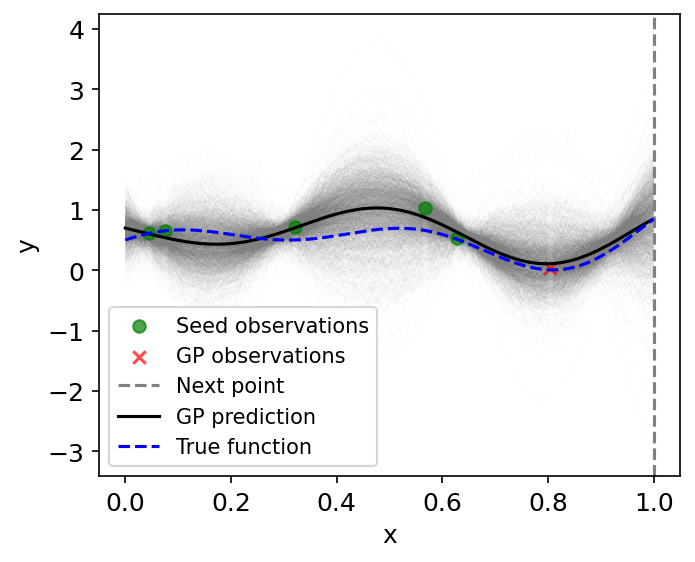


Exploration step 3


sample: 100%|██████████| 4000/4000 [00:16<00:00, 242.77it/s, 15 steps of size 3.37e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.21      0.50     -0.20     -0.98      0.65   1010.11      1.00
          b     -0.34      0.64     -0.35     -1.33      0.73    996.80      1.00
          c      0.41      0.63      0.45     -0.64      1.41    746.54      1.00
k_length[0]      2.46      2.48      1.68      0.07      5.18   1275.07      1.00
    k_scale      1.02      1.16      0.65      0.01      2.21   1071.79      1.01
      noise      0.24      0.28      0.17      0.01      0.49    963.40      1.00



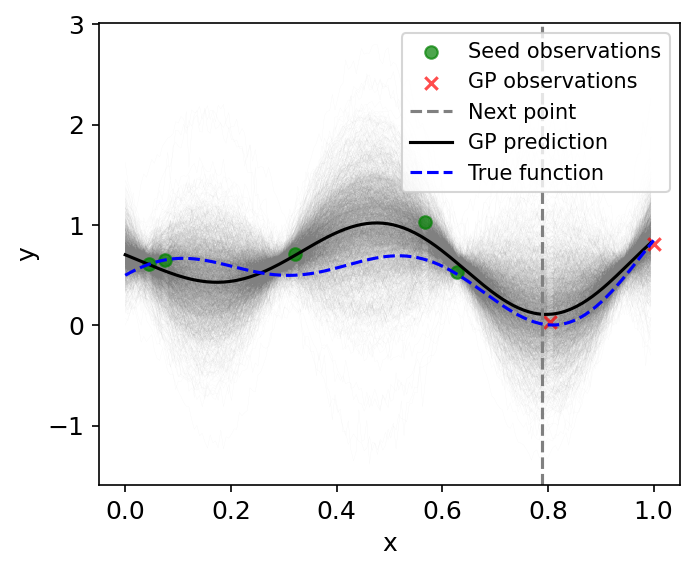


Exploration step 4


sample: 100%|██████████| 4000/4000 [00:13<00:00, 298.85it/s, 15 steps of size 2.99e-01. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.21      0.47     -0.21     -1.00      0.49   1011.60      1.00
          b     -0.39      0.58     -0.41     -1.29      0.62   1056.37      1.00
          c      0.38      0.63      0.41     -0.64      1.42   1107.85      1.00
k_length[0]      2.38      2.56      1.64      0.10      4.93   1334.11      1.00
    k_scale      0.96      1.17      0.61      0.03      2.01   1284.97      1.00
      noise      0.17      0.17      0.11      0.01      0.35   1094.77      1.00



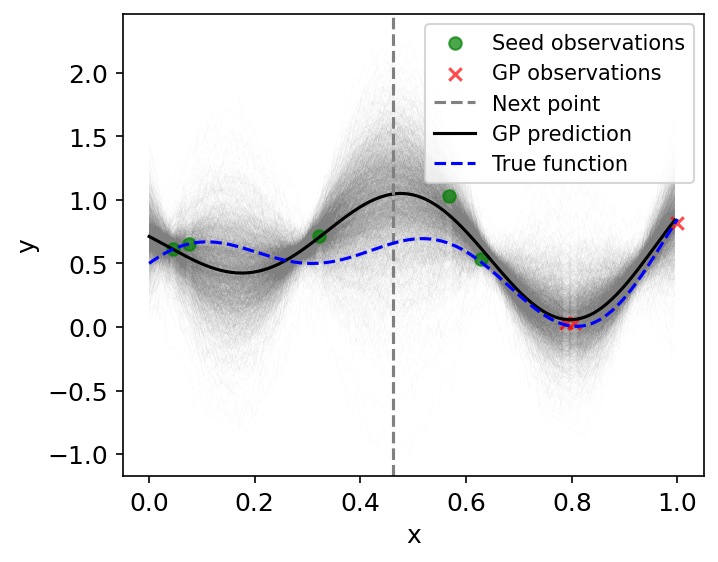


Exploration step 5


sample: 100%|██████████| 4000/4000 [00:14<00:00, 273.42it/s, 7 steps of size 3.53e-01. acc. prob=0.75] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.03      0.39     -0.02     -0.70      0.56    986.33      1.00
          b     -0.54      0.56     -0.56     -1.49      0.33    968.25      1.00
          c      0.37      0.63      0.41     -0.67      1.35    883.03      1.00
k_length[0]      2.75      3.05      1.77      0.12      5.92    967.95      1.00
    k_scale      0.97      1.10      0.62      0.04      2.20   1071.40      1.00
      noise      0.15      0.14      0.11      0.02      0.30    648.37      1.00



/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


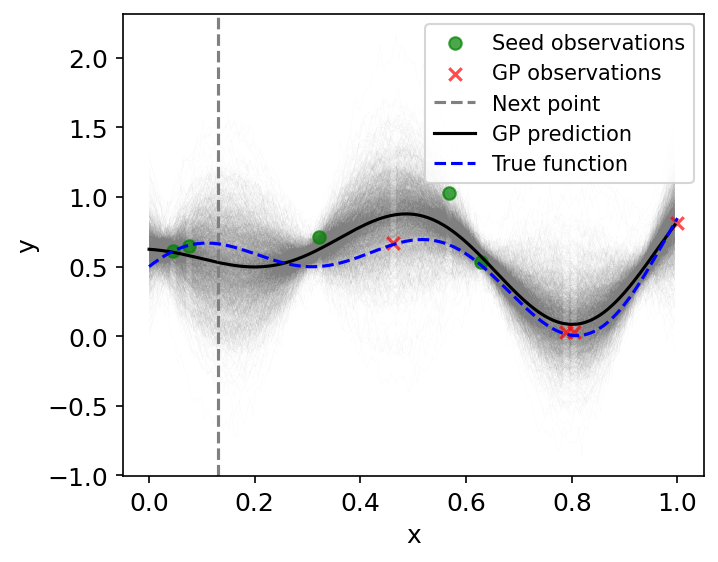


Exploration step 6


sample: 100%|██████████| 4000/4000 [00:14<00:00, 277.85it/s, 15 steps of size 3.32e-01. acc. prob=0.83]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.05      0.31      0.07     -0.46      0.51   1027.15      1.00
          b     -0.65      0.46     -0.66     -1.34      0.14    983.01      1.00
          c      0.36      0.62      0.38     -0.62      1.43    654.22      1.01
k_length[0]      2.76      2.74      1.90      0.13      6.03   1022.70      1.00
    k_scale      0.94      1.09      0.60      0.02      2.04    847.30      1.00
      noise      0.12      0.12      0.09      0.01      0.24    995.52      1.00



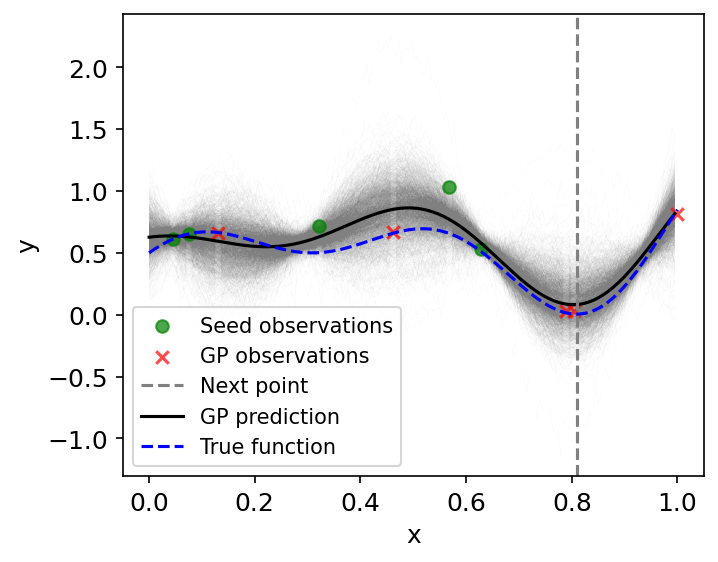


Exploration step 7


sample: 100%|██████████| 4000/4000 [00:15<00:00, 254.51it/s, 15 steps of size 2.12e-01. acc. prob=0.95]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.06      0.28      0.08     -0.41      0.50    925.64      1.00
          b     -0.68      0.42     -0.70     -1.36      0.02    877.82      1.00
          c      0.32      0.64      0.35     -0.75      1.33   1095.18      1.00
k_length[0]      2.86      2.85      2.04      0.16      5.85   1224.85      1.00
    k_scale      0.94      1.06      0.63      0.02      2.05   1352.90      1.00
      noise      0.09      0.08      0.07      0.01      0.18   1009.45      1.00



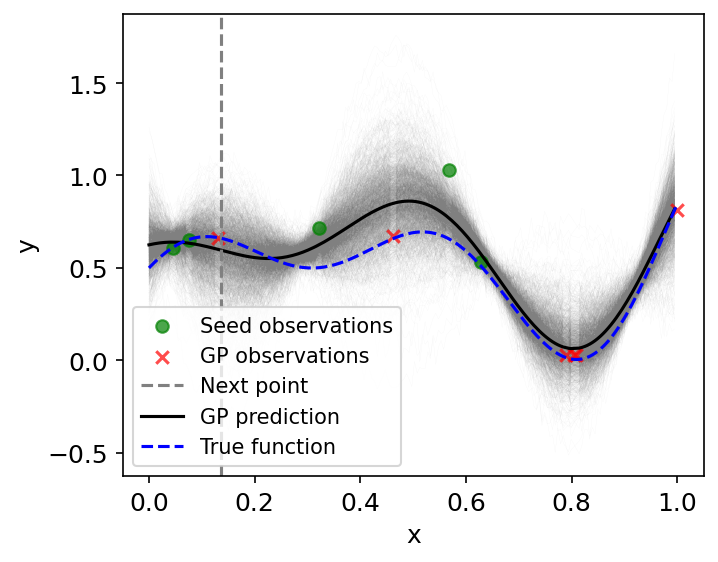


Exploration step 8


sample: 100%|██████████| 4000/4000 [00:14<00:00, 276.24it/s, 15 steps of size 2.50e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.09      0.24      0.10     -0.30      0.47    938.62      1.00
          b     -0.72      0.37     -0.74     -1.31     -0.12    993.29      1.00
          c      0.34      0.61      0.37     -0.67      1.31   1196.87      1.00
k_length[0]      2.93      2.97      2.12      0.13      5.91   1224.12      1.00
    k_scale      0.91      1.05      0.60      0.04      1.94   1362.56      1.00
      noise      0.07      0.06      0.05      0.01      0.14   1036.06      1.00



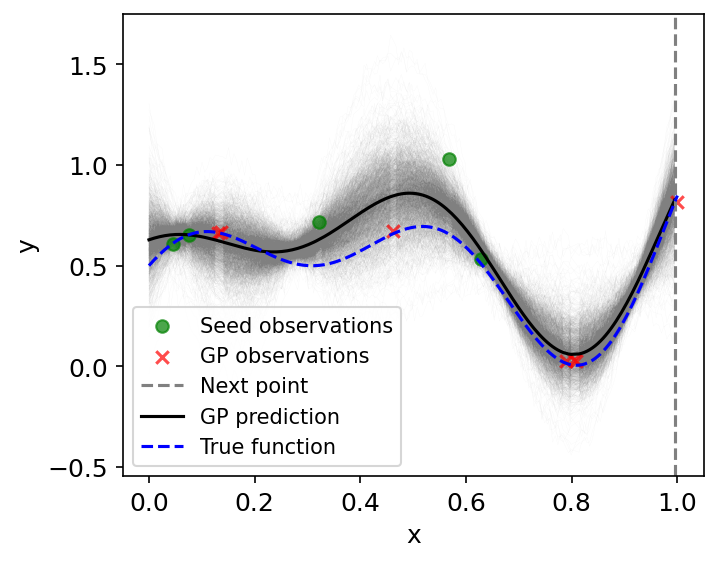


Exploration step 9


sample: 100%|██████████| 4000/4000 [00:17<00:00, 227.42it/s, 15 steps of size 2.64e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.11      0.22      0.11     -0.24      0.48   1162.81      1.00
          b     -0.74      0.33     -0.74     -1.27     -0.21    984.71      1.00
          c      0.33      0.60      0.37     -0.63      1.35   1300.73      1.00
k_length[0]      2.95      3.08      2.11      0.30      6.05   1081.57      1.00
    k_scale      0.90      1.09      0.58      0.04      1.92   1558.30      1.00
      noise      0.06      0.04      0.04      0.01      0.11   1332.51      1.00



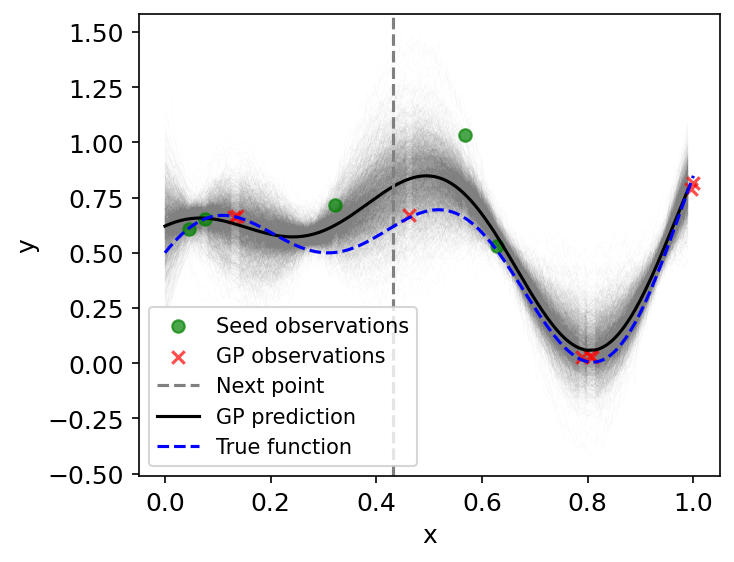


Exploration step 10


sample: 100%|██████████| 4000/4000 [00:14<00:00, 282.80it/s, 15 steps of size 2.94e-01. acc. prob=0.85]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.07      0.21      0.07     -0.30      0.38    891.11      1.00
          b     -0.70      0.33     -0.72     -1.20     -0.18    741.56      1.00
          c      0.33      0.60      0.36     -0.66      1.33    830.87      1.00
k_length[0]      2.82      2.87      2.02      0.14      5.65   1467.74      1.00
    k_scale      0.91      1.06      0.59      0.04      1.97   1571.04      1.00
      noise      0.05      0.04      0.04      0.01      0.09   1096.88      1.00



/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


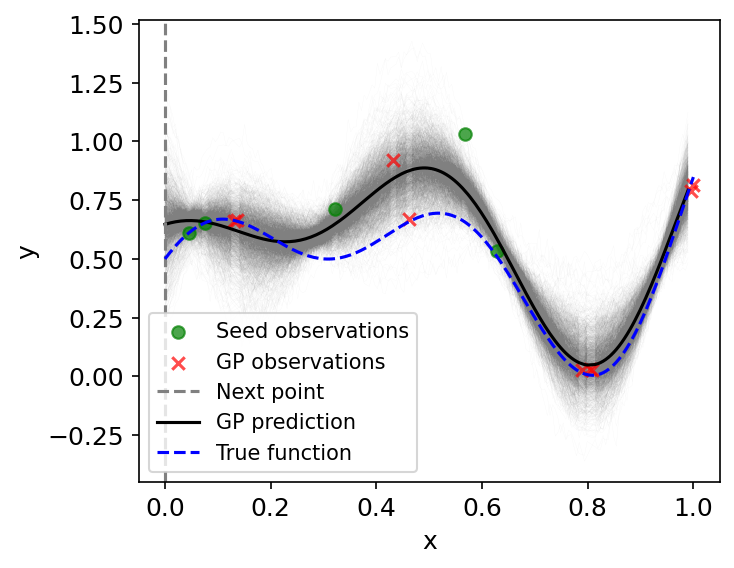


Exploration step 11


sample: 100%|██████████| 4000/4000 [00:27<00:00, 147.31it/s, 15 steps of size 2.84e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.10      0.17      0.11     -0.15      0.40   1282.39      1.00
          b     -0.76      0.27     -0.76     -1.17     -0.30   1399.94      1.00
          c      0.28      0.63      0.30     -0.72      1.36   1154.04      1.00
k_length[0]      2.87      2.65      2.10      0.28      5.97   1249.03      1.00
    k_scale      0.87      1.00      0.58      0.03      1.89   1653.05      1.00
      noise      0.04      0.03      0.03      0.01      0.08   1084.81      1.00



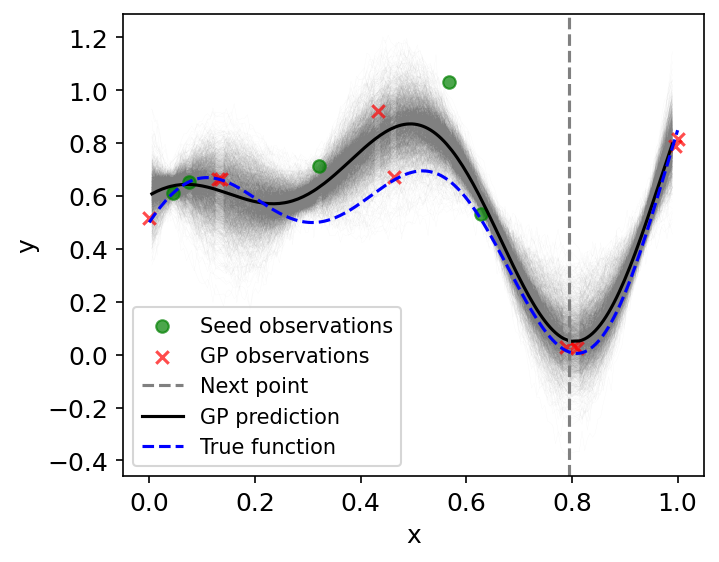


Exploration step 12


sample: 100%|██████████| 4000/4000 [00:16<00:00, 242.55it/s, 15 steps of size 2.55e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.11      0.16      0.11     -0.14      0.38    876.34      1.00
          b     -0.77      0.26     -0.78     -1.18     -0.39    710.49      1.00
          c      0.29      0.62      0.32     -0.74      1.30   1263.64      1.00
k_length[0]      2.93      3.01      2.05      0.29      6.03   1340.83      1.00
    k_scale      0.89      1.03      0.60      0.04      1.87   1303.22      1.00
      noise      0.04      0.02      0.03      0.01      0.07   1237.32      1.00



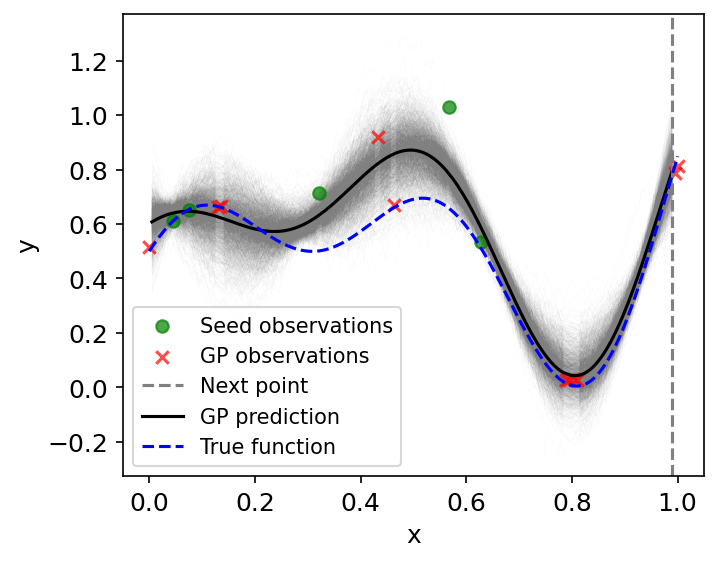


Exploration step 13


sample: 100%|██████████| 4000/4000 [00:16<00:00, 246.31it/s, 15 steps of size 2.68e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.11      0.15      0.12     -0.12      0.38   1156.21      1.00
          b     -0.77      0.23     -0.78     -1.14     -0.39   1094.58      1.00
          c      0.28      0.62      0.31     -0.76      1.29   1432.23      1.00
k_length[0]      2.82      2.71      1.96      0.29      5.89   1256.76      1.00
    k_scale      0.91      1.03      0.58      0.03      2.06   1358.58      1.00
      noise      0.03      0.02      0.03      0.01      0.05   1345.27      1.00



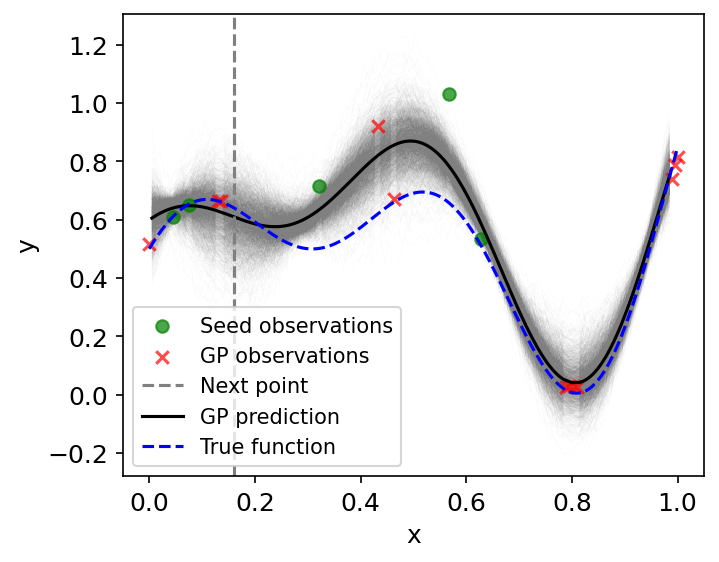


Exploration step 14


sample: 100%|██████████| 4000/4000 [00:15<00:00, 263.41it/s, 31 steps of size 2.31e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.13      0.13      0.13     -0.07      0.35    665.80      1.00
          b     -0.79      0.22     -0.79     -1.13     -0.44    579.55      1.00
          c      0.27      0.63      0.31     -0.72      1.32   1011.62      1.00
k_length[0]      2.80      2.64      2.01      0.28      5.79    980.19      1.00
    k_scale      0.91      1.06      0.60      0.03      1.95   1023.87      1.00
      noise      0.03      0.02      0.02      0.01      0.05   1169.30      1.00



/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


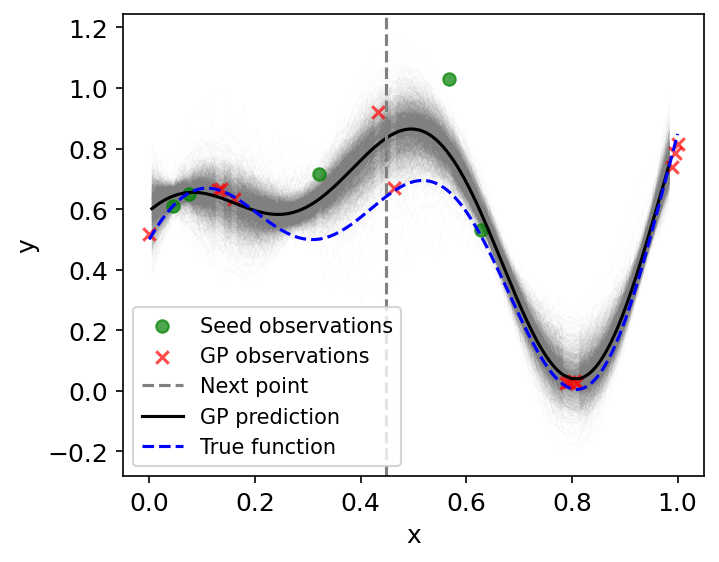


Exploration step 15


sample: 100%|██████████| 4000/4000 [00:18<00:00, 221.53it/s, 15 steps of size 2.53e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.15      0.12      0.15     -0.05      0.35    992.57      1.00
          b     -0.81      0.20     -0.82     -1.13     -0.50   1095.00      1.00
          c      0.27      0.60      0.31     -0.70      1.25   1179.57      1.00
k_length[0]      2.96      2.80      2.12      0.27      6.23   1470.98      1.00
    k_scale      0.89      1.01      0.58      0.04      1.86   1261.45      1.00
      noise      0.03      0.01      0.02      0.01      0.04   1270.70      1.00



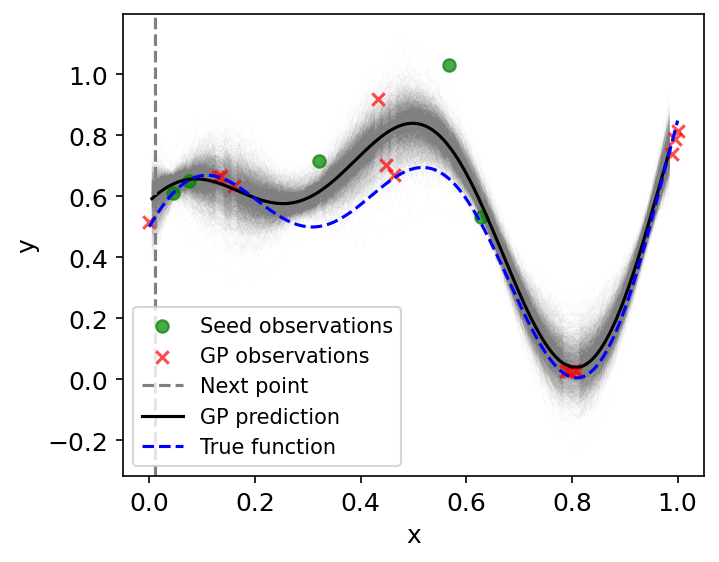


Exploration step 16


sample: 100%|██████████| 4000/4000 [00:15<00:00, 250.01it/s, 15 steps of size 2.22e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.16      0.12      0.16     -0.03      0.35    670.00      1.00
          b     -0.83      0.19     -0.82     -1.13     -0.51    694.82      1.00
          c      0.25      0.64      0.28     -0.78      1.32    969.03      1.00
k_length[0]      3.00      3.19      2.04      0.21      6.08    922.23      1.00
    k_scale      0.89      1.08      0.57      0.05      1.92   1148.48      1.00
      noise      0.02      0.01      0.02      0.01      0.04   1048.21      1.00



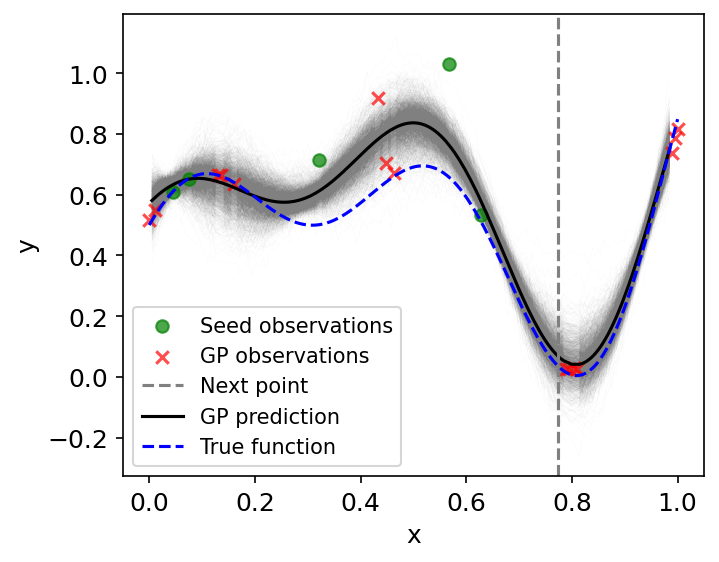


Exploration step 17


sample: 100%|██████████| 4000/4000 [00:17<00:00, 223.72it/s, 15 steps of size 2.37e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.16      0.12      0.16     -0.01      0.36    616.96      1.00
          b     -0.83      0.19     -0.83     -1.13     -0.52    604.68      1.00
          c      0.24      0.59      0.29     -0.69      1.25   1115.03      1.01
k_length[0]      2.95      3.14      2.00      0.17      6.03    965.73      1.00
    k_scale      0.87      0.98      0.56      0.03      1.92   1401.68      1.00
      noise      0.02      0.01      0.02      0.01      0.03   1093.89      1.00



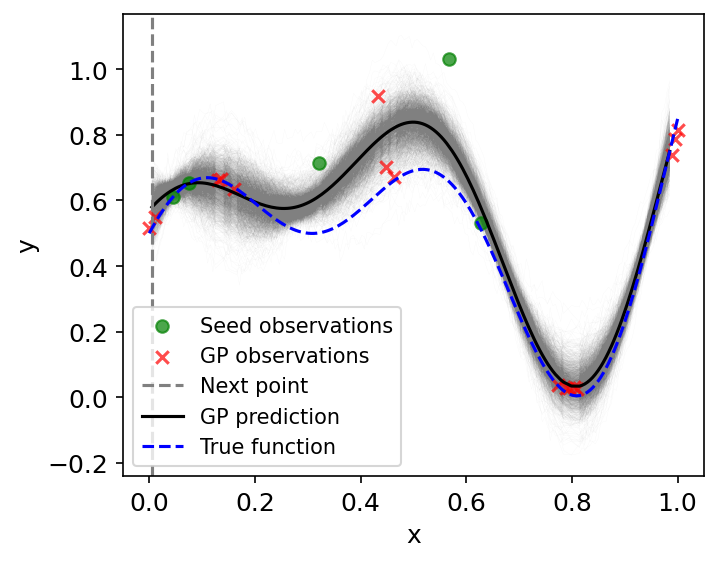


Exploration step 18


sample: 100%|██████████| 4000/4000 [00:17<00:00, 235.03it/s, 15 steps of size 2.73e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.11      0.17     -0.00      0.34   1297.26      1.00
          b     -0.85      0.17     -0.85     -1.14     -0.56   1437.67      1.00
          c      0.23      0.59      0.29     -0.82      1.12   1256.85      1.00
k_length[0]      2.70      2.47      1.96      0.16      5.47   1305.37      1.00
    k_scale      0.85      0.97      0.55      0.03      1.90   1142.03      1.00
      noise      0.02      0.01      0.02      0.01      0.03   1166.62      1.00



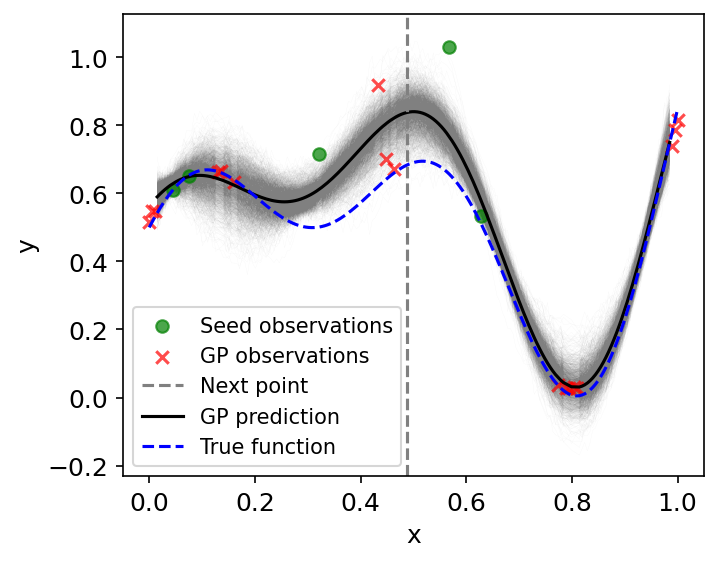


Exploration step 19


sample: 100%|██████████| 4000/4000 [00:17<00:00, 230.53it/s, 15 steps of size 2.67e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.10      0.17      0.01      0.33    961.92      1.00
          b     -0.86      0.17     -0.86     -1.12     -0.59   1013.21      1.00
          c      0.23      0.59      0.28     -0.65      1.26   1121.56      1.00
k_length[0]      2.60      2.47      1.86      0.14      5.18   1134.58      1.00
    k_scale      0.86      0.99      0.56      0.03      1.89   1127.66      1.00
      noise      0.02      0.01      0.02      0.01      0.03   1281.22      1.00



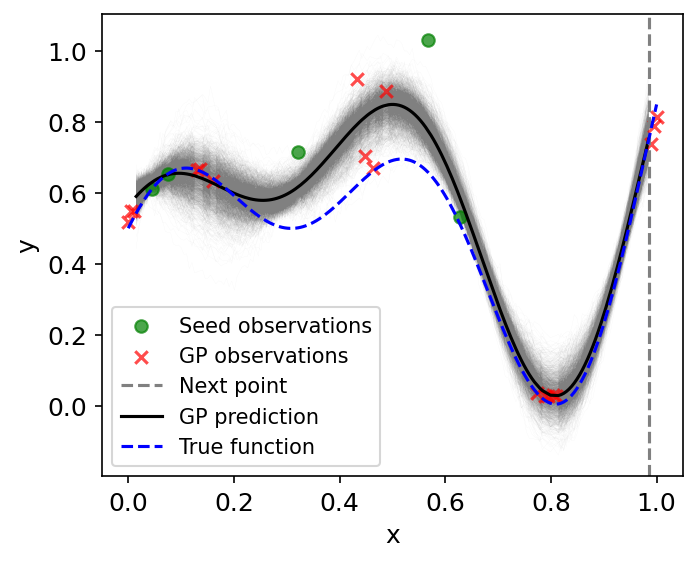


Exploration step 20


sample: 100%|██████████| 4000/4000 [00:17<00:00, 229.55it/s, 15 steps of size 2.37e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.10      0.17      0.01      0.32    750.43      1.00
          b     -0.85      0.17     -0.85     -1.10     -0.58    712.29      1.00
          c      0.24      0.60      0.28     -0.70      1.29   1139.31      1.00
k_length[0]      2.56      2.67      1.79      0.12      4.94    857.62      1.00
    k_scale      0.86      0.92      0.58      0.03      1.88   1286.44      1.00
      noise      0.02      0.01      0.01      0.01      0.03   1301.24      1.00



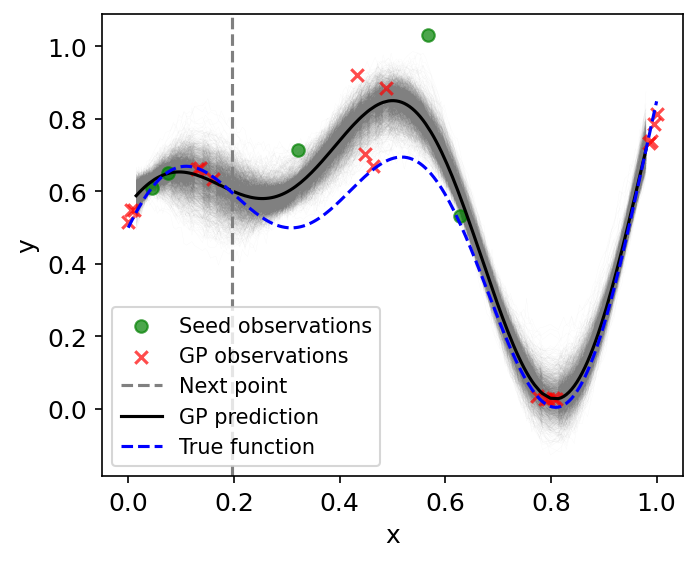


Exploration step 21


sample: 100%|██████████| 4000/4000 [00:16<00:00, 243.66it/s, 15 steps of size 2.97e-01. acc. prob=0.86]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.09      0.17      0.02      0.32   1238.50      1.00
          b     -0.85      0.15     -0.85     -1.11     -0.63   1315.01      1.00
          c      0.25      0.62      0.29     -0.75      1.30   1115.62      1.00
k_length[0]      2.53      2.42      1.78      0.30      5.16   1125.24      1.00
    k_scale      0.87      0.97      0.58      0.03      1.91   1148.25      1.00
      noise      0.01      0.01      0.01      0.01      0.02   1199.32      1.00



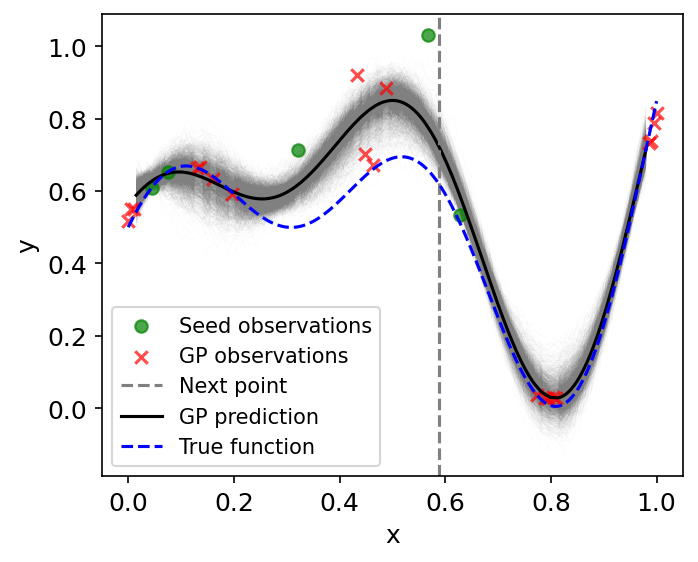


Exploration step 22


sample: 100%|██████████| 4000/4000 [00:17<00:00, 228.87it/s, 15 steps of size 2.80e-01. acc. prob=0.86]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.09      0.17      0.03      0.31    911.28      1.00
          b     -0.86      0.14     -0.85     -1.11     -0.64   1043.25      1.00
          c      0.20      0.62      0.25     -0.84      1.20   1022.81      1.00
k_length[0]      2.40      2.40      1.70      0.22      4.73    960.54      1.00
    k_scale      0.92      1.08      0.62      0.03      1.91   1086.22      1.00
      noise      0.01      0.01      0.01      0.01      0.02   1268.63      1.00



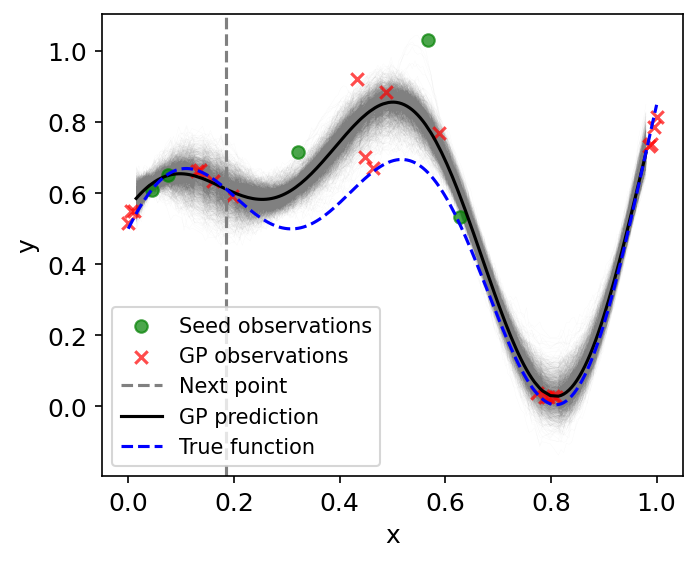


Exploration step 23


sample: 100%|██████████| 4000/4000 [00:21<00:00, 186.66it/s, 31 steps of size 1.74e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.08      0.18      0.04      0.30   1003.60      1.00
          b     -0.86      0.14     -0.86     -1.08     -0.65    872.75      1.00
          c      0.19      0.63      0.22     -0.81      1.29    840.76      1.00
k_length[0]      2.33      2.01      1.78      0.35      4.33    884.04      1.00
    k_scale      0.95      1.16      0.61      0.05      2.14   1215.52      1.00
      noise      0.01      0.01      0.01      0.01      0.02   1211.33      1.00



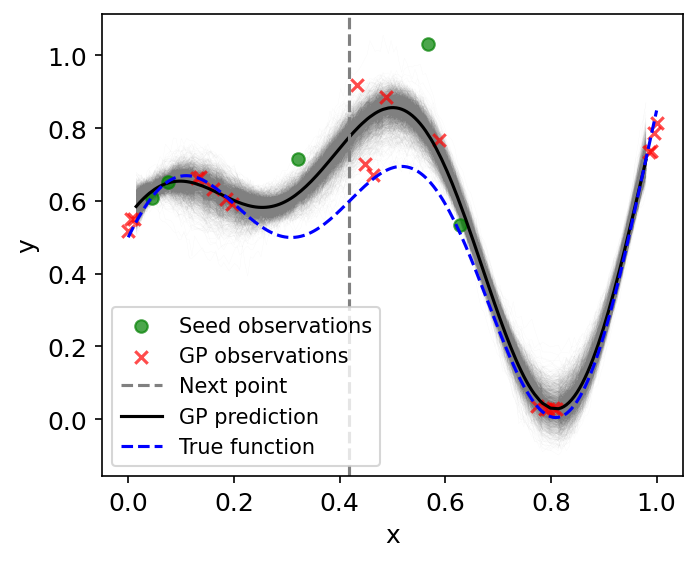


Exploration step 24


sample: 100%|██████████| 4000/4000 [00:30<00:00, 129.63it/s, 15 steps of size 2.46e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.19      0.08      0.18      0.05      0.31    898.87      1.00
          b     -0.87      0.13     -0.87     -1.09     -0.65    821.27      1.00
          c      0.20      0.60      0.22     -0.79      1.19   1235.14      1.00
k_length[0]      2.29      1.94      1.73      0.39      4.39    971.12      1.00
    k_scale      0.87      1.02      0.58      0.03      1.83   1412.74      1.00
      noise      0.01      0.00      0.01      0.01      0.02   1170.46      1.00



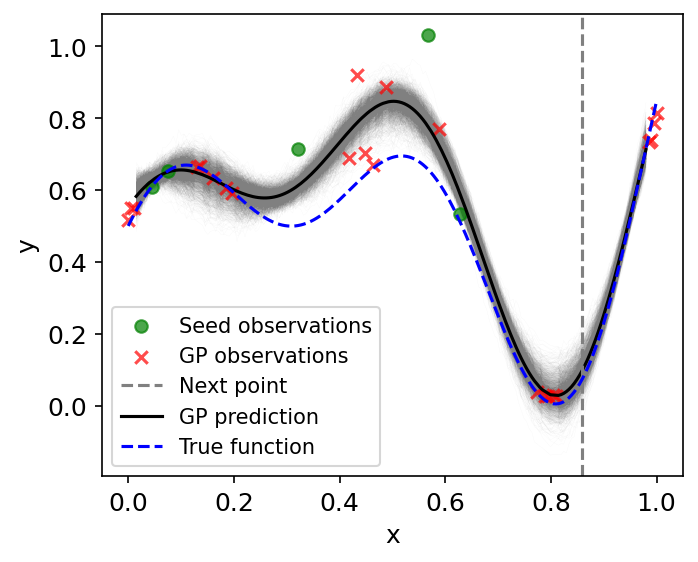


Exploration step 25


sample: 100%|██████████| 4000/4000 [00:20<00:00, 191.34it/s, 11 steps of size 2.74e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.19      0.08      0.18      0.07      0.32   1023.29      1.00
          b     -0.87      0.13     -0.87     -1.08     -0.66   1149.61      1.00
          c      0.21      0.60      0.24     -0.70      1.22   1037.95      1.00
k_length[0]      2.30      2.00      1.72      0.31      4.27   1016.44      1.00
    k_scale      0.90      0.95      0.61      0.02      1.93   1072.51      1.00
      noise      0.01      0.00      0.01      0.01      0.02   1313.56      1.00



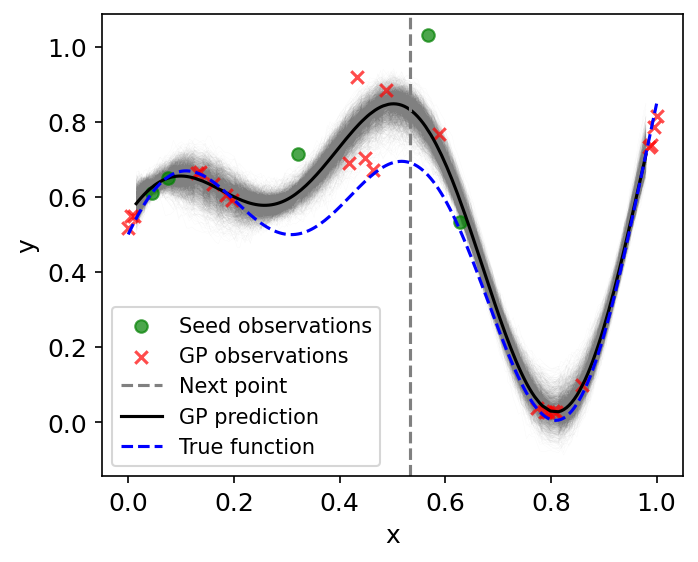


Exploration step 26


sample: 100%|██████████| 4000/4000 [00:20<00:00, 197.52it/s, 11 steps of size 2.69e-01. acc. prob=0.86]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.18      0.07      0.18      0.06      0.31   1418.90      1.00
          b     -0.86      0.12     -0.86     -1.05     -0.66   1343.57      1.00
          c      0.20      0.61      0.25     -0.84      1.16    967.50      1.00
k_length[0]      2.69      2.86      1.91      0.33      5.03    920.34      1.00
    k_scale      0.86      0.96      0.58      0.04      1.89   1166.03      1.00
      noise      0.01      0.00      0.01      0.01      0.02   1231.67      1.00



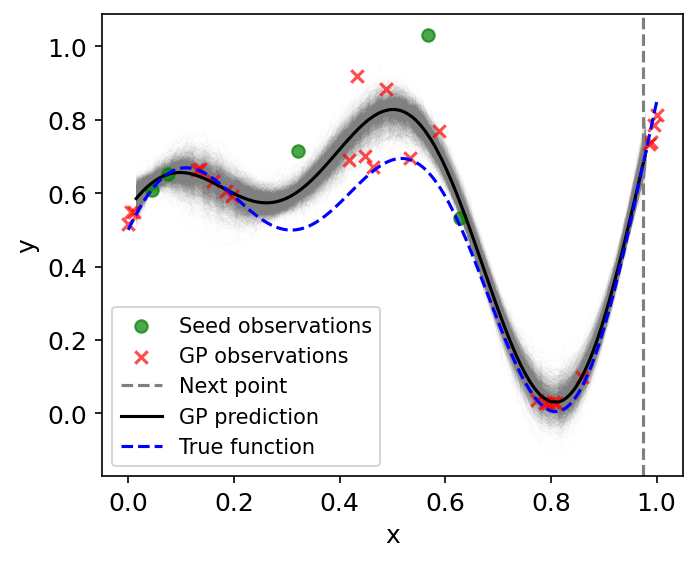


Exploration step 27


sample: 100%|██████████| 4000/4000 [00:20<00:00, 195.05it/s, 15 steps of size 2.38e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.19      0.07      0.18      0.07      0.31    963.16      1.00
          b     -0.87      0.12     -0.86     -1.06     -0.66    954.13      1.00
          c      0.22      0.62      0.25     -0.83      1.22   1051.72      1.00
k_length[0]      2.76      2.77      2.00      0.39      5.44    764.90      1.00
    k_scale      0.87      1.02      0.57      0.03      1.91   1161.17      1.00
      noise      0.01      0.00      0.01      0.01      0.02   1163.27      1.00



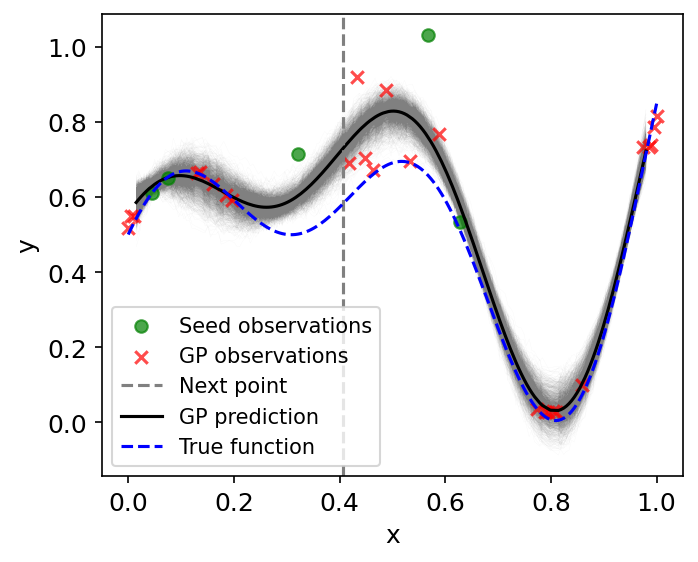


Exploration step 28


sample: 100%|██████████| 4000/4000 [01:07<00:00, 59.65it/s, 15 steps of size 2.55e-01. acc. prob=0.92] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.19      0.07      0.19      0.08      0.31    880.79      1.00
          b     -0.87      0.12     -0.87     -1.05     -0.66    934.36      1.00
          c      0.21      0.59      0.25     -0.79      1.17   1114.71      1.00
k_length[0]      2.66      2.40      1.98      0.41      5.13   1145.13      1.00
    k_scale      0.88      1.00      0.58      0.02      1.95   1151.81      1.00
      noise      0.01      0.00      0.01      0.01      0.02   1287.78      1.00



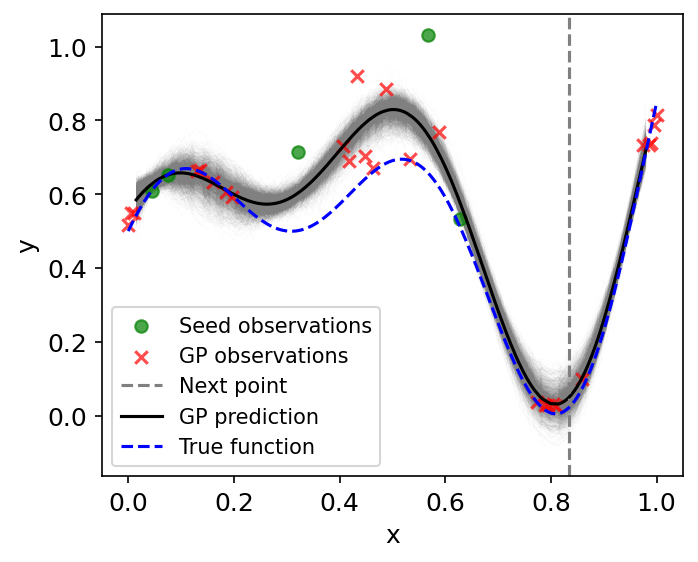


Exploration step 29


sample: 100%|██████████| 4000/4000 [00:44<00:00, 90.30it/s, 15 steps of size 2.51e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.19      0.07      0.19      0.08      0.30    970.75      1.00
          b     -0.87      0.11     -0.87     -1.05     -0.69   1035.28      1.00
          c      0.22      0.61      0.27     -0.81      1.16   1088.53      1.00
k_length[0]      2.59      2.23      1.99      0.43      4.98    871.74      1.00
    k_scale      0.85      0.92      0.57      0.03      1.87   1369.23      1.00
      noise      0.01      0.00      0.01      0.01      0.02   1284.53      1.00



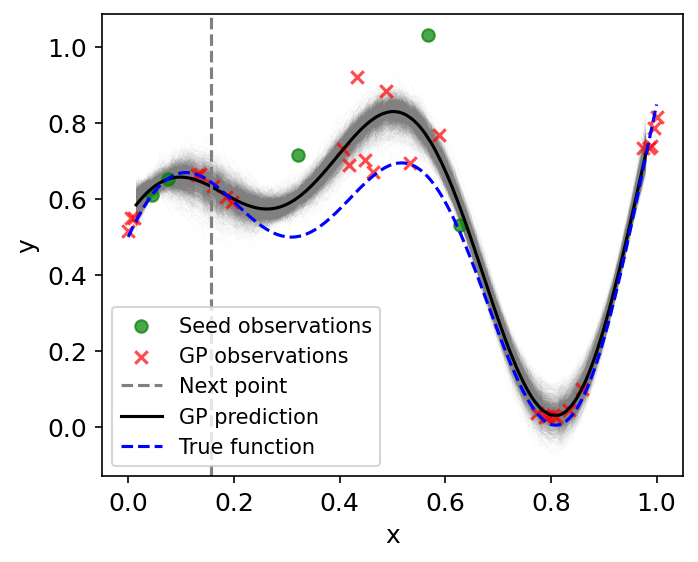


Exploration step 30


sample: 100%|██████████| 4000/4000 [00:46<00:00, 85.24it/s, 15 steps of size 2.19e-01. acc. prob=0.92] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.19      0.07      0.19      0.08      0.29    955.06      1.00
          b     -0.87      0.12     -0.87     -1.06     -0.70    829.06      1.00
          c      0.19      0.64      0.24     -0.98      1.11    928.75      1.00
k_length[0]      2.51      2.23      1.93      0.23      4.55    877.88      1.00
    k_scale      0.88      1.01      0.58      0.04      1.89   1360.20      1.00
      noise      0.01      0.00      0.01      0.01      0.01   1508.15      1.00



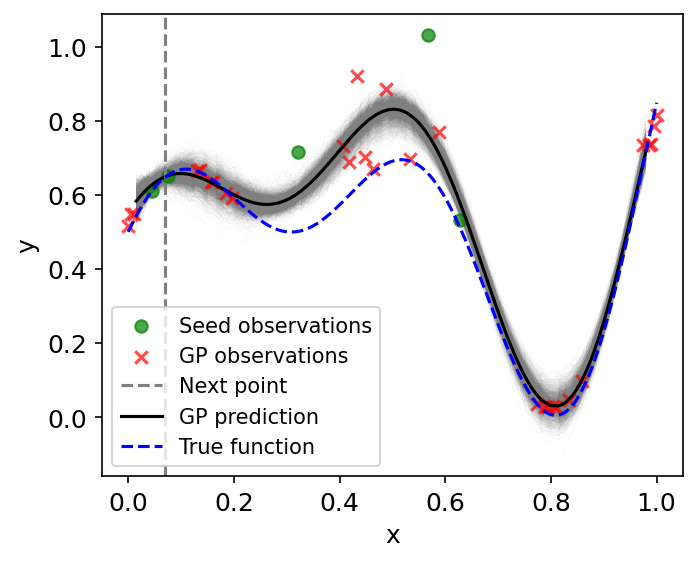


Exploration step 31


sample: 100%|██████████| 4000/4000 [00:43<00:00, 90.92it/s, 15 steps of size 2.32e-01. acc. prob=0.92] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.19      0.07      0.19      0.09      0.29    947.51      1.00
          b     -0.87      0.11     -0.87     -1.04     -0.69    914.07      1.00
          c      0.19      0.62      0.23     -0.82      1.18   1090.16      1.00
k_length[0]      2.57      2.52      1.92      0.40      4.76    823.59      1.00
    k_scale      0.87      0.97      0.58      0.03      1.95   1419.70      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1271.77      1.00



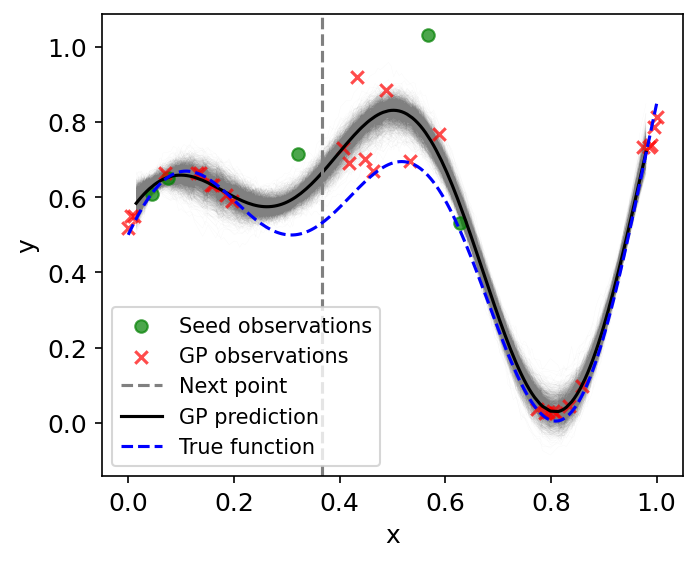


Exploration step 32


sample: 100%|██████████| 4000/4000 [00:42<00:00, 93.95it/s, 15 steps of size 2.55e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.06      0.20      0.10      0.30   1220.45      1.00
          b     -0.89      0.11     -0.89     -1.06     -0.72   1313.35      1.00
          c      0.19      0.59      0.24     -0.73      1.19   1107.25      1.00
k_length[0]      2.73      2.74      2.03      0.55      5.11    890.35      1.00
    k_scale      0.87      0.96      0.57      0.04      1.84   1108.93      1.00
      noise      0.01      0.00      0.01      0.01      0.01   1511.07      1.00



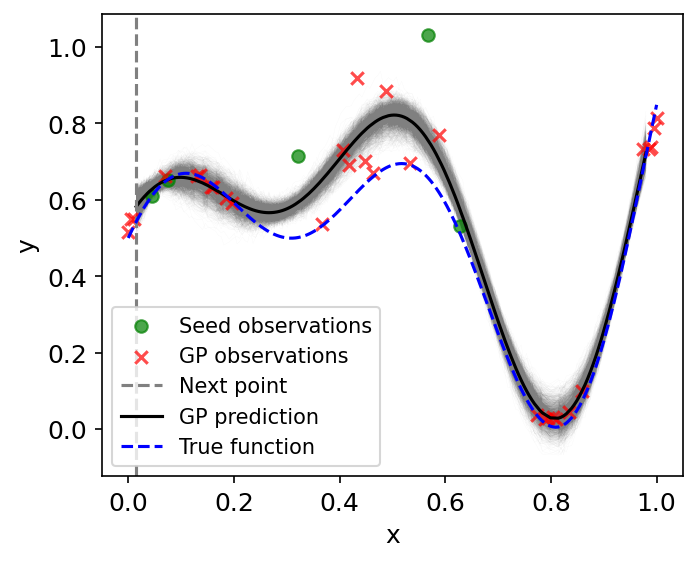


Exploration step 33


sample: 100%|██████████| 4000/4000 [00:46<00:00, 86.21it/s, 15 steps of size 2.85e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.06      0.20      0.11      0.31   1226.88      1.00
          b     -0.89      0.10     -0.89     -1.05     -0.71   1316.97      1.00
          c      0.22      0.59      0.26     -0.70      1.21   1365.49      1.00
k_length[0]      2.53      2.28      1.92      0.36      4.46   1086.53      1.00
    k_scale      0.88      0.93      0.59      0.02      1.85   1268.67      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1434.80      1.00



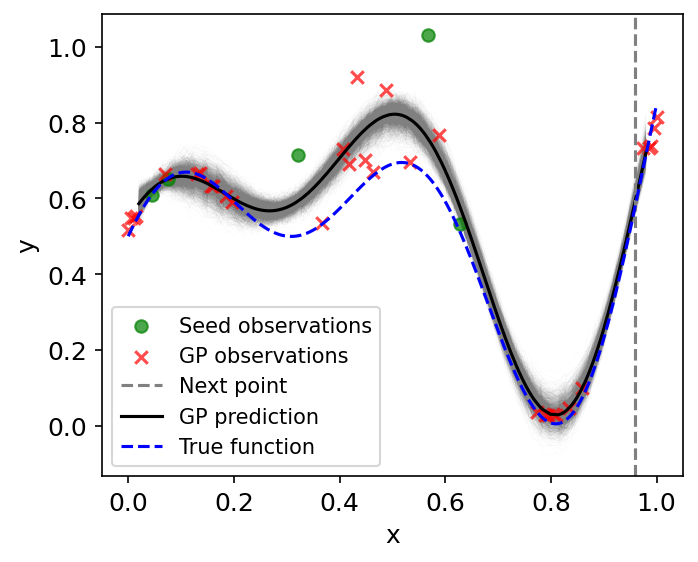


Exploration step 34


sample: 100%|██████████| 4000/4000 [00:46<00:00, 85.81it/s, 15 steps of size 2.21e-01. acc. prob=0.93] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.07      0.20      0.10      0.30    285.25      1.00
          b     -0.89      0.13     -0.89     -1.06     -0.71    255.78      1.00
          c      0.19      0.61      0.23     -0.85      1.11   1035.57      1.00
k_length[0]      2.49      2.07      1.96      0.26      4.52    871.01      1.00
    k_scale      0.88      0.99      0.56      0.02      1.92   1354.54      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1675.39      1.00



/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


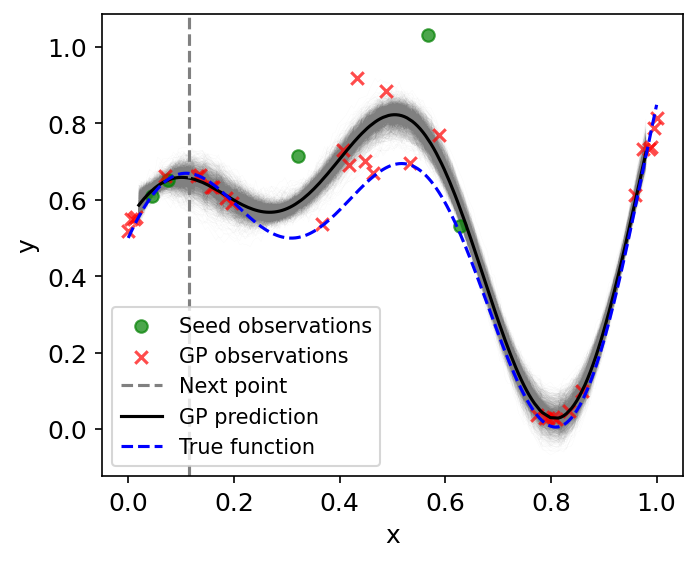


Exploration step 35


sample: 100%|██████████| 4000/4000 [01:06<00:00, 60.29it/s, 15 steps of size 2.46e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.06      0.21      0.11      0.31    962.19      1.00
          b     -0.90      0.10     -0.90     -1.05     -0.73   1034.45      1.00
          c      0.20      0.58      0.25     -0.74      1.17   1347.97      1.00
k_length[0]      2.40      1.96      1.86      0.44      4.43   1138.84      1.00
    k_scale      0.84      0.91      0.56      0.03      1.77   1082.51      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1398.64      1.00



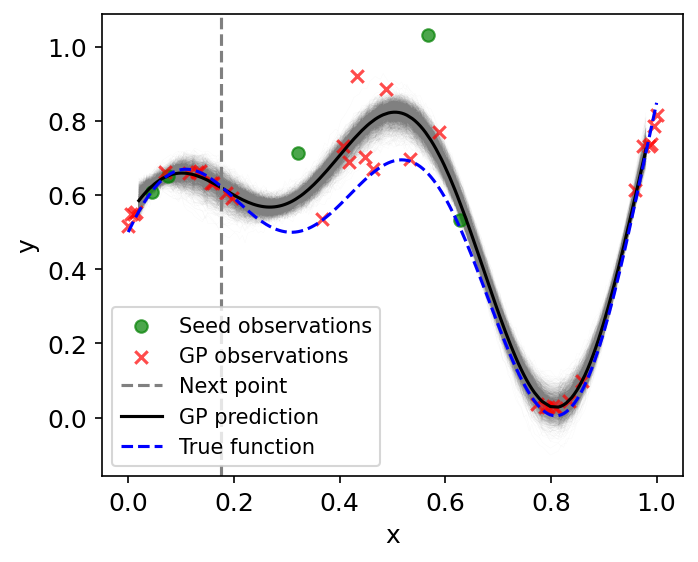


Exploration step 36


sample: 100%|██████████| 4000/4000 [00:47<00:00, 83.58it/s, 31 steps of size 2.08e-01. acc. prob=0.95] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.06      0.20      0.12      0.30    957.15      1.00
          b     -0.90      0.10     -0.89     -1.05     -0.74    907.46      1.00
          c      0.20      0.62      0.22     -0.77      1.27    954.07      1.00
k_length[0]      2.44      2.06      1.93      0.36      4.30    971.77      1.00
    k_scale      0.91      1.20      0.57      0.02      2.01   1258.31      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1437.54      1.00



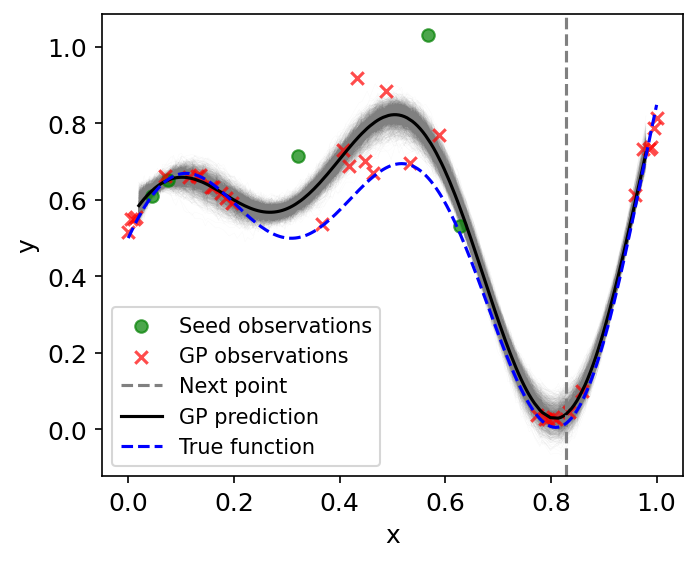


Exploration step 37


sample: 100%|██████████| 4000/4000 [00:50<00:00, 78.88it/s, 15 steps of size 2.20e-01. acc. prob=0.93] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.06      0.21      0.12      0.30    747.60      1.00
          b     -0.90      0.10     -0.90     -1.05     -0.75    697.98      1.00
          c      0.18      0.62      0.22     -0.87      1.13   1120.83      1.00
k_length[0]      2.37      1.92      1.89      0.40      4.12    989.86      1.00
    k_scale      0.87      0.99      0.56      0.03      1.86   1263.17      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1554.26      1.00



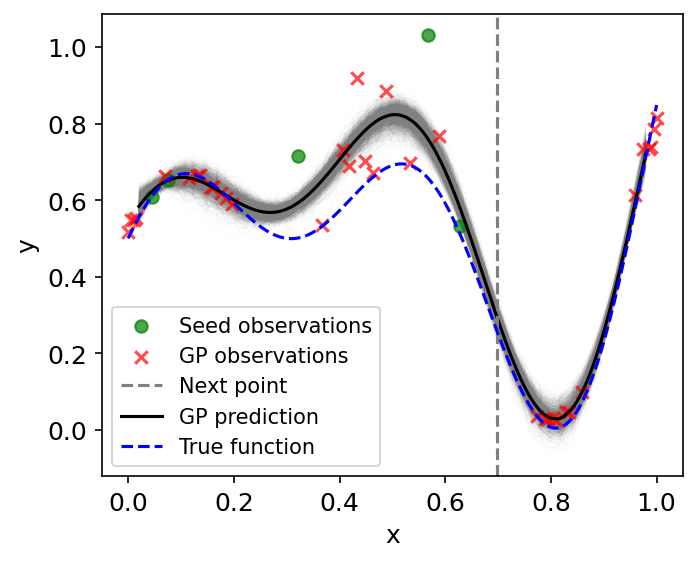


Exploration step 38


sample: 100%|██████████| 4000/4000 [00:44<00:00, 90.35it/s, 15 steps of size 2.52e-01. acc. prob=0.91] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.06      0.20      0.12      0.30    955.06      1.00
          b     -0.89      0.10     -0.90     -1.04     -0.74    624.83      1.00
          c      0.19      0.58      0.24     -0.80      1.10   1194.51      1.00
k_length[0]      2.59      2.98      1.96      0.45      4.44    923.57      1.00
    k_scale      0.87      1.02      0.56      0.05      1.88   1386.22      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1587.80      1.00



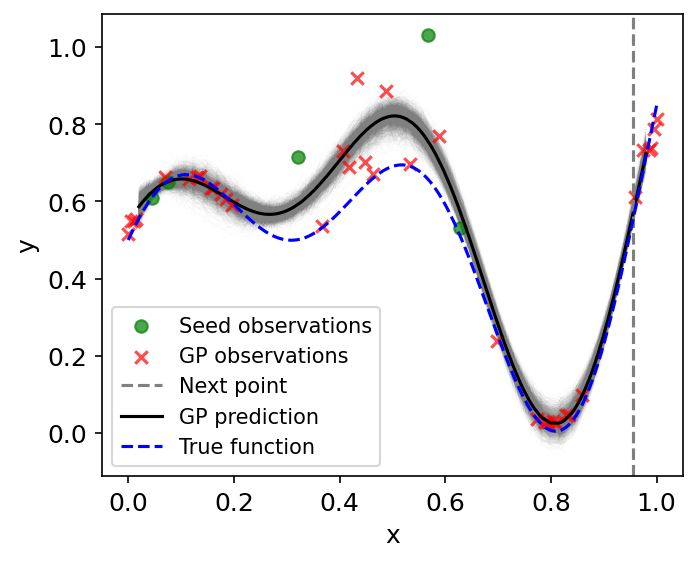


Exploration step 39


sample: 100%|██████████| 4000/4000 [00:51<00:00, 77.80it/s, 15 steps of size 2.42e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.05      0.20      0.12      0.29    878.57      1.00
          b     -0.90      0.09     -0.90     -1.05     -0.77    692.30      1.00
          c      0.16      0.60      0.20     -0.84      1.09    930.24      1.00
k_length[0]      2.53      2.10      1.99      0.43      4.41    832.63      1.00
    k_scale      0.86      0.99      0.57      0.03      1.77   1408.70      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1460.89      1.00



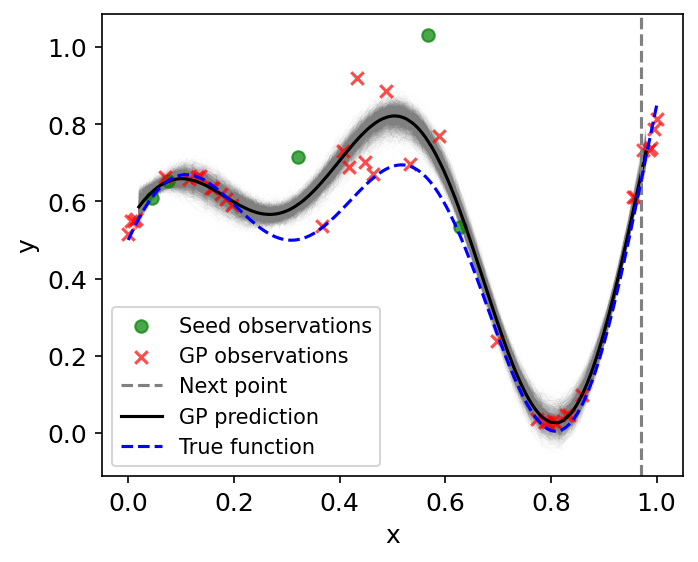


Exploration step 40


sample: 100%|██████████| 4000/4000 [00:50<00:00, 79.63it/s, 15 steps of size 2.00e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.05      0.20      0.12      0.29    984.11      1.00
          b     -0.90      0.09     -0.90     -1.05     -0.76    934.00      1.00
          c      0.18      0.63      0.22     -0.85      1.30    942.38      1.00
k_length[0]      2.66      2.21      2.10      0.38      4.67    907.21      1.00
    k_scale      0.90      1.10      0.58      0.04      2.01   1009.64      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1212.00      1.00



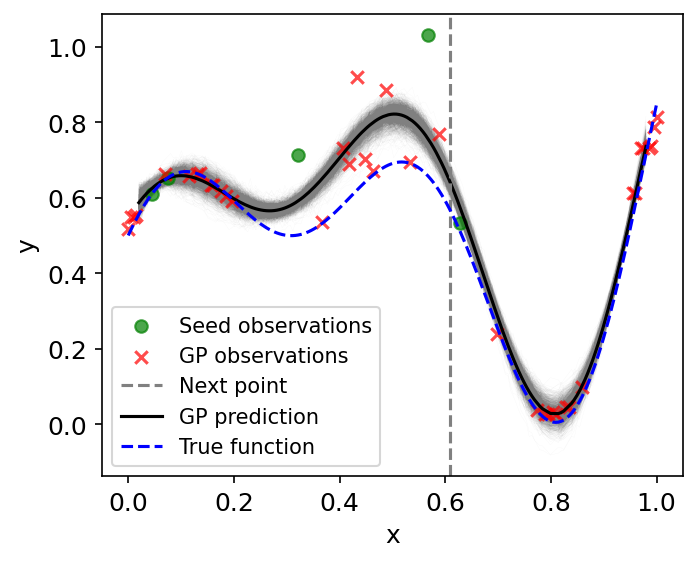


Exploration step 41


sample: 100%|██████████| 4000/4000 [00:59<00:00, 66.90it/s, 15 steps of size 2.72e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.05      0.20      0.12      0.28   1226.10      1.00
          b     -0.88      0.08     -0.88     -1.02     -0.76   1391.20      1.00
          c      0.22      0.61      0.26     -0.70      1.32   1408.46      1.00
k_length[0]      2.99      2.60      2.29      0.56      5.54   1017.68      1.00
    k_scale      0.84      0.99      0.54      0.03      1.76   1300.97      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1636.17      1.00



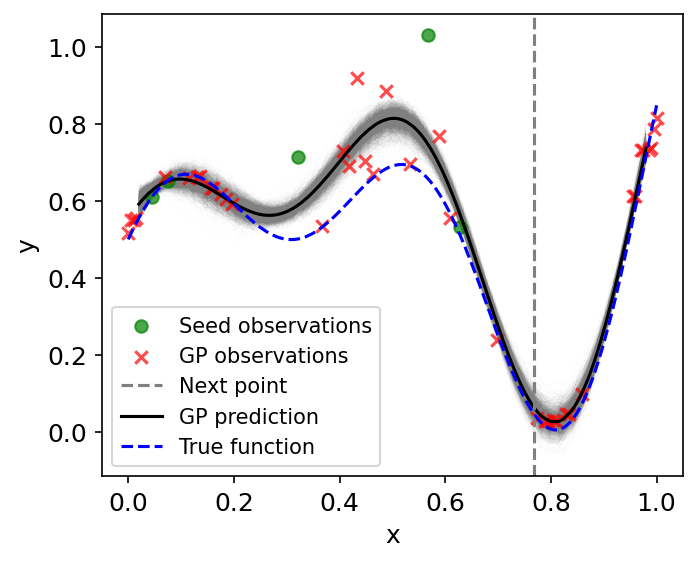


Exploration step 42


sample: 100%|██████████| 4000/4000 [00:50<00:00, 79.85it/s, 15 steps of size 2.70e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.05      0.20      0.13      0.28   1214.79      1.00
          b     -0.89      0.08     -0.89     -1.02     -0.76   1338.17      1.00
          c      0.21      0.59      0.25     -0.76      1.17   1311.97      1.00
k_length[0]      2.91      2.29      2.28      0.54      5.40   1136.98      1.00
    k_scale      0.86      0.95      0.55      0.05      1.99   1193.68      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1637.05      1.00



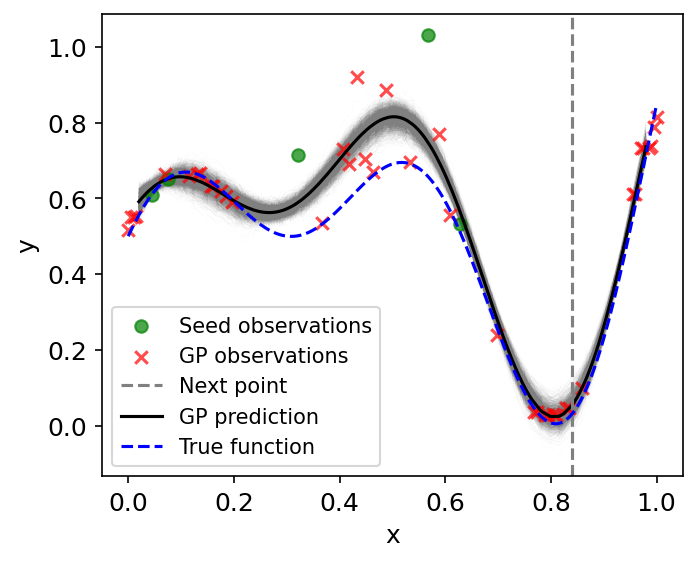


Exploration step 43


sample: 100%|██████████| 4000/4000 [00:52<00:00, 75.96it/s, 15 steps of size 2.38e-01. acc. prob=0.93] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.05      0.20      0.13      0.28   1002.29      1.00
          b     -0.89      0.08     -0.89     -1.03     -0.77   1024.66      1.00
          c      0.19      0.63      0.22     -0.85      1.18   1190.45      1.00
k_length[0]      3.00      3.00      2.24      0.51      5.42    803.91      1.00
    k_scale      0.86      0.96      0.59      0.03      1.83   1507.47      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1700.47      1.00



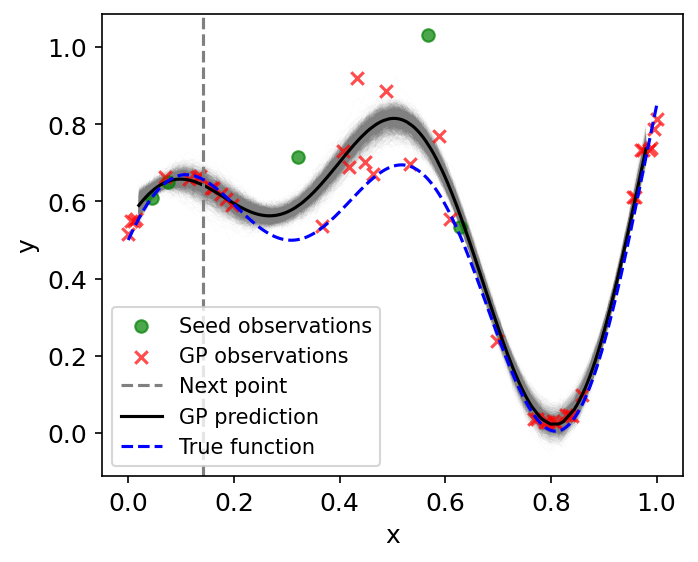


Exploration step 44


sample: 100%|██████████| 4000/4000 [00:44<00:00, 89.48it/s, 15 steps of size 2.81e-01. acc. prob=0.89] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.05      0.20      0.12      0.27   1262.54      1.00
          b     -0.89      0.08     -0.89     -1.01     -0.76   1160.77      1.00
          c      0.21      0.57      0.25     -0.71      1.14   1304.52      1.00
k_length[0]      2.79      2.18      2.18      0.58      5.22   1195.88      1.00
    k_scale      0.85      0.92      0.57      0.04      1.85   1169.28      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1408.27      1.00



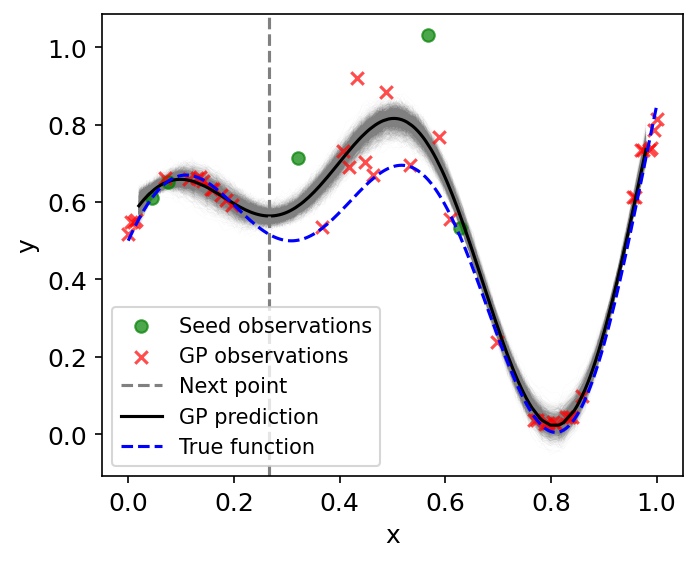


Exploration step 45


sample: 100%|██████████| 4000/4000 [00:50<00:00, 79.08it/s, 15 steps of size 2.54e-01. acc. prob=0.93] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.05      0.20      0.12      0.27    773.00      1.00
          b     -0.90      0.08     -0.90     -1.02     -0.77    882.49      1.00
          c      0.18      0.59      0.25     -0.76      1.12   1185.55      1.00
k_length[0]      2.93      2.91      2.26      0.46      5.07    809.96      1.00
    k_scale      0.87      1.03      0.57      0.02      1.88   1405.52      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1499.98      1.00



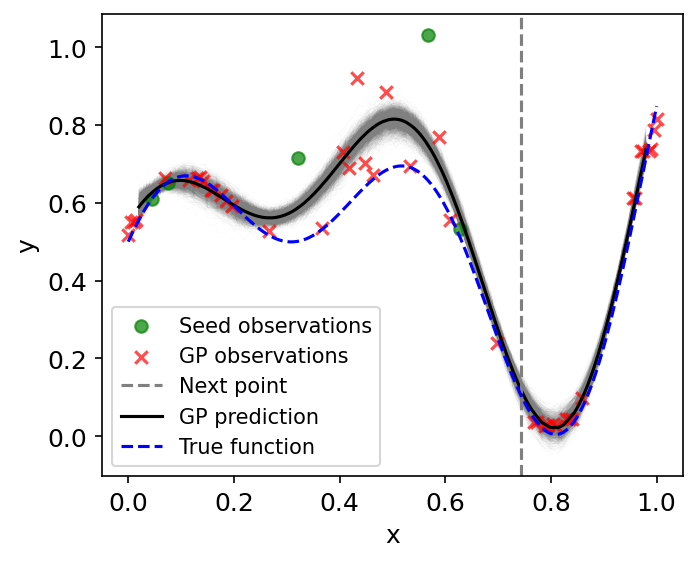


Exploration step 46


sample: 100%|██████████| 4000/4000 [00:48<00:00, 82.89it/s, 15 steps of size 2.73e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.05      0.20      0.12      0.27   1053.85      1.00
          b     -0.90      0.08     -0.90     -1.02     -0.77   1204.31      1.00
          c      0.20      0.58      0.24     -0.74      1.14   1723.68      1.00
k_length[0]      2.83      2.19      2.27      0.55      5.16   1174.05      1.00
    k_scale      0.81      0.86      0.54      0.03      1.78   1117.28      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1609.19      1.00



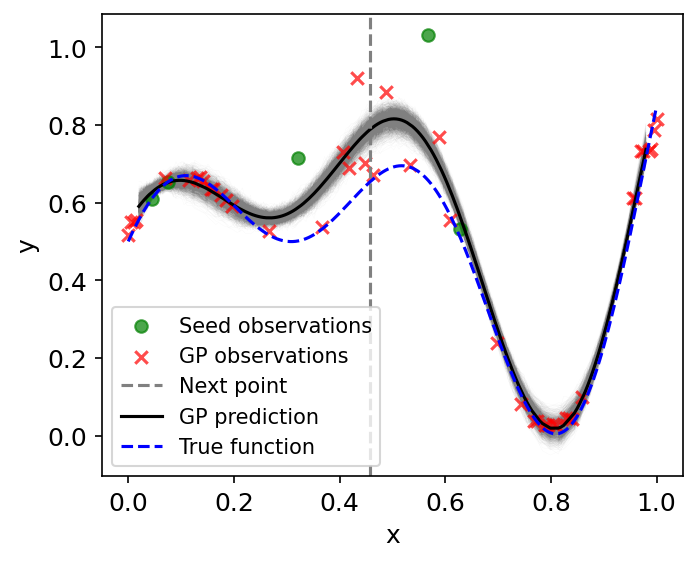


Exploration step 47


sample: 100%|██████████| 4000/4000 [00:50<00:00, 79.03it/s, 15 steps of size 2.67e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.05      0.20      0.14      0.28    869.12      1.00
          b     -0.90      0.07     -0.90     -1.02     -0.78   1247.93      1.00
          c      0.21      0.59      0.24     -0.80      1.13   1204.47      1.00
k_length[0]      3.09      2.79      2.37      0.47      5.38    991.88      1.00
    k_scale      0.82      0.96      0.53      0.02      1.81   1134.87      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1160.29      1.00



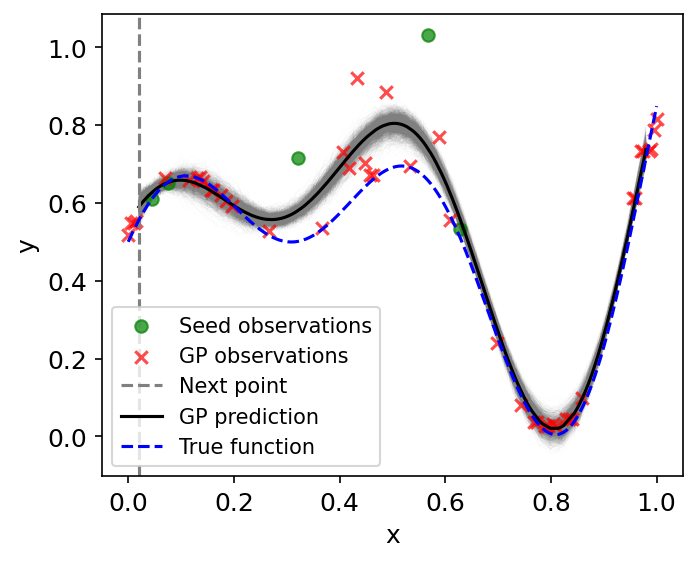


Exploration step 48


sample: 100%|██████████| 4000/4000 [00:51<00:00, 77.95it/s, 15 steps of size 2.28e-01. acc. prob=0.92] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.05      0.21      0.14      0.29    817.57      1.00
          b     -0.90      0.07     -0.90     -1.02     -0.78   1393.58      1.00
          c      0.19      0.63      0.23     -0.83      1.20   1054.67      1.00
k_length[0]      3.15      2.65      2.38      0.49      5.97    941.83      1.00
    k_scale      0.85      0.94      0.56      0.02      1.86   1071.49      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1531.05      1.00



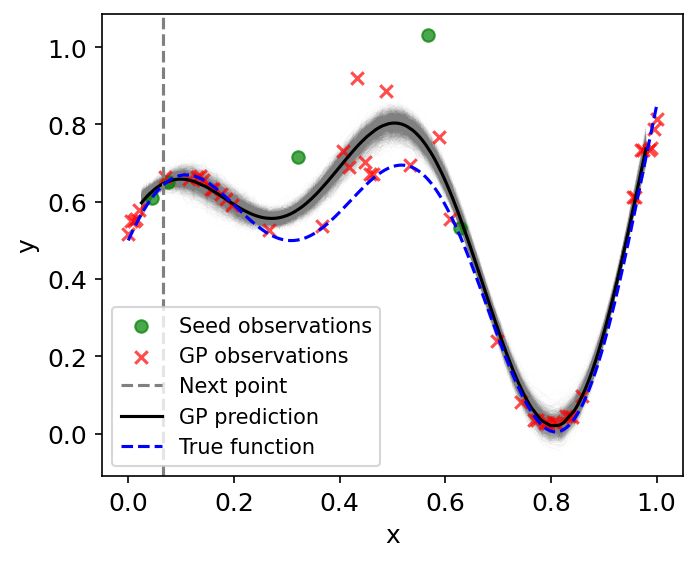


Exploration step 49


sample: 100%|██████████| 4000/4000 [00:52<00:00, 76.21it/s, 15 steps of size 2.62e-01. acc. prob=0.91] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.04      0.21      0.15      0.29    998.84      1.00
          b     -0.90      0.07     -0.90     -1.02     -0.78   1251.58      1.00
          c      0.21      0.59      0.27     -0.77      1.09   1128.91      1.00
k_length[0]      3.04      2.43      2.37      0.54      5.66   1105.08      1.00
    k_scale      0.81      0.89      0.54      0.03      1.76   1127.21      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1894.32      1.00



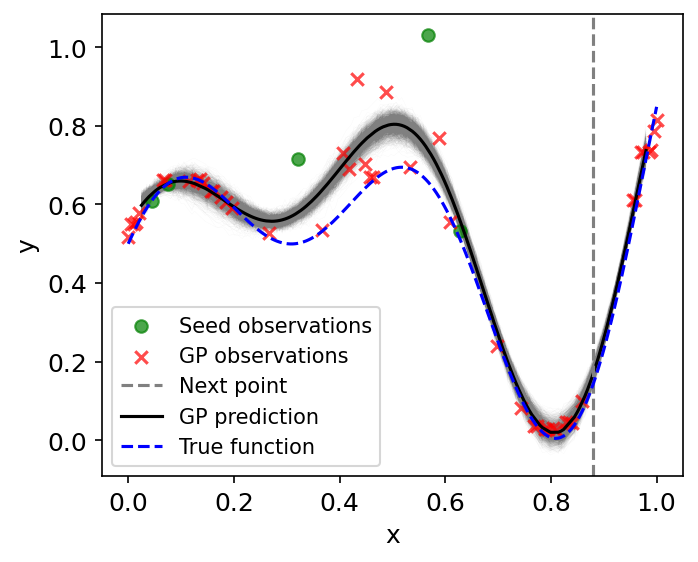


Exploration step 50


sample: 100%|██████████| 4000/4000 [00:49<00:00, 81.50it/s, 15 steps of size 2.58e-01. acc. prob=0.92] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.04      0.21      0.14      0.28   1016.74      1.00
          b     -0.90      0.07     -0.90     -1.02     -0.79   1098.05      1.00
          c      0.19      0.59      0.23     -0.78      1.14   1291.62      1.00
k_length[0]      3.06      2.39      2.39      0.49      5.67    974.20      1.00
    k_scale      0.84      0.96      0.55      0.03      1.81   1336.25      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1916.08      1.00



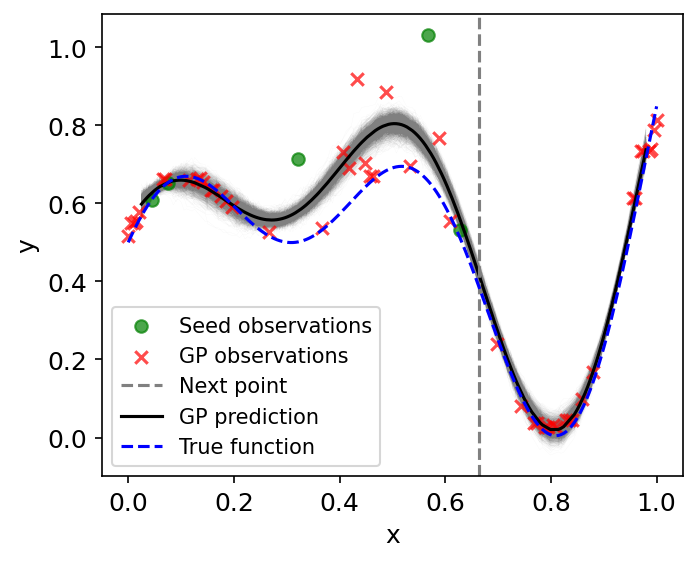

In [ ]:
rng_key, rng_key_predict = gpax.utils.get_keys(1)
exploration_steps = 50

for i in range(exploration_steps):
    print("\nExploration step {}".format(i+1))
    # Execute GP
    gpbo, obj, posterior_mean, f_samples = run_GP(X_train, y_train, X_test,
                                            fn = custom_structure, fn_priors = custom_structure_priors)
    # Next point
    # get the next point to measure
    next_point_idx = obj.argmax()
    next_point = X_test[next_point_idx]
    y_next = y_test_spec[next_point_idx]

    # Plot results-------------------------
    fig, ax = plt.subplots(1, 1, figsize=(5, 4))
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.scatter(X_seed, y_seed, marker='o', c='g', zorder=1, label="Seed observations", alpha=0.7)
    ax.scatter(X_train[init_points:], y_train[init_points:], marker='x', c='r', zorder=1, label="GP observations", alpha=0.7)
    ax.axvline(next_point, linestyle = "--", c = "Gray", label="Next point")
    for y1 in f_samples:
      ax.plot(X_test, y1.mean(0), lw=.1, zorder=0, c='Gray', alpha=.1)
    l, = ax.plot(X_test, f_samples[0].mean(0), lw=1, c='Gray', alpha=1)
    ax.plot(X_test, posterior_mean, lw=1.5, zorder=1, c='black', label='GP prediction')
    ax.plot(X, y_amp, c='blue', linestyle='--', label='True function')
    ax.legend();
    l.set_alpha(0)
    plt.show()
    #------------------------------------------#

    # Get mean function parameters
    fn_params = gpbo.get_samples()
    fn_a, fn_b, fn_c = fn_params['a'], fn_params['b'], fn_params['c']

    # Save results for post analysis
    np.savez("singleGP_step{}.npz".format(i), next_point_idx = next_point_idx, obj = obj,
             posterior_mean = posterior_mean, f_samples = f_samples, X_train = X_train, X_test = X_test,
             y_train = y_train, indices_train = indices_train, indices_test = indices_test, fn_a = fn_a, fn_b = fn_b, fn_c = fn_c)

    # Update Train and Test datasets
    (X_train, X_test, y_train, y_train_spec, y_test_spec,
     indices_train, indices_test) = update_data(next_point_idx, X_train, X_test, y_train,
                                                y_train_spec, y_test_spec, indices_train, indices_test)

# Perform Dual GP exploration

### The 2nd GP function

In [ ]:
def second_GP(xtrain, ysecond, Xall):
  rng_key, rng_key_predict = gpax.utils.get_keys(2)
  # Obtain/update GP posterior
  gp_model = gpax.ExactGP(1, kernel='Matern')
  gp_model.fit(rng_key, xtrain, ysecond)
  # Get GP prediction
  posterior_mean, _ = gp_model.predict(rng_key_predict, Xall)
  return posterior_mean

### Intervention function for using the 2nd GP result to adjust the acquisition of the main GPBO

In [ ]:
def interven (filter_score, acq, X_train, y_train, y_train_spec,
              indices_train, indices_test, interven_percent=0.3):
  # Determine space, where the noise is above interven_percent level, to remove
  idx_for_filterout = np.where(filter_score < np.quantile(filter_score, interven_percent))[0]
  # Check if points in train set are from this space
  try:
    train_filterout_idx = np.where(np.isin(indices_train, idx_for_filterout))[0]
  except:
    train_filterout_idx = None
  # Remove points from train set
  if train_filterout_idx is not None:
    X_train_update = np.delete(X_train, train_filterout_idx, 0)
    y_train_update = np.delete(y_train, train_filterout_idx, 0)
    y_train_spec_update = np.delete(y_train_spec, train_filterout_idx, 0)
    indices_train_update = np.delete(indices_train, train_filterout_idx, 0)

  # Adjust acquisiton
  acq_idx_filterout = np.where(np.isin(indices_test, idx_for_filterout))[0]
  # 1st adjusting method
  adjust_acq_1 = acq.at[acq_idx_filterout].set(obj.min()) # set acq at removal space to 0
  # 2nd adjusting method
  score_testset = filter_score[indices_test]
  adjust_acq_2 = (acq*score_testset).at[acq_idx_filterout].set(obj.min()) # tune acq with noise, then set tuned acq at removal space to 0

  return adjust_acq_1, adjust_acq_2, X_train_update, y_train_update, y_train_spec_update, indices_train_update

Functions for initialize and update 2nd GP training data

In [ ]:
import time
# initialize filter training data
def initialize_filter_data(X_train, y_train_spec, indices_train):
  X_train_filter = X_train
  indices_train_filter = indices_train
  y_train_filter = []
  for ifd in range (len(y_train_spec)):
    plt.figure(figsize =(3,3))
    plt.plot(x_spec, y_train_spec[ifd])
    plt.show()
    time.sleep(1)
    score = float(input("Please input a quality score 1 to 10 \nfor this raw spectrum, 1 means bad, 10 means good: \n"))
    y_train_filter.append(score)
  return X_train_filter, np.asarray(y_train_filter), indices_train_filter

def update_filter_data(intervation_interval, step_num):
  step_record = np.load("DualGP_step{}.npz".format(step_num))
  X_train, indices_train = step_record['X_train'], step_record['indices_train']
  y_train_spec = step_record['y_train_spec']
  X_train_filter, y_train_filter = step_record['X_train_filter'], step_record['y_train_filter']
  indices_train_filter = step_record['indices_train_filter']
  for ufd in range (intervation_interval):
    plt.figure()
    plt.plot(x_spec, y_train_spec[-intervation_interval + ufd])
    plt.show()
    time.sleep(1)
    score = float(input("Please input a quality score 1 to 10 \nfor this raw spectrum, 1 means bad, 10 means good: \n"))
    X_train_filter = jnp.append(X_train_filter, X_train[ufd-intervation_interval][None],0)
    y_train_filter = jnp.append(y_train_filter, score)
    indices_train_filter = jnp.append(indices_train_filter, indices_train[ufd-intervation_interval])
  return X_train_filter, y_train_filter, indices_train_filter

### Initilize train data

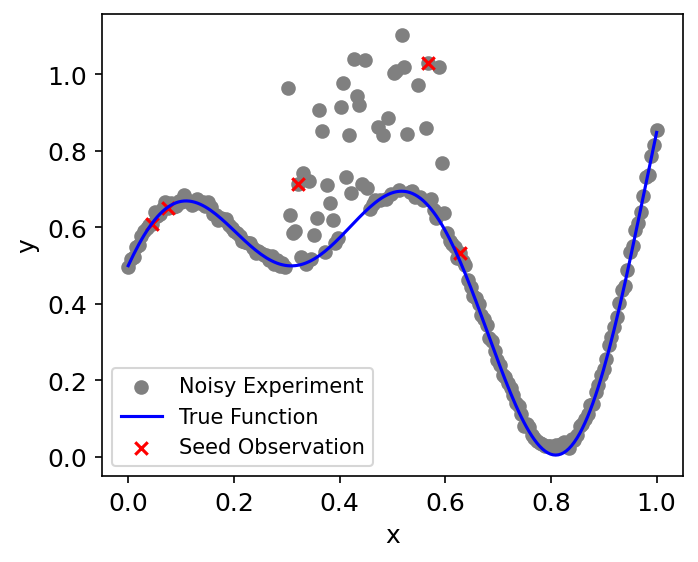

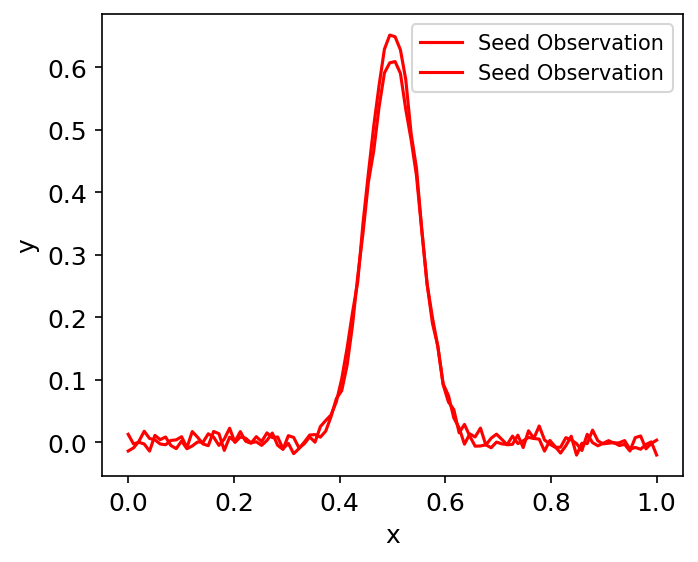

In [ ]:
# Select random initial points
init_points = 5 # number of initial points

# Full dataset
X = jnp.asarray(input_x)
X = norm_(X)
Y_spec = syn_spec

# initialize training data
(X_train, y_train_spec, X_test, y_test_spec,
 indices_train, indices_test) = init_training_data_exp(X, Y_spec, num_seed_points=init_points, rng_seed=10)

y_train = scalarizer_function(y_train_spec)
# Plot initial trian dataset
plt.figure(figsize = (5, 4))
plt.scatter(X, peak_heights, label = "Noisy Experiment", color = "Gray")
plt.plot(X, y_amp, label = "True Function", color = "blue")
plt.scatter(X_train, y_train, label = "Seed Observation", color = 'red', marker = 'x')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()

plt.figure(figsize = (5, 4))
plt.plot(x_spec, y_train_spec[0], label = "Seed Observation", color = 'red')
plt.plot(x_spec, y_train_spec[1], label = "Seed Observation", color = 'red')
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.show()

Initialize 2nd GP training data

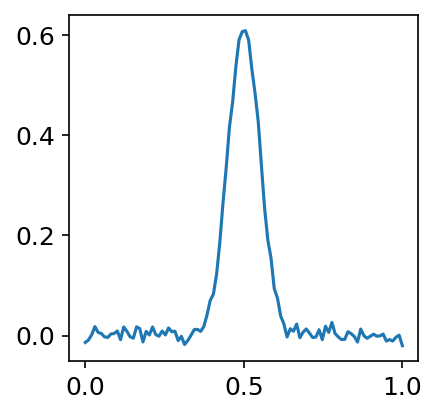

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


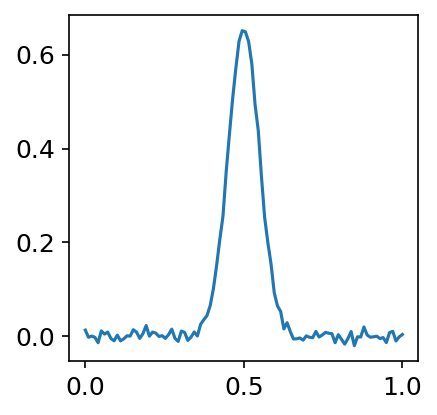

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


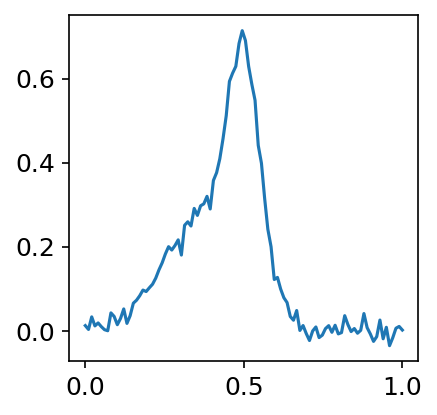

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
5


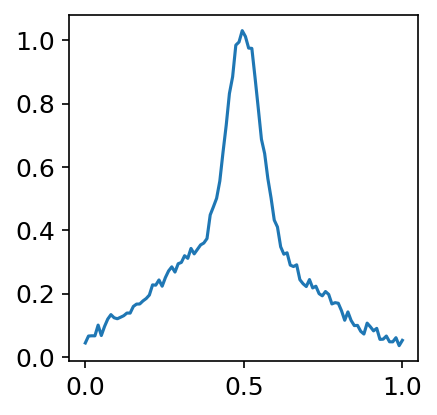

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
5


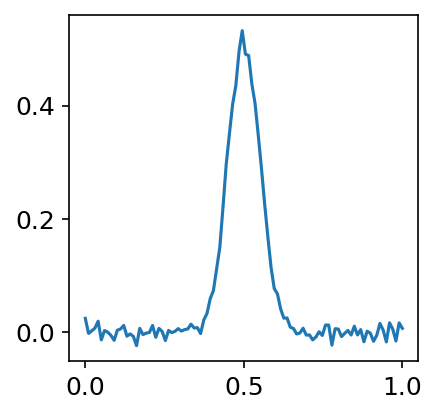

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


In [ ]:
(X_train_filter, y_train_filter,
 indices_train_filter) = initialize_filter_data(X_train, y_train_spec, indices_train)

### Start Dual GP exploration


Exploration step 1


sample: 100%|██████████| 4000/4000 [00:11<00:00, 354.43it/s, 3 steps of size 8.47e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.93      2.95      1.15      0.06      4.02   1366.68      1.00
    k_scale      1.06      1.11      0.74      0.06      2.24   1425.91      1.00
      noise      0.64      0.50      0.49      0.08      1.23   1789.74      1.00



sample: 100%|██████████| 4000/4000 [00:13<00:00, 302.11it/s, 7 steps of size 4.92e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.17      0.60     -0.19     -1.14      0.81   1971.09      1.00
          b     -0.20      0.92     -0.23     -1.61      1.32   2184.43      1.00
          c      0.43      0.68      0.44     -0.78      1.46   1725.62      1.00
k_length[0]      2.06      2.41      1.34      0.07      4.23   1502.53      1.00
    k_scale      1.11      1.24      0.72      0.05      2.42   1597.91      1.00
      noise      0.40      0.43      0.27      0.02      0.83   1437.14      1.00



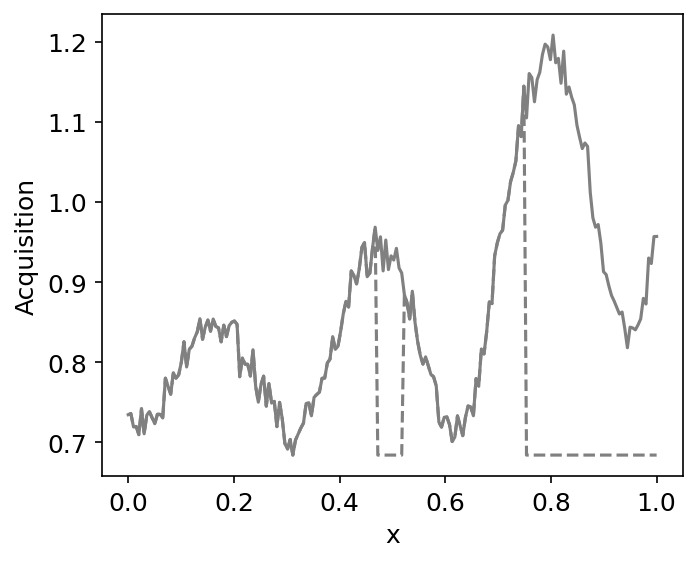

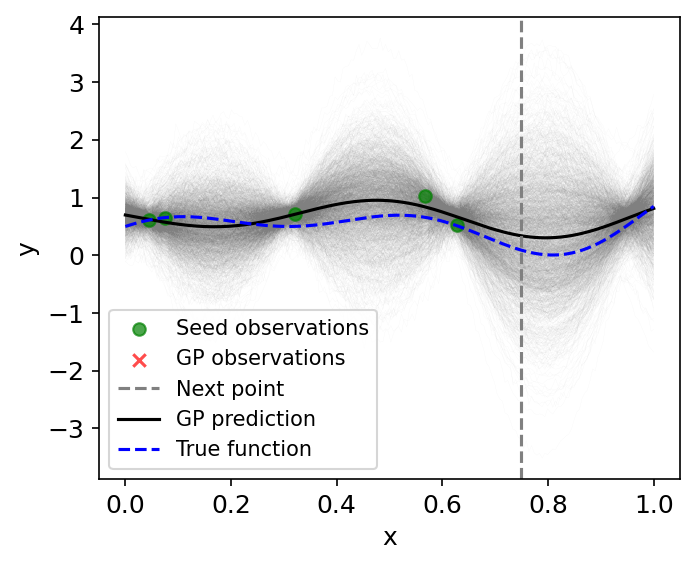


Exploration step 2


sample: 100%|██████████| 4000/4000 [00:22<00:00, 179.90it/s, 7 steps of size 4.92e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.17      0.60     -0.19     -1.14      0.81   1971.09      1.00
          b     -0.20      0.92     -0.23     -1.61      1.32   2184.43      1.00
          c      0.43      0.68      0.44     -0.78      1.46   1725.62      1.00
k_length[0]      2.06      2.41      1.34      0.07      4.23   1502.53      1.00
    k_scale      1.11      1.24      0.72      0.05      2.42   1597.91      1.00
      noise      0.40      0.43      0.27      0.02      0.83   1437.14      1.00



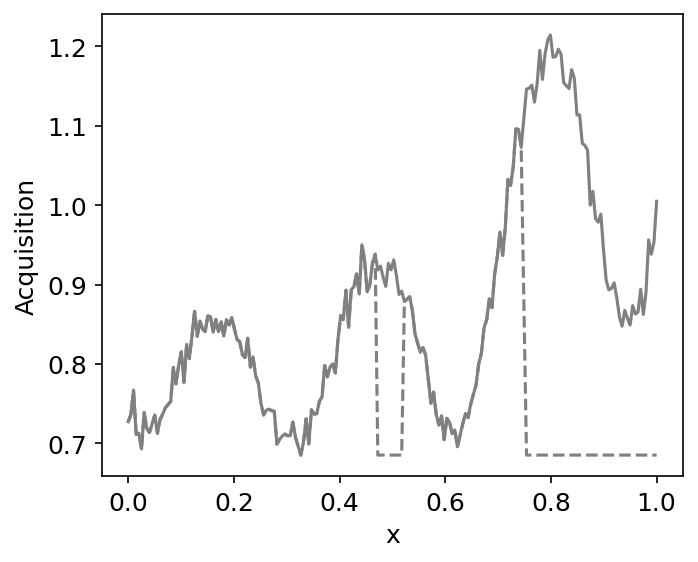

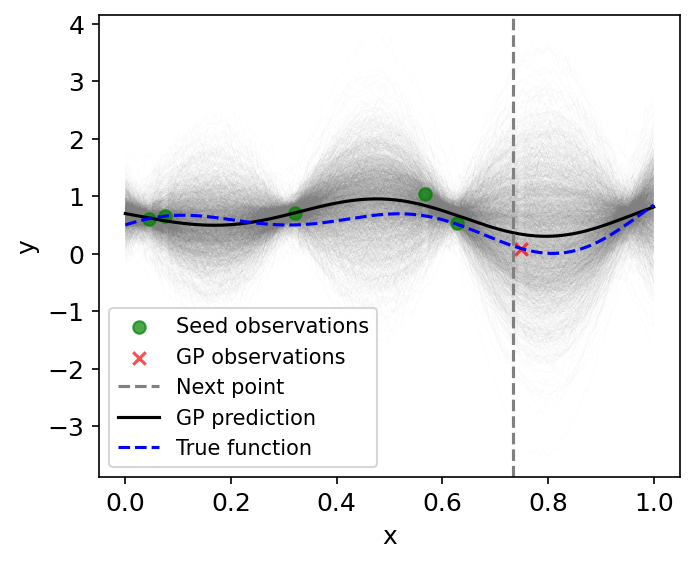


Exploration step 3


sample: 100%|██████████| 4000/4000 [00:13<00:00, 305.57it/s, 7 steps of size 4.39e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.23      0.52     -0.23     -1.03      0.63   1149.51      1.00
          b     -0.33      0.76     -0.34     -1.57      0.91   1262.59      1.00
          c      0.43      0.66      0.46     -0.65      1.49   1572.15      1.00
k_length[0]      2.22      2.49      1.44      0.07      4.77   1158.19      1.00
    k_scale      1.06      1.23      0.68      0.06      2.30   1074.35      1.00
      noise      0.31      0.34      0.20      0.02      0.63   1217.80      1.00



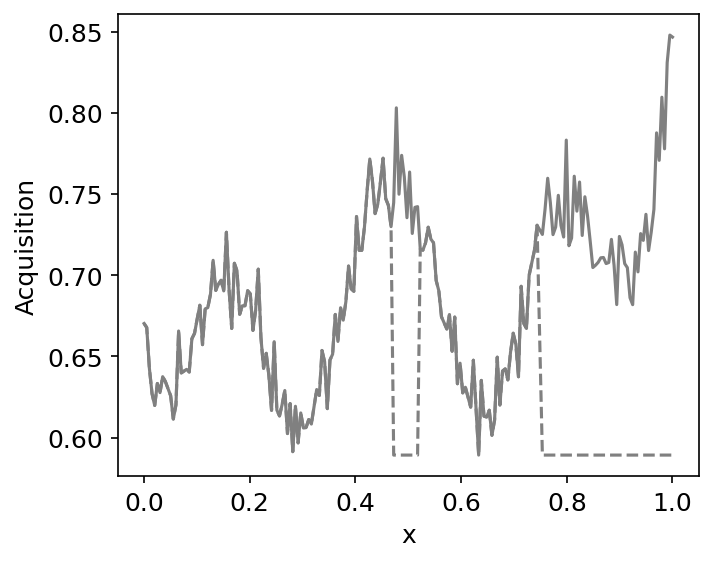

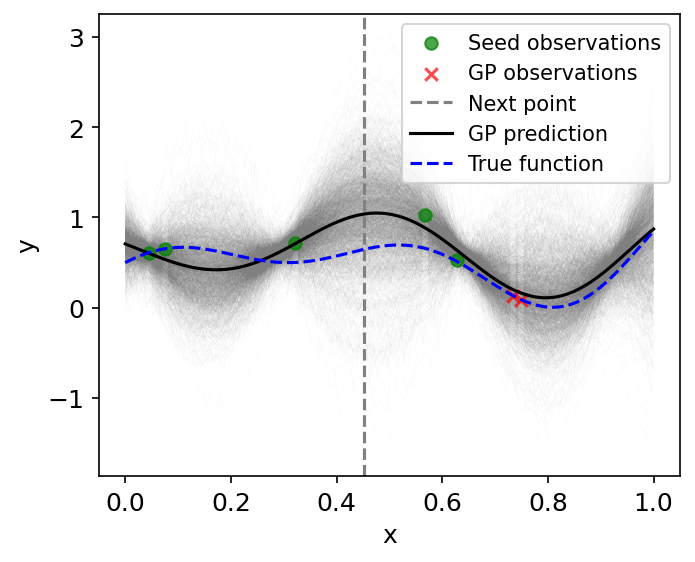


Exploration step 4


sample: 100%|██████████| 4000/4000 [00:12<00:00, 316.69it/s, 15 steps of size 4.01e-01. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.22      0.49     -0.23     -1.03      0.57   1014.36      1.00
          b     -0.40      0.71     -0.40     -1.64      0.65   1033.40      1.00
          c      0.40      0.66      0.43     -0.71      1.44    967.38      1.00
k_length[0]      2.30      2.55      1.46      0.09      5.05   1231.09      1.00
    k_scale      1.04      1.19      0.68      0.05      2.23   1382.66      1.00
      noise      0.22      0.24      0.14      0.01      0.45    964.32      1.00



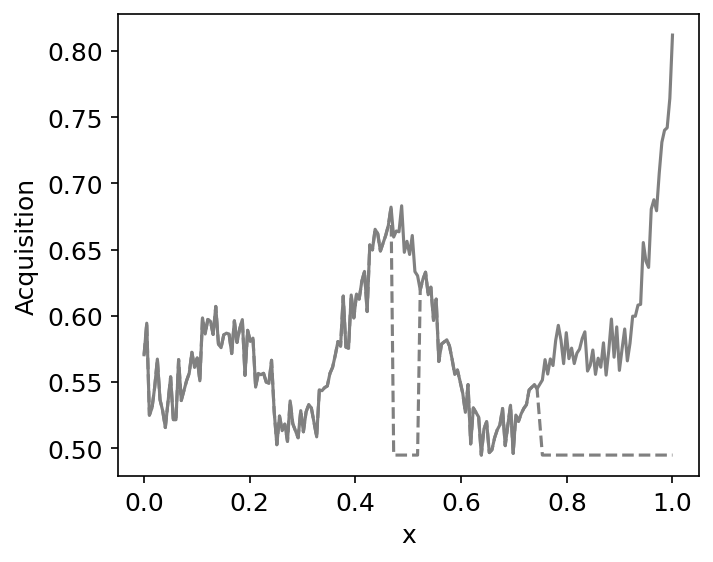

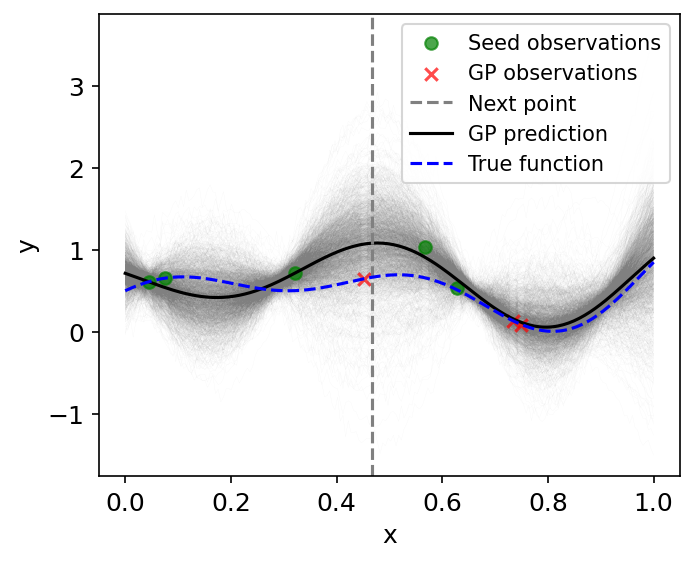


Exploration step 5


sample: 100%|██████████| 4000/4000 [00:12<00:00, 324.06it/s, 11 steps of size 3.01e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a     -0.03      0.44     -0.02     -0.73      0.66   1196.92      1.00
          b     -0.51      0.70     -0.54     -1.62      0.66   1180.02      1.00
          c      0.35      0.63      0.40     -0.66      1.42   1099.84      1.00
k_length[0]      2.27      2.50      1.53      0.08      4.64   1240.92      1.00
    k_scale      1.04      1.31      0.67      0.03      2.23   1272.61      1.00
      noise      0.19      0.20      0.13      0.01      0.38   1212.73      1.00



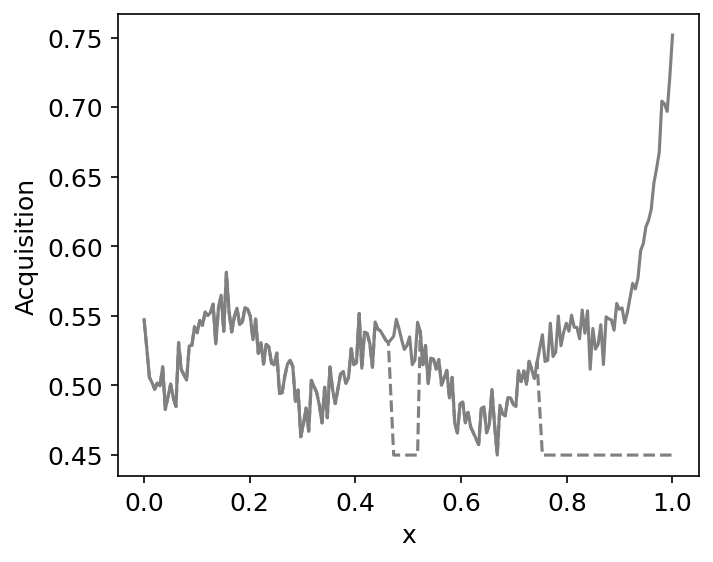

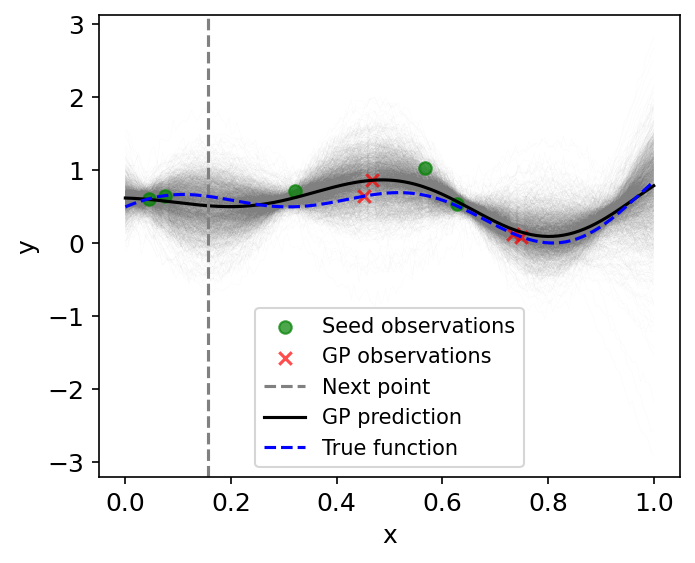


Exploration step 6


sample: 100%|██████████| 4000/4000 [00:14<00:00, 269.23it/s, 15 steps of size 2.30e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.00      0.38      0.02     -0.62      0.61    908.13      1.00
          b     -0.58      0.67     -0.61     -1.62      0.58    965.42      1.00
          c      0.31      0.66      0.37     -0.71      1.43   1042.43      1.00
k_length[0]      2.41      2.83      1.64      0.10      5.05   1130.44      1.00
    k_scale      1.04      1.26      0.66      0.04      2.27    991.39      1.00
      noise      0.15      0.16      0.10      0.02      0.30   1006.54      1.00



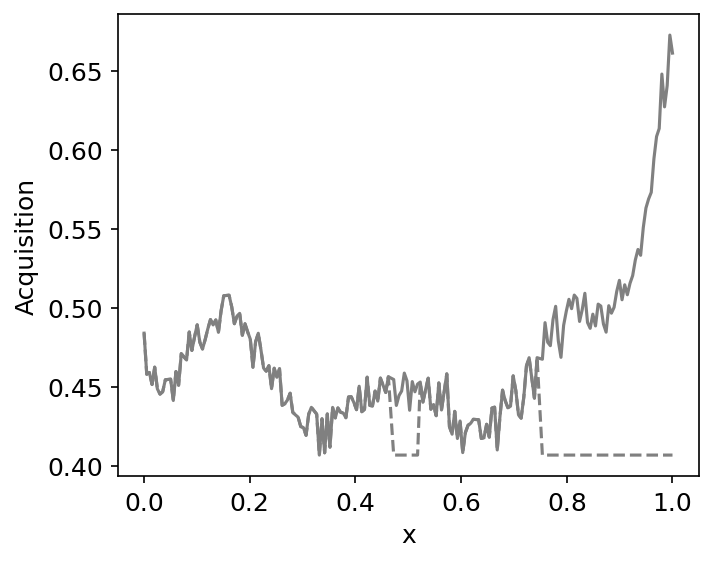

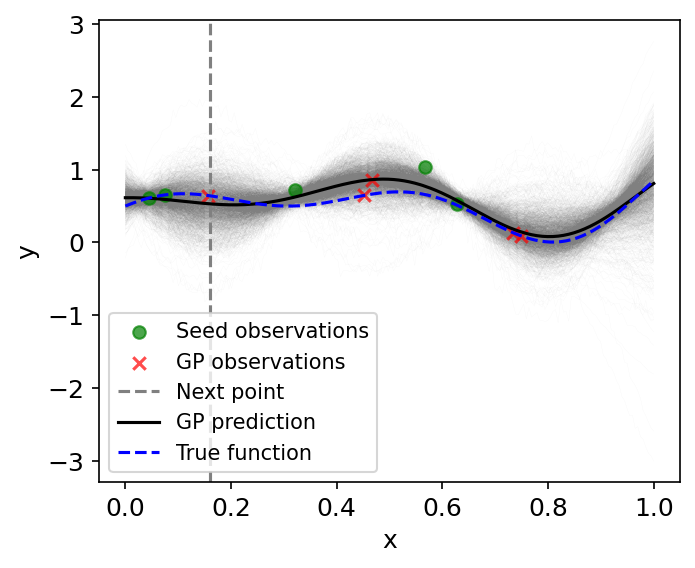


Exploration step 7


sample: 100%|██████████| 4000/4000 [00:15<00:00, 257.61it/s, 15 steps of size 3.26e-01. acc. prob=0.77]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.06      0.31      0.06     -0.44      0.57   1086.20      1.00
          b     -0.69      0.58     -0.71     -1.70      0.24   1033.10      1.00
          c      0.33      0.64      0.36     -0.69      1.38    847.15      1.00
k_length[0]      2.45      2.58      1.63      0.10      4.99    975.37      1.00
    k_scale      0.98      1.15      0.63      0.02      2.05    711.11      1.00
      noise      0.11      0.09      0.08      0.02      0.20    960.23      1.00



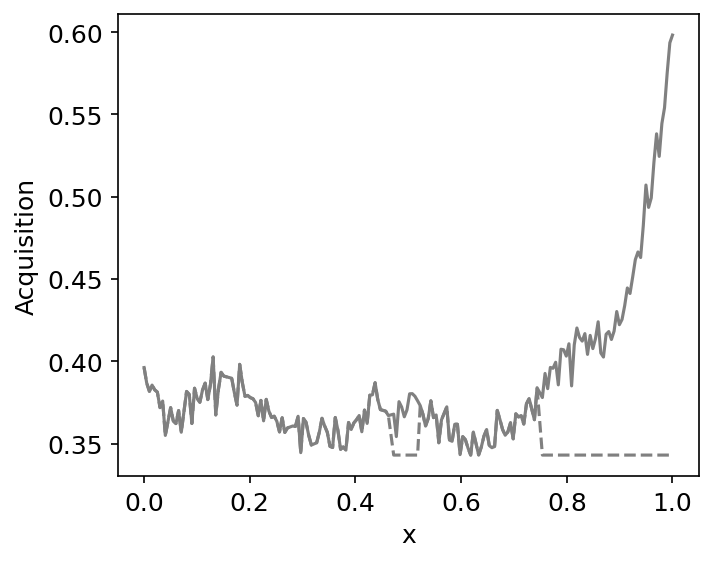

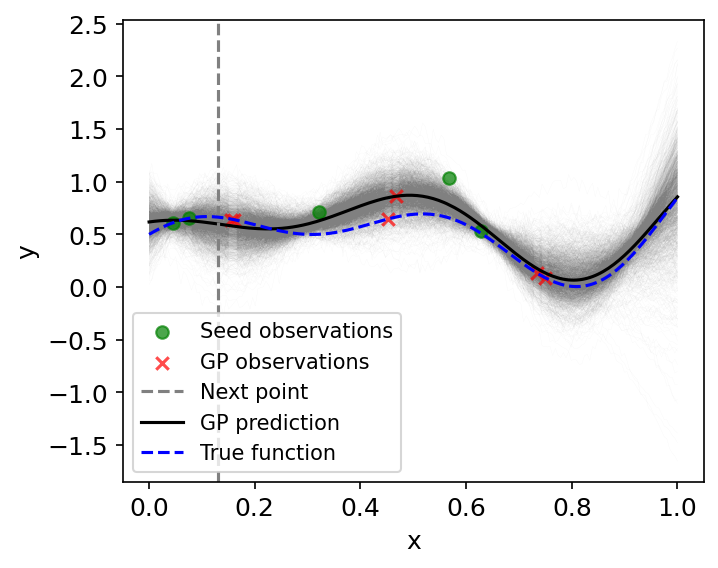


Exploration step 8


sample: 100%|██████████| 4000/4000 [00:14<00:00, 281.72it/s, 15 steps of size 2.17e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.10      0.27      0.12     -0.33      0.55    897.66      1.00
          b     -0.74      0.54     -0.79     -1.54      0.24    849.03      1.00
          c      0.32      0.64      0.36     -0.77      1.30   1258.60      1.00
k_length[0]      2.60      3.01      1.81      0.10      5.15   1108.13      1.00
    k_scale      1.01      1.20      0.66      0.04      2.18   1483.33      1.00
      noise      0.08      0.08      0.06      0.01      0.17    978.64      1.00



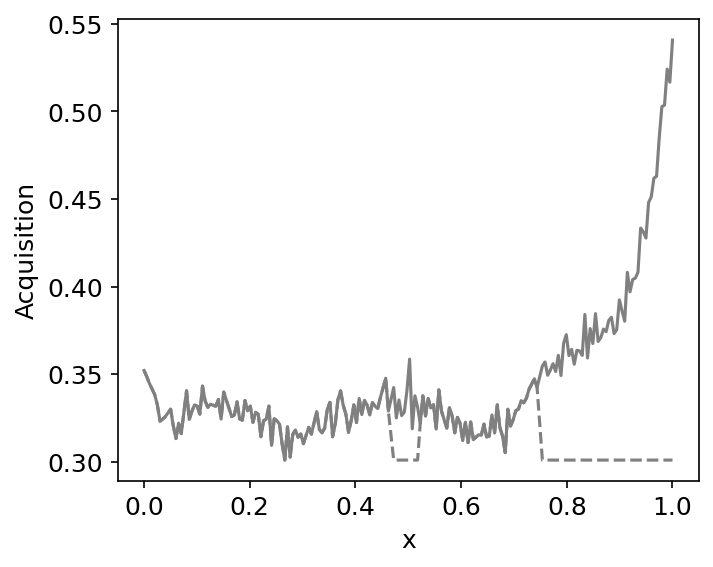

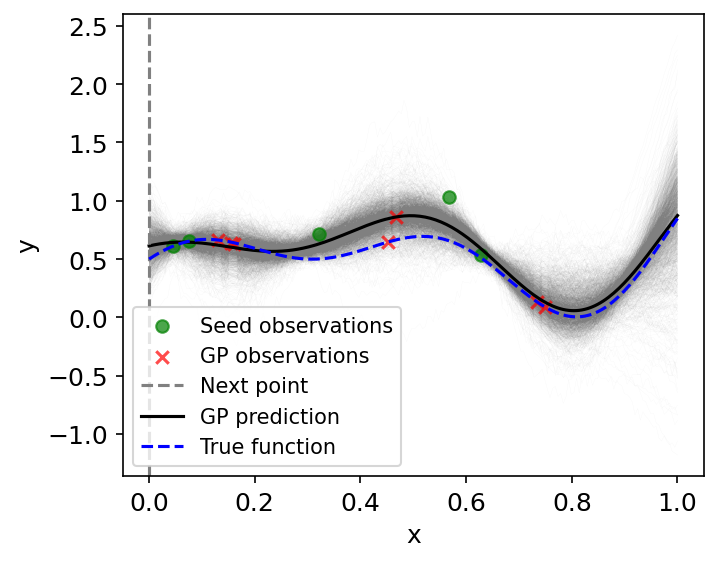


Exploration step 9


sample: 100%|██████████| 4000/4000 [00:13<00:00, 293.56it/s, 15 steps of size 2.71e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.13      0.24      0.15     -0.30      0.51   1180.99      1.00
          b     -0.81      0.49     -0.85     -1.63     -0.05   1199.37      1.00
          c      0.34      0.64      0.38     -0.60      1.45    954.36      1.00
k_length[0]      2.61      2.84      1.83      0.11      5.28    946.53      1.00
    k_scale      0.96      1.06      0.63      0.03      2.10   1340.66      1.00
      noise      0.06      0.06      0.05      0.01      0.12   1092.67      1.00



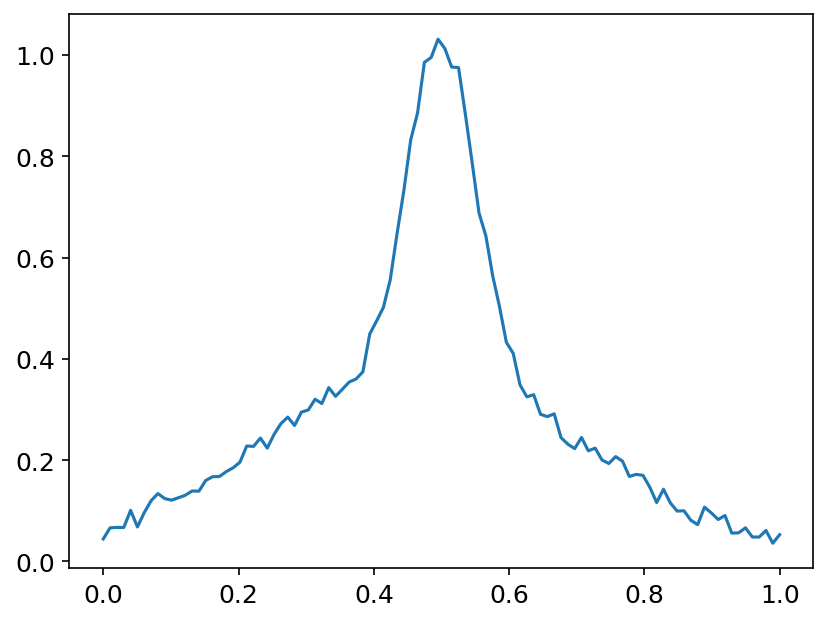

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
4


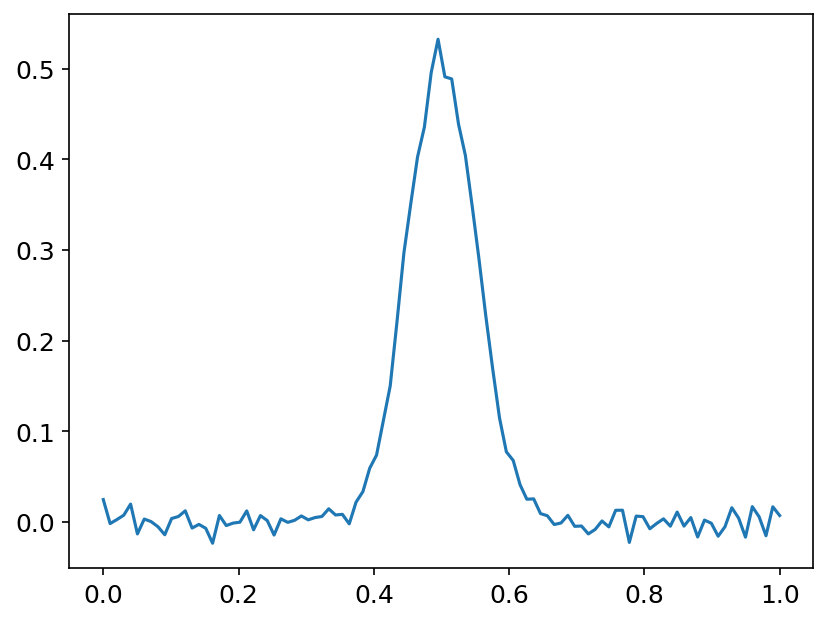

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


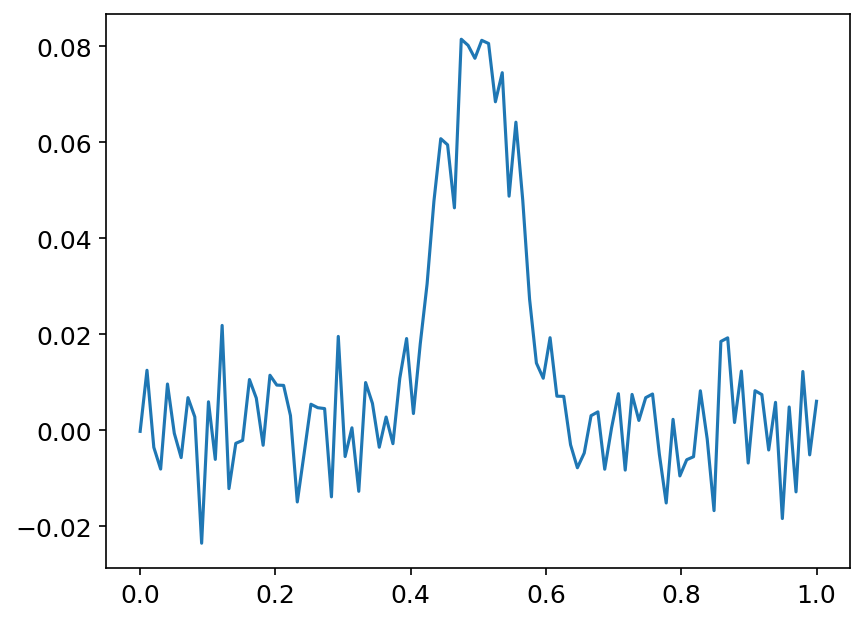

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
6


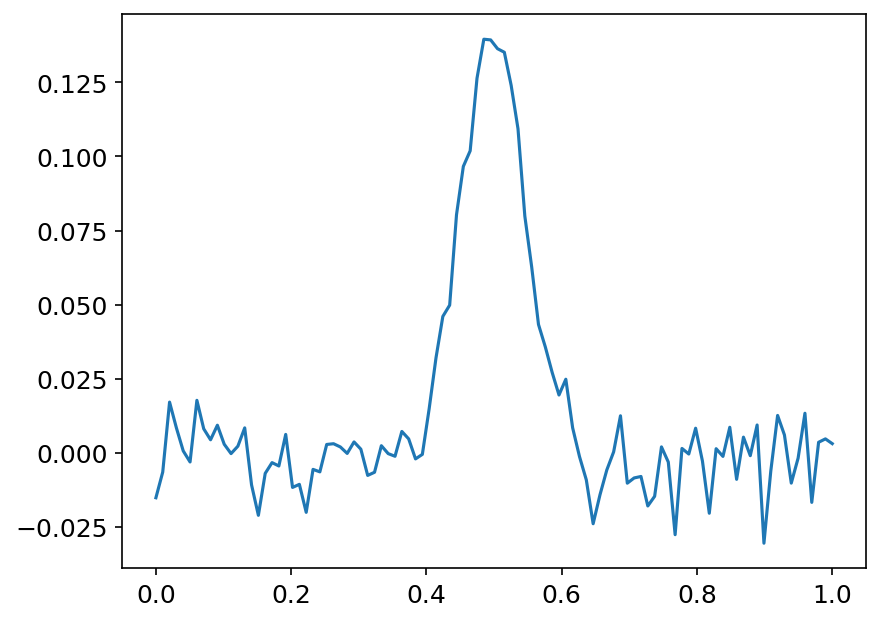

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
6


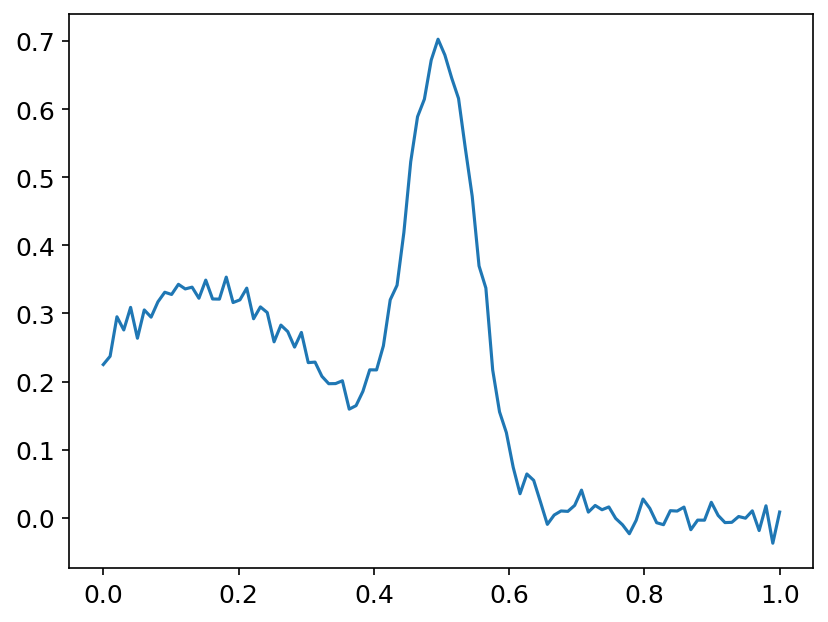

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
1


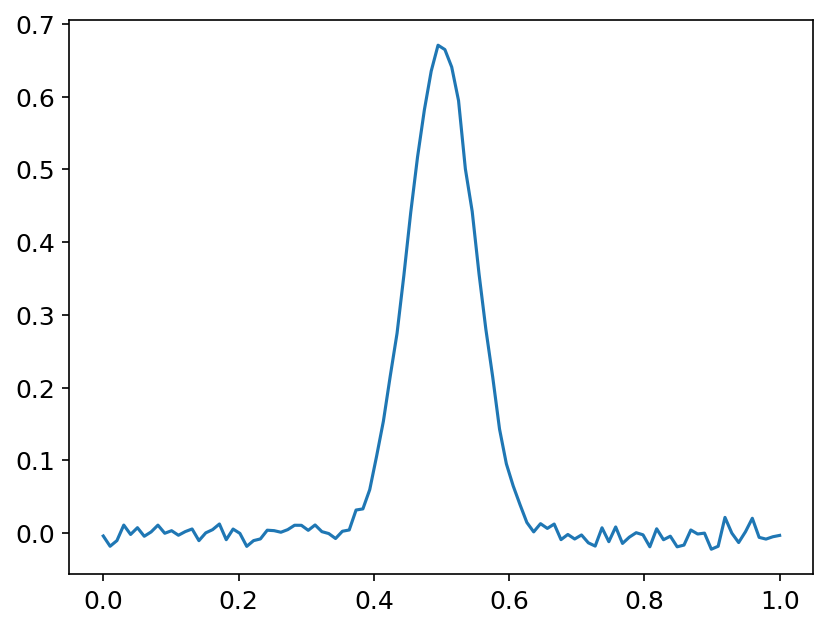

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


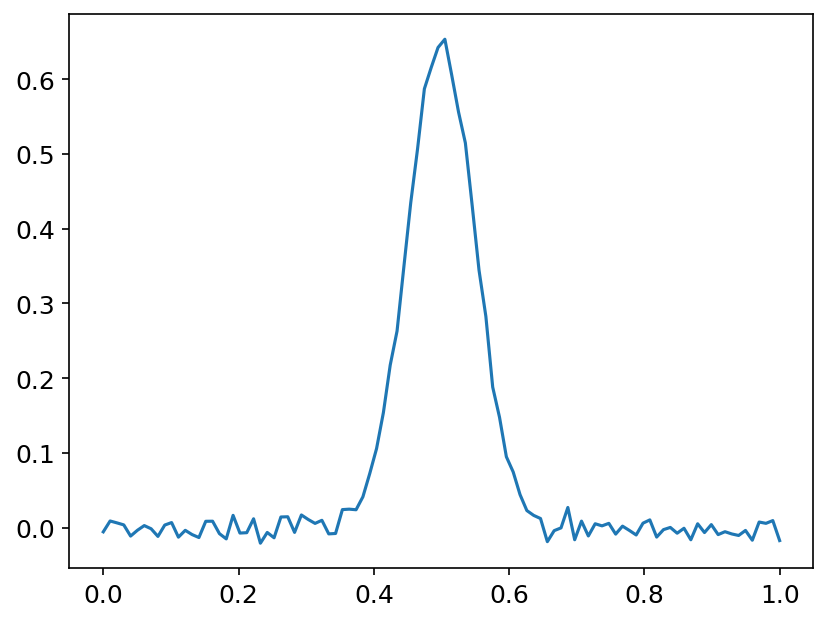

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


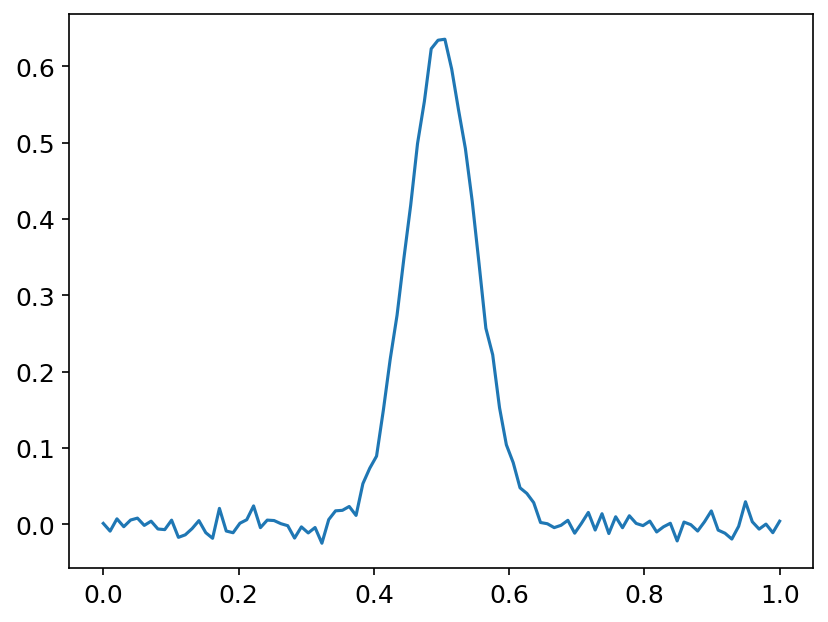

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


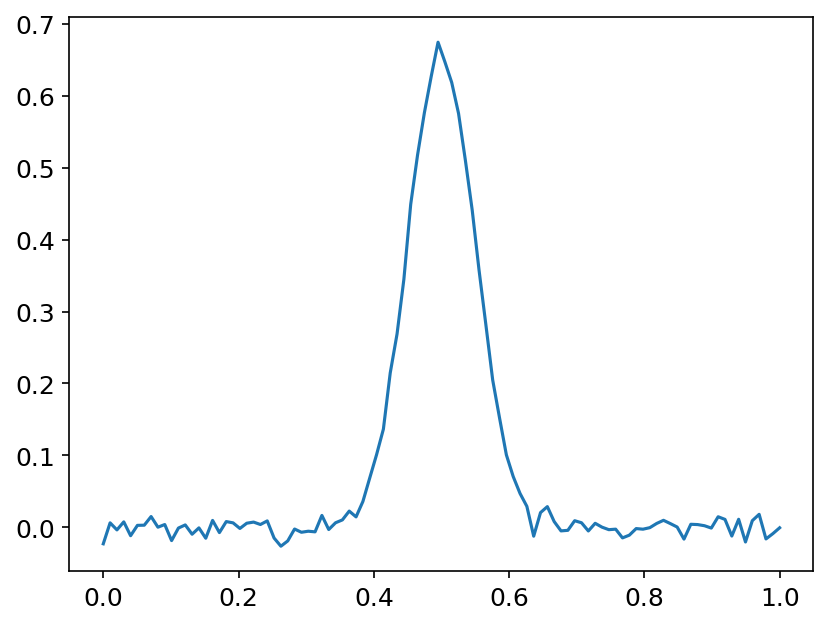

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


sample: 100%|██████████| 4000/4000 [00:11<00:00, 344.78it/s, 7 steps of size 8.13e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      2.30      2.84      1.58      0.17      4.55   1638.62      1.00
    k_scale      1.10      1.05      0.78      0.10      2.26   1037.97      1.00
      noise      0.16      0.08      0.14      0.06      0.27   1457.26      1.00



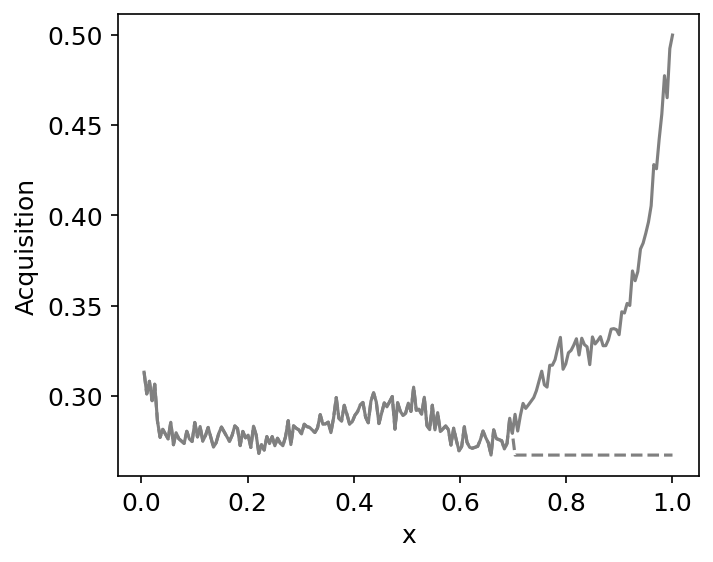

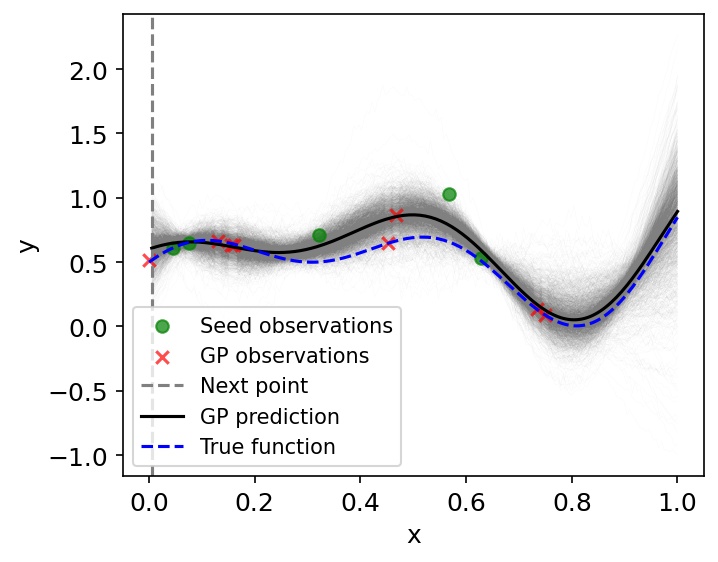


Exploration step 10


sample: 100%|██████████| 4000/4000 [00:12<00:00, 311.53it/s, 15 steps of size 3.46e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.08      0.25      0.08     -0.33      0.48   1198.42      1.00
          b     -0.48      0.74     -0.49     -1.63      0.78   1127.90      1.00
          c      0.38      0.64      0.41     -0.63      1.43    970.40      1.00
k_length[0]      2.54      2.71      1.75      0.15      5.15   1043.86      1.00
    k_scale      0.98      1.13      0.62      0.04      2.13   1494.04      1.00
      noise      0.08      0.07      0.06      0.01      0.15   1073.09      1.00



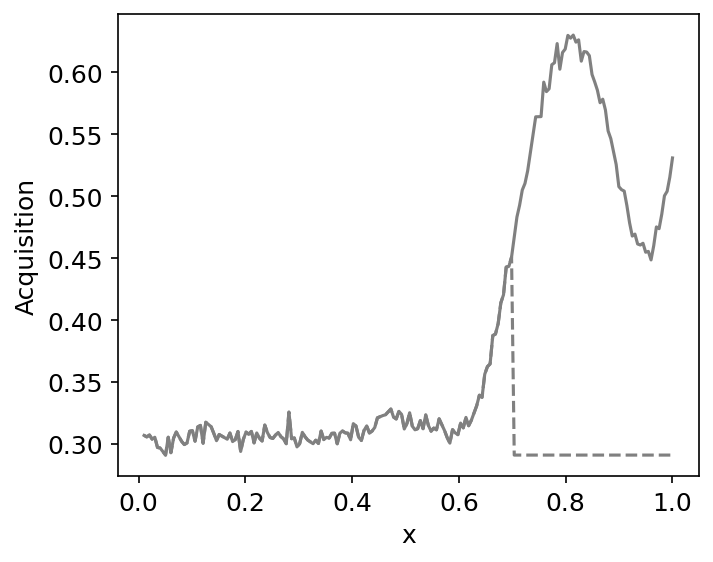

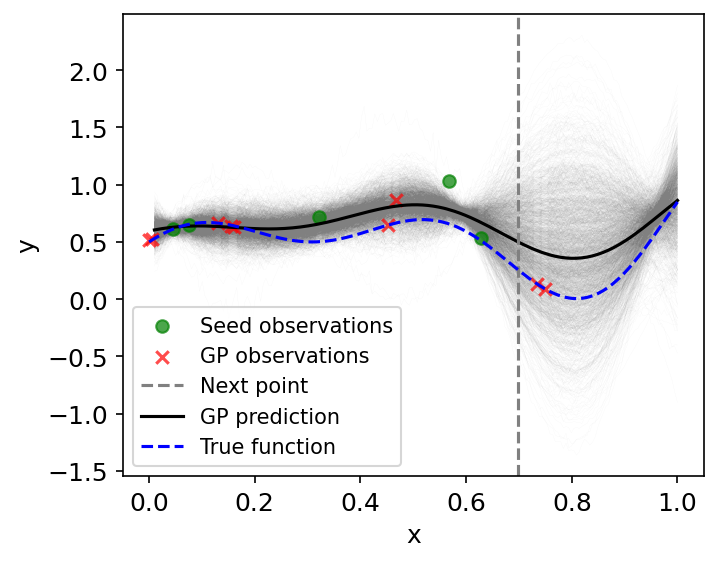


Exploration step 11


sample: 100%|██████████| 4000/4000 [00:13<00:00, 291.64it/s, 15 steps of size 2.74e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.12      0.24      0.13     -0.31      0.47   1143.19      1.00
          b     -0.59      0.68     -0.64     -1.72      0.53   1220.20      1.00
          c      0.35      0.64      0.41     -0.63      1.44   1005.34      1.00
k_length[0]      2.59      2.51      1.83      0.09      5.25   1277.77      1.00
    k_scale      0.98      1.14      0.63      0.02      2.08   1266.04      1.00
      noise      0.06      0.06      0.05      0.01      0.12    949.99      1.00



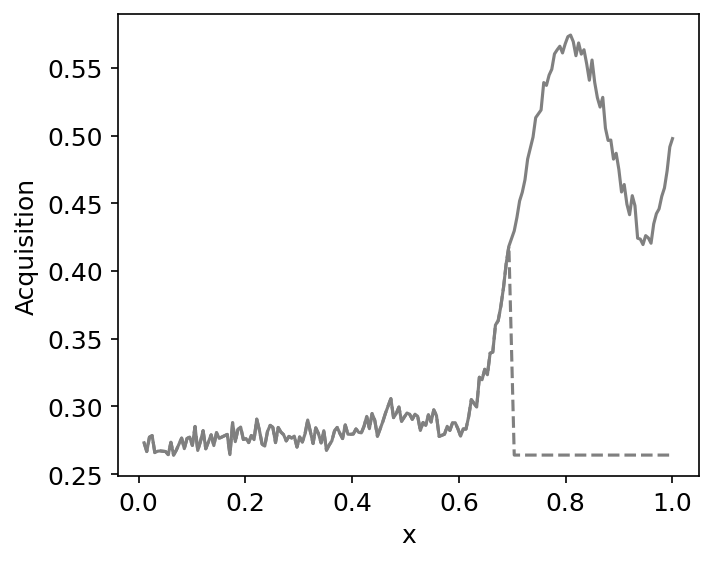

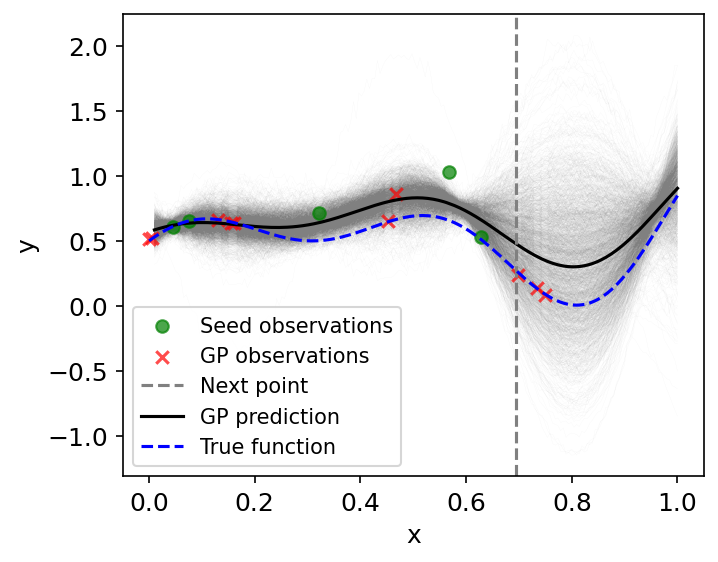


Exploration step 12


sample: 100%|██████████| 4000/4000 [00:14<00:00, 278.94it/s, 15 steps of size 2.64e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.21      0.18     -0.17      0.49   1162.25      1.00
          b     -0.86      0.54     -0.91     -1.71     -0.02   1104.09      1.00
          c      0.33      0.62      0.36     -0.67      1.32   1193.37      1.00
k_length[0]      2.83      2.77      2.02      0.17      5.84   1092.46      1.00
    k_scale      0.93      1.00      0.61      0.04      2.11   1813.80      1.00
      noise      0.05      0.04      0.04      0.01      0.10    975.72      1.00



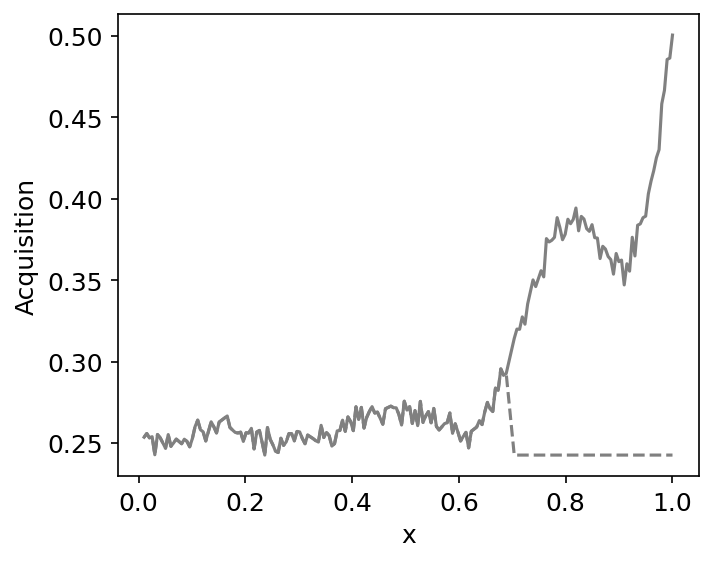

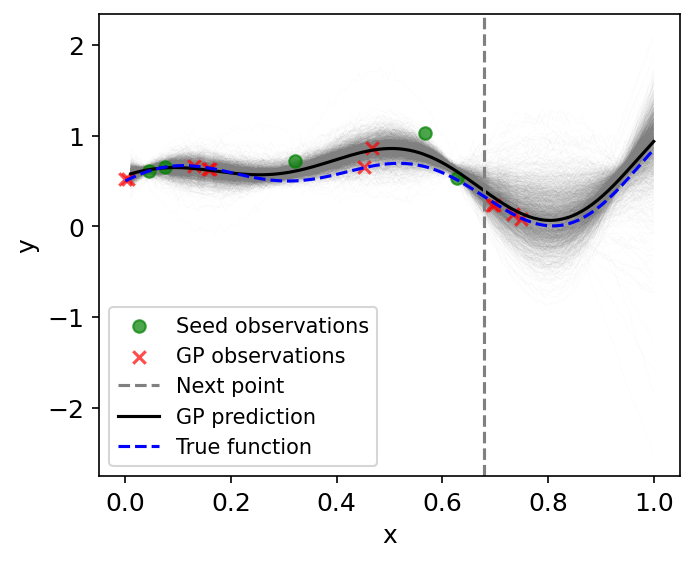


Exploration step 13


sample: 100%|██████████| 4000/4000 [00:15<00:00, 263.55it/s, 15 steps of size 2.69e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.20      0.19      0.21     -0.11      0.53   1214.29      1.00
          b     -0.96      0.46     -1.00     -1.68     -0.20   1026.10      1.00
          c      0.34      0.63      0.37     -0.60      1.45   1194.54      1.00
k_length[0]      2.89      2.73      2.14      0.13      5.75   1264.44      1.00
    k_scale      0.92      1.02      0.60      0.03      2.05   1666.71      1.00
      noise      0.04      0.03      0.03      0.01      0.08   1112.23      1.00



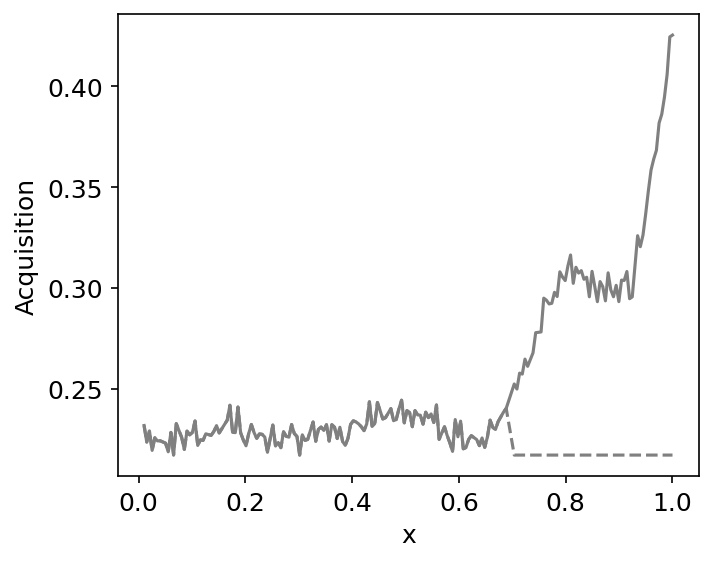

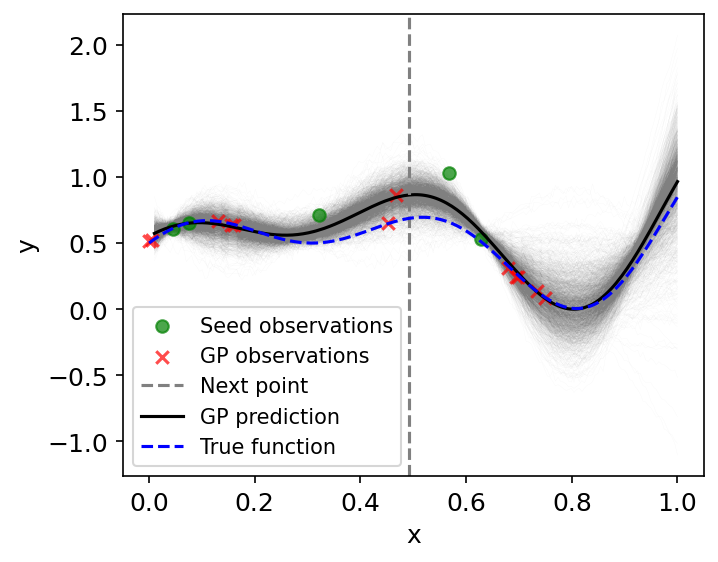


Exploration step 14


sample: 100%|██████████| 4000/4000 [00:14<00:00, 270.02it/s, 7 steps of size 3.37e-01. acc. prob=0.79]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.17      0.22     -0.08      0.48    990.02      1.00
          b     -1.01      0.42     -1.03     -1.66     -0.32    988.57      1.00
          c      0.30      0.66      0.34     -0.66      1.55    809.68      1.00
k_length[0]      3.02      3.19      2.09      0.24      6.40    846.30      1.00
    k_scale      0.95      1.18      0.60      0.04      2.10   1357.36      1.00
      noise      0.04      0.03      0.03      0.01      0.07    725.13      1.00



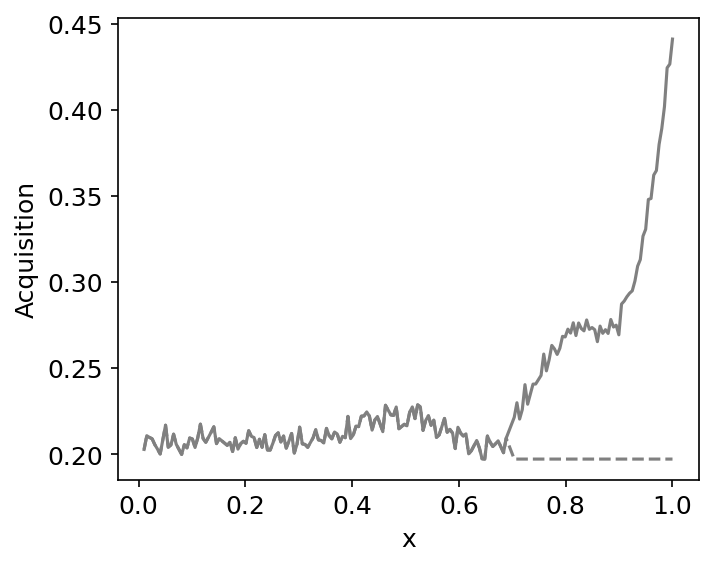

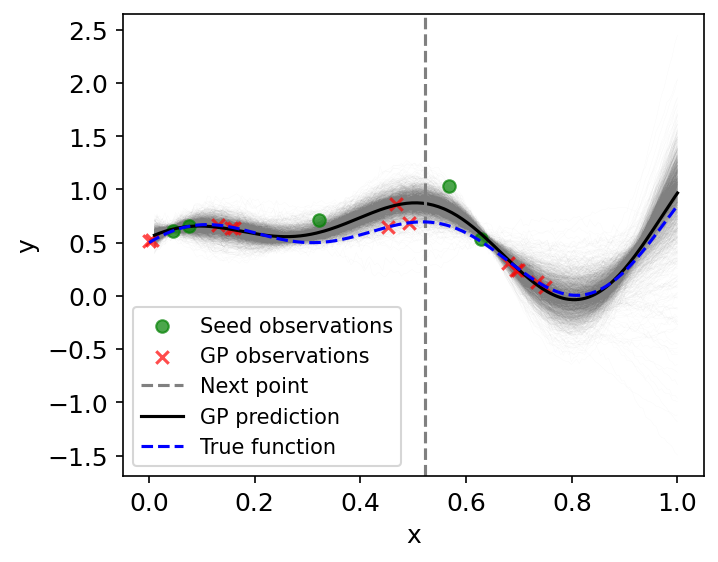


Exploration step 15


sample: 100%|██████████| 4000/4000 [00:14<00:00, 267.87it/s, 15 steps of size 2.07e-01. acc. prob=0.95]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.17      0.22     -0.05      0.51    851.85      1.00
          b     -0.95      0.40     -0.97     -1.56     -0.22    816.09      1.00
          c      0.30      0.64      0.33     -0.77      1.35    924.62      1.00
k_length[0]      3.19      3.18      2.26      0.22      6.52   1186.78      1.00
    k_scale      0.91      1.09      0.60      0.02      1.92   1558.48      1.00
      noise      0.04      0.02      0.03      0.01      0.06   1130.74      1.00



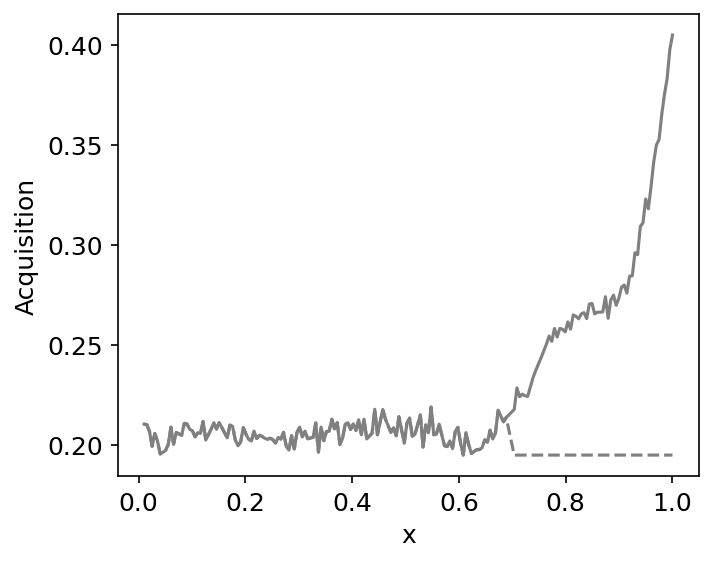

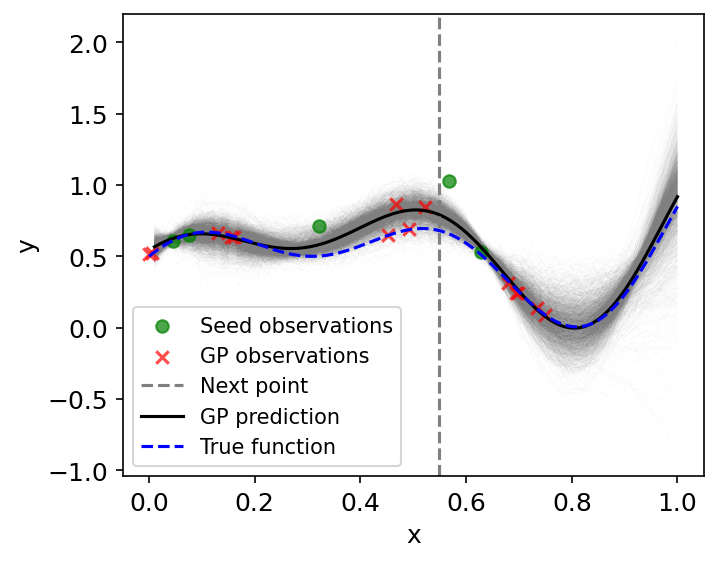


Exploration step 16


sample: 100%|██████████| 4000/4000 [00:15<00:00, 264.66it/s, 15 steps of size 2.83e-01. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.22      0.17      0.23     -0.05      0.49    874.68      1.00
          b     -0.97      0.40     -0.99     -1.64     -0.38    754.18      1.00
          c      0.31      0.63      0.34     -0.62      1.46    961.35      1.00
k_length[0]      3.04      2.88      2.24      0.17      6.13   1236.02      1.00
    k_scale      0.87      0.94      0.58      0.04      1.89   1130.32      1.00
      noise      0.03      0.02      0.03      0.01      0.05    971.84      1.00



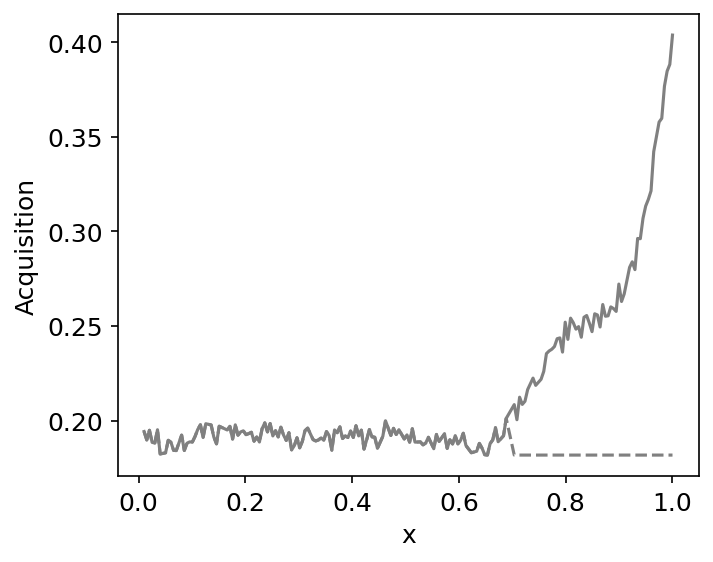

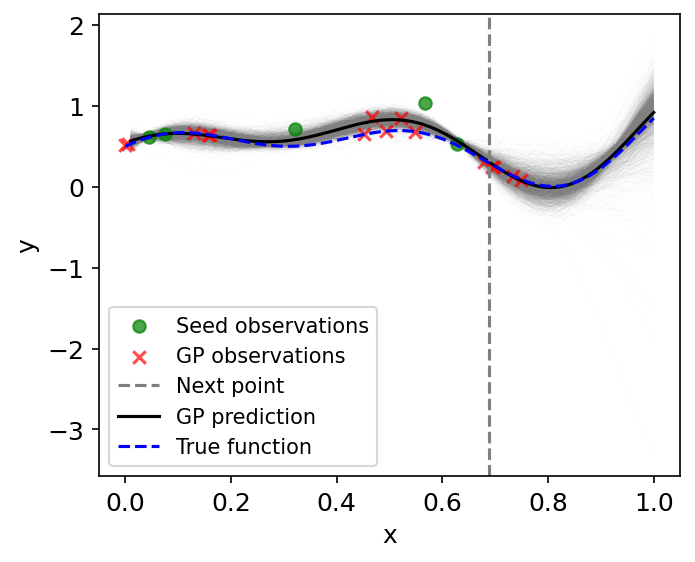


Exploration step 17


sample: 100%|██████████| 4000/4000 [00:14<00:00, 267.56it/s, 15 steps of size 2.75e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.22      0.16      0.23     -0.04      0.48   1214.77      1.00
          b     -0.94      0.37     -0.97     -1.53     -0.38   1132.17      1.00
          c      0.32      0.61      0.34     -0.79      1.22   1437.44      1.00
k_length[0]      3.15      3.20      2.27      0.19      6.49   1427.81      1.00
    k_scale      0.90      1.17      0.58      0.01      1.92   1321.70      1.00
      noise      0.03      0.02      0.02      0.01      0.05   1108.25      1.00



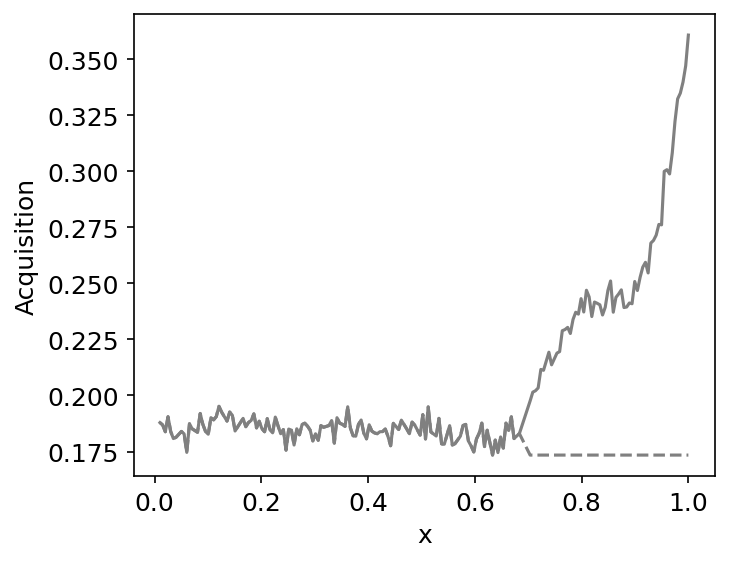

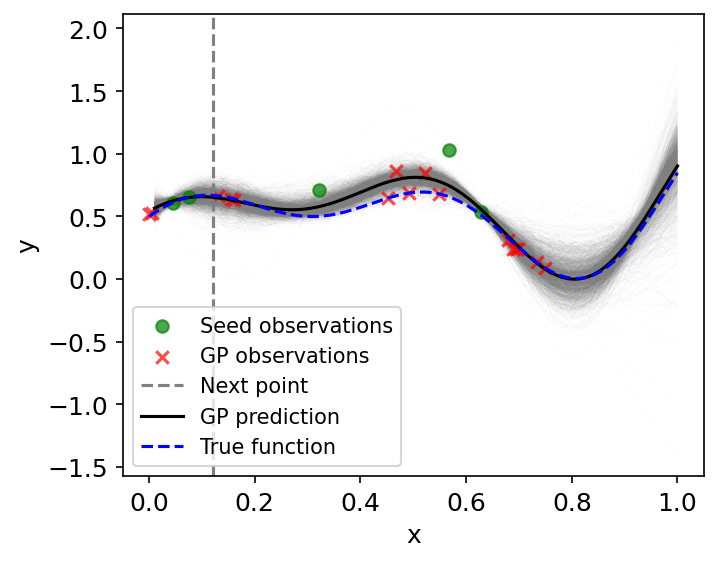


Exploration step 18


sample: 100%|██████████| 4000/4000 [00:15<00:00, 263.91it/s, 15 steps of size 2.54e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.23      0.15      0.23      0.00      0.48    666.99      1.00
          b     -0.99      0.36     -1.01     -1.55     -0.46    520.98      1.00
          c      0.31      0.60      0.36     -0.66      1.30   1418.04      1.00
k_length[0]      3.06      2.96      2.21      0.25      6.24   1403.28      1.00
    k_scale      0.84      0.97      0.55      0.03      1.79   1406.41      1.00
      noise      0.03      0.01      0.02      0.01      0.04   1405.19      1.00



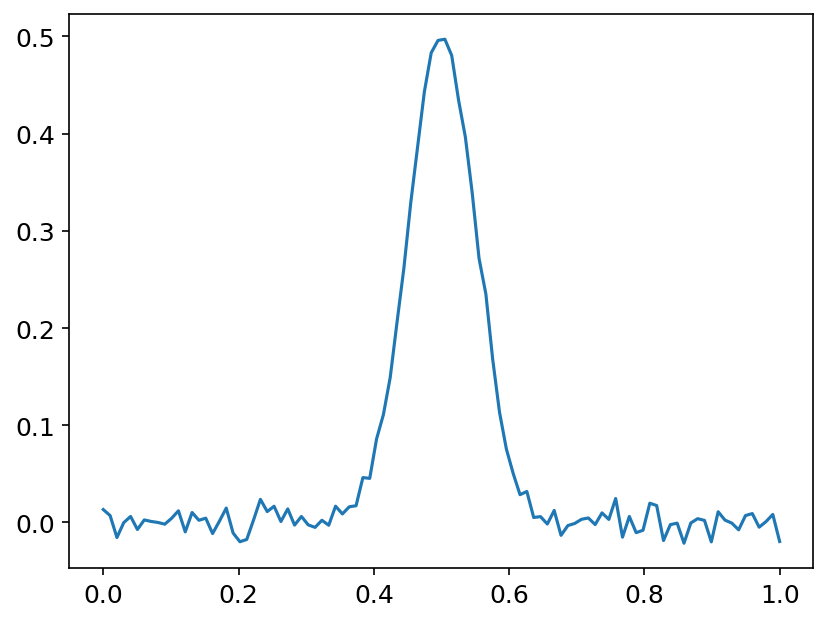

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


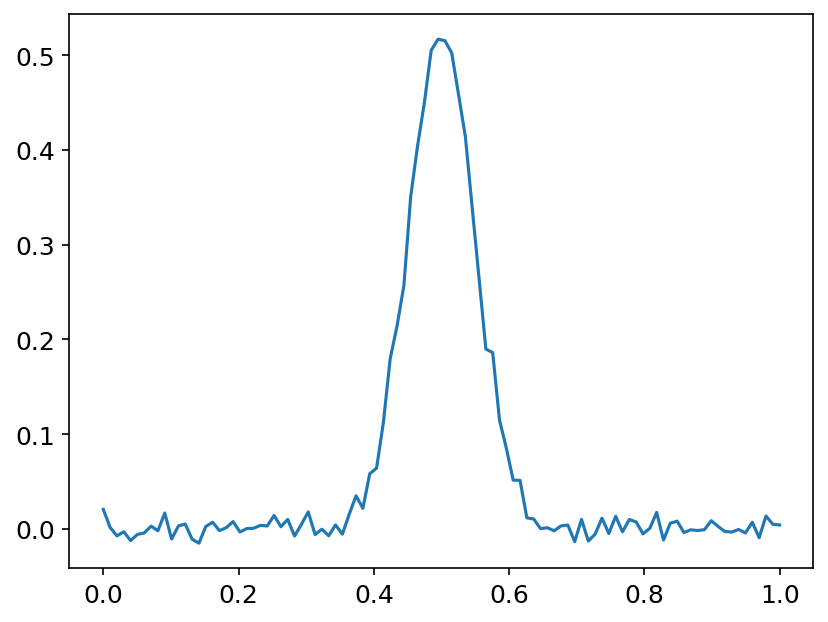

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


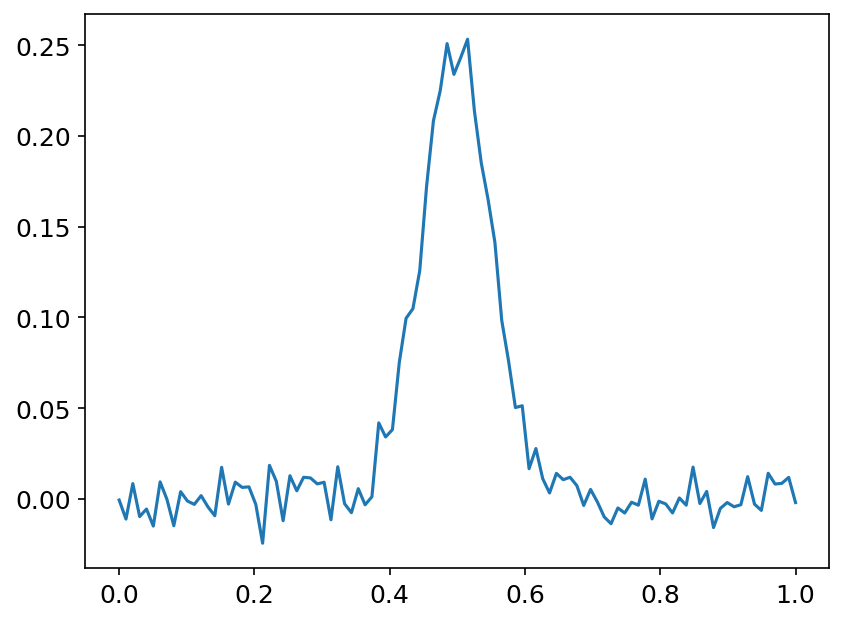

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


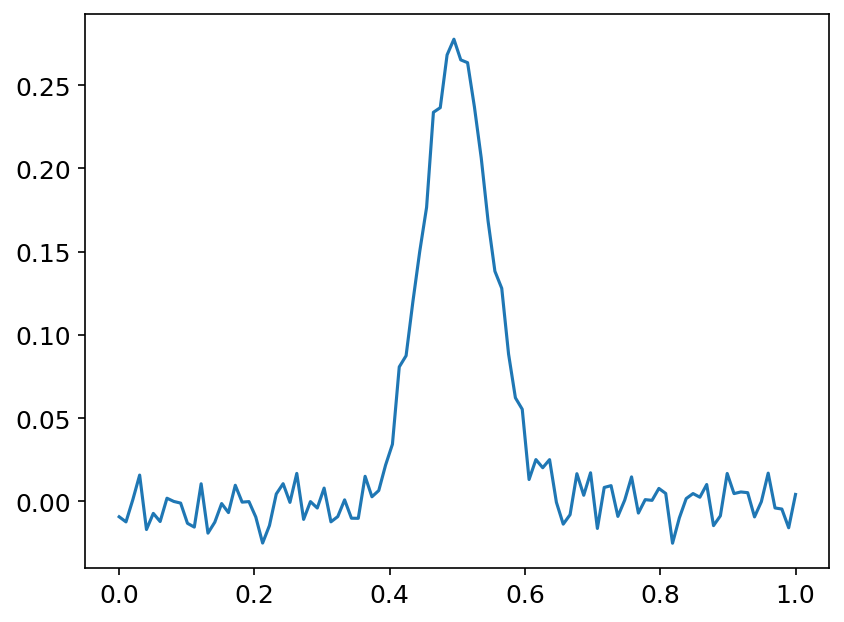

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


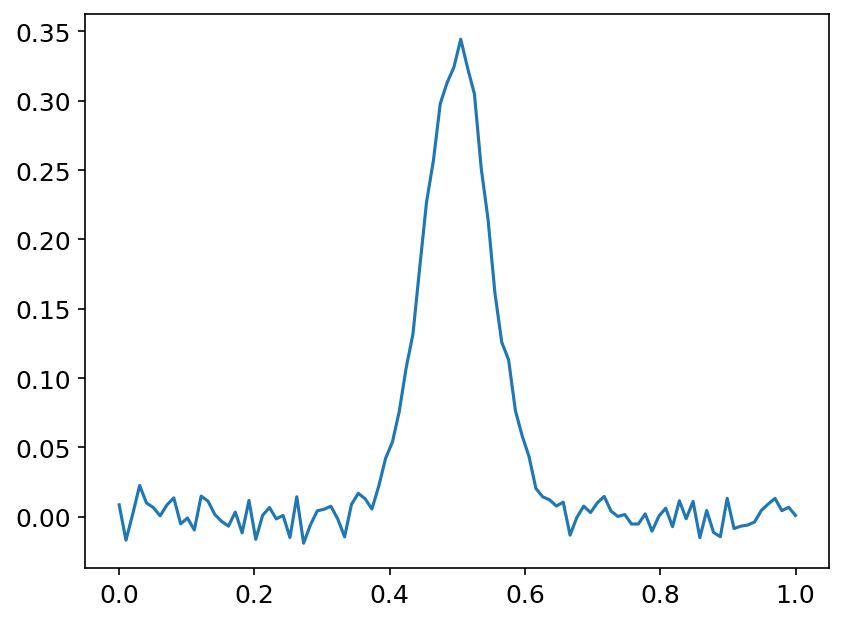

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


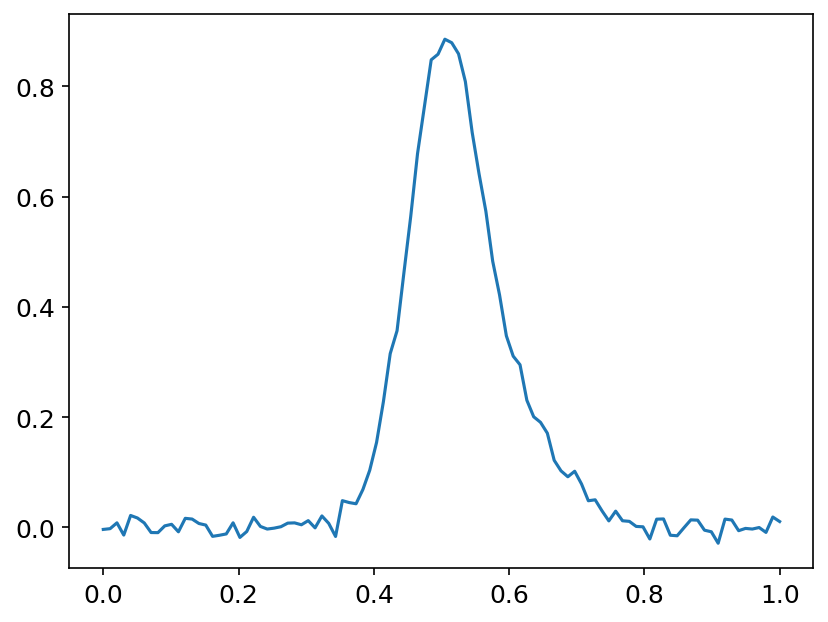

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
8


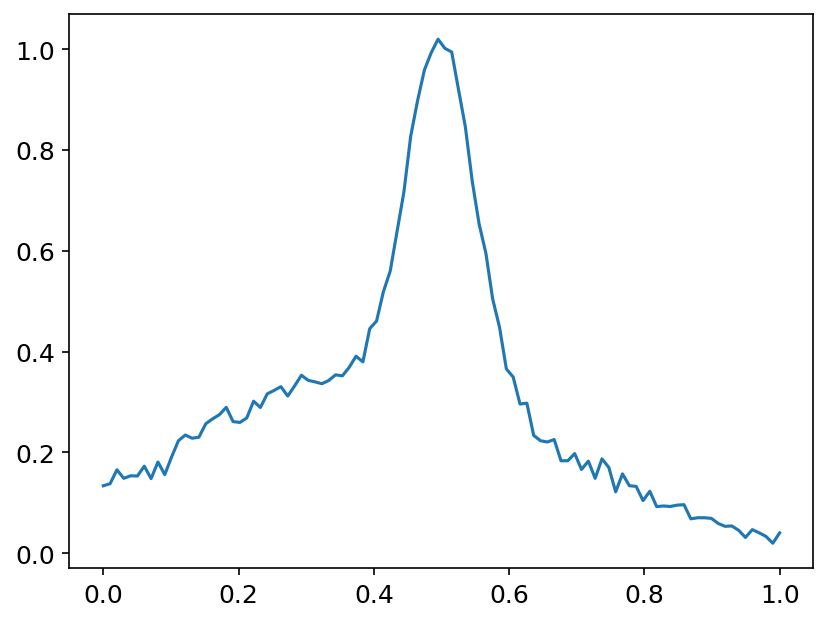

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
3


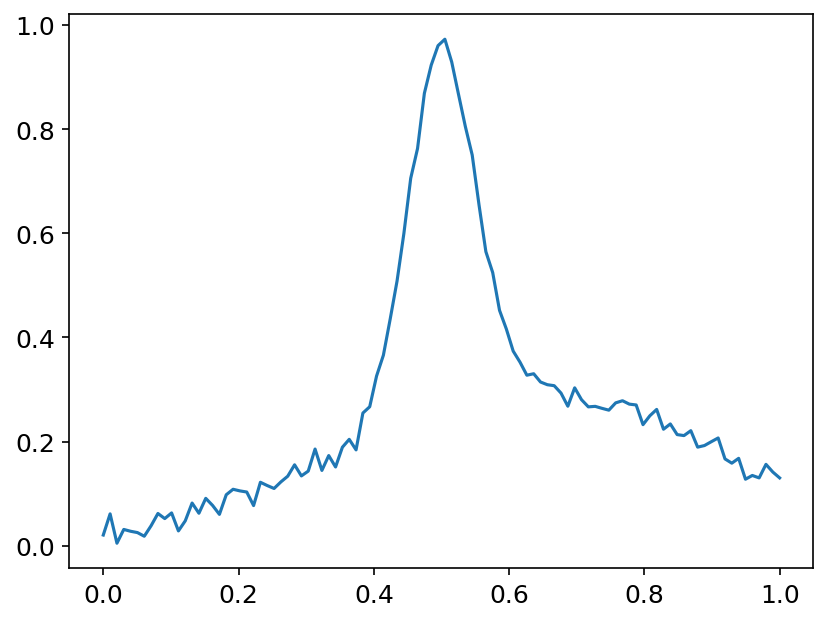

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
3


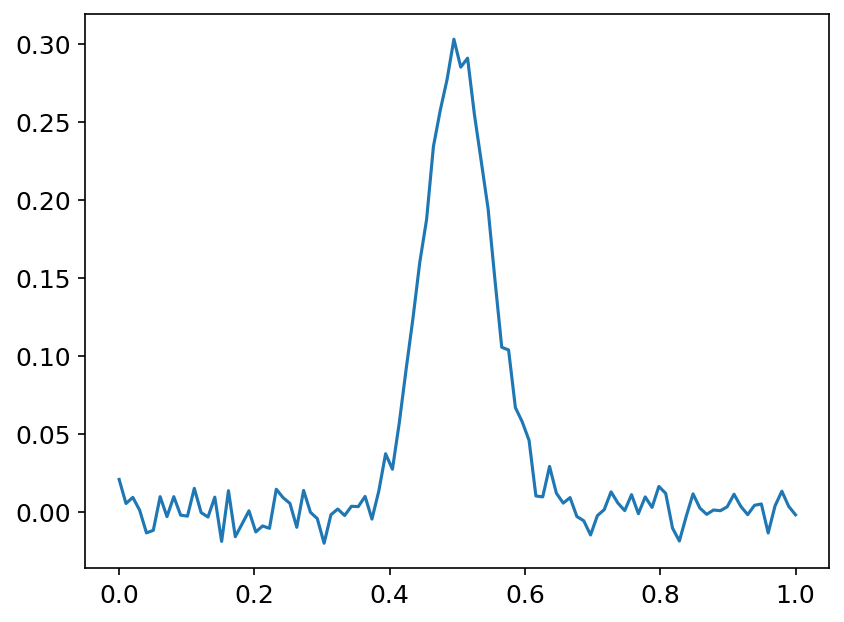

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


sample: 100%|██████████| 4000/4000 [00:11<00:00, 345.92it/s, 5 steps of size 5.87e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.89      2.45      1.01      0.12      4.40    977.85      1.00
    k_scale      1.18      1.06      0.85      0.15      2.38   1323.59      1.00
      noise      0.12      0.05      0.11      0.05      0.19   1233.79      1.00



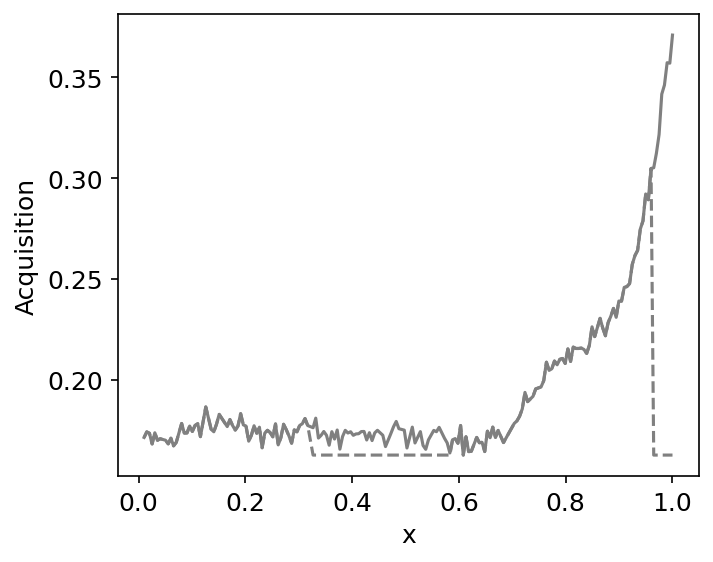

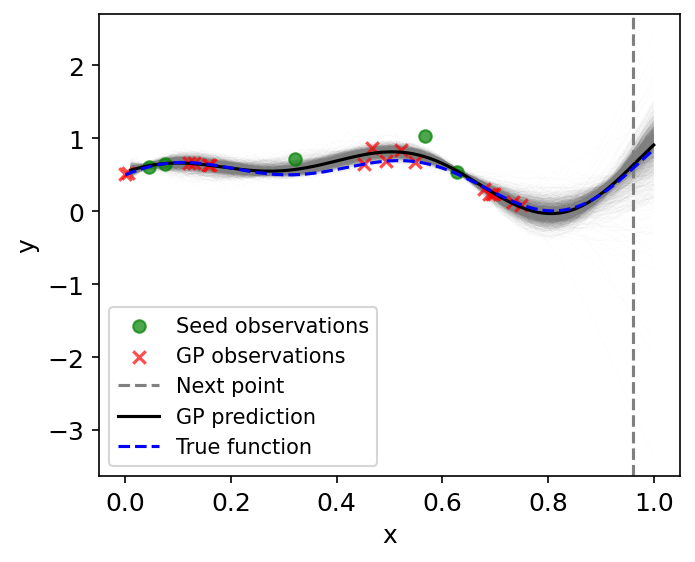


Exploration step 19


sample: 100%|██████████| 4000/4000 [00:13<00:00, 297.09it/s, 15 steps of size 3.51e-01. acc. prob=0.86]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.15      0.13      0.16     -0.05      0.35    821.39      1.00
          b     -0.79      0.33     -0.82     -1.29     -0.31    836.03      1.00
          c      0.25      0.64      0.28     -0.81      1.29    879.06      1.00
k_length[0]      2.17      2.54      1.30      0.19      4.79    843.74      1.00
    k_scale      0.95      1.06      0.62      0.01      2.06   1208.14      1.00
      noise      0.01      0.01      0.01      0.00      0.02    666.24      1.00



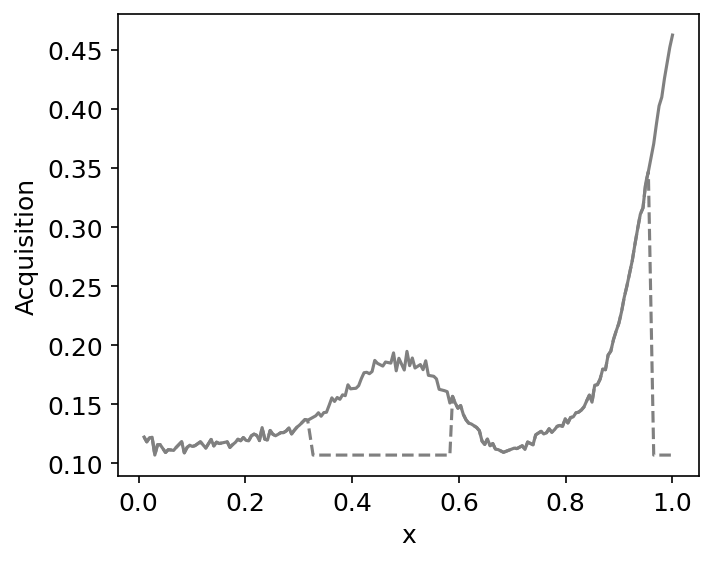

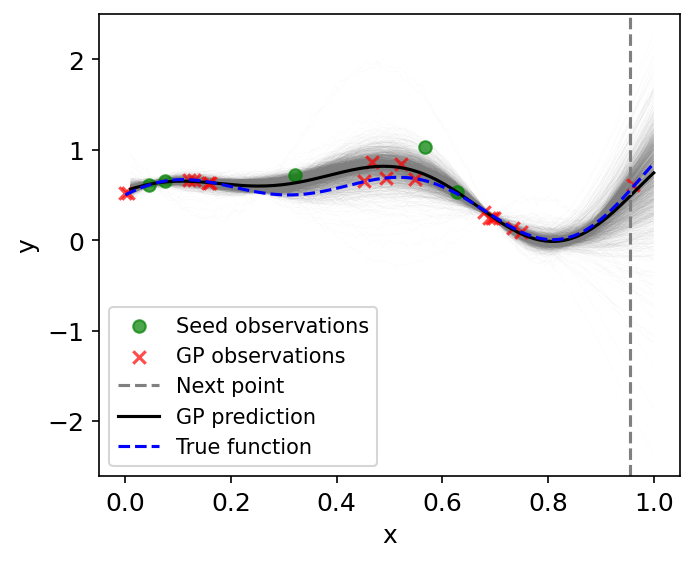


Exploration step 20


sample: 100%|██████████| 4000/4000 [00:13<00:00, 301.72it/s, 15 steps of size 3.09e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.19      0.11      0.19     -0.01      0.33   1021.59      1.00
          b     -0.89      0.20     -0.90     -1.23     -0.57    981.40      1.00
          c      0.30      0.59      0.32     -0.65      1.31    979.64      1.01
k_length[0]      3.00      3.26      1.90      0.20      6.38   1032.20      1.00
    k_scale      0.82      0.92      0.53      0.02      1.82   1265.60      1.00
      noise      0.01      0.01      0.01      0.00      0.02    958.10      1.00



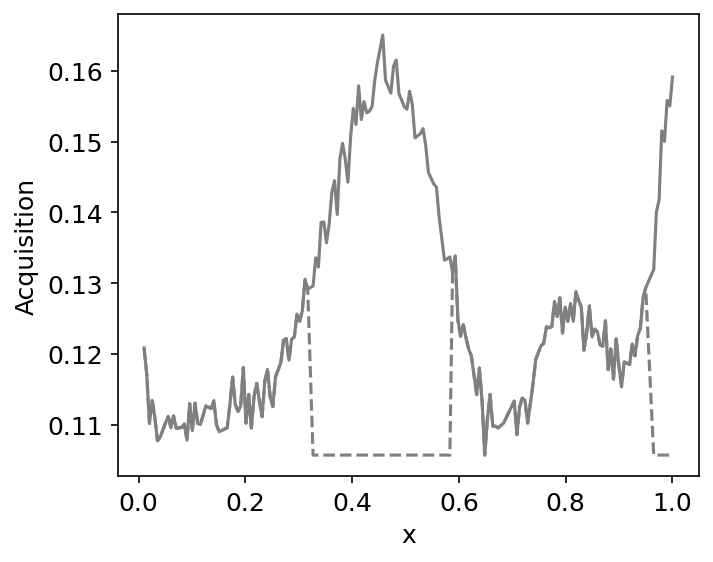

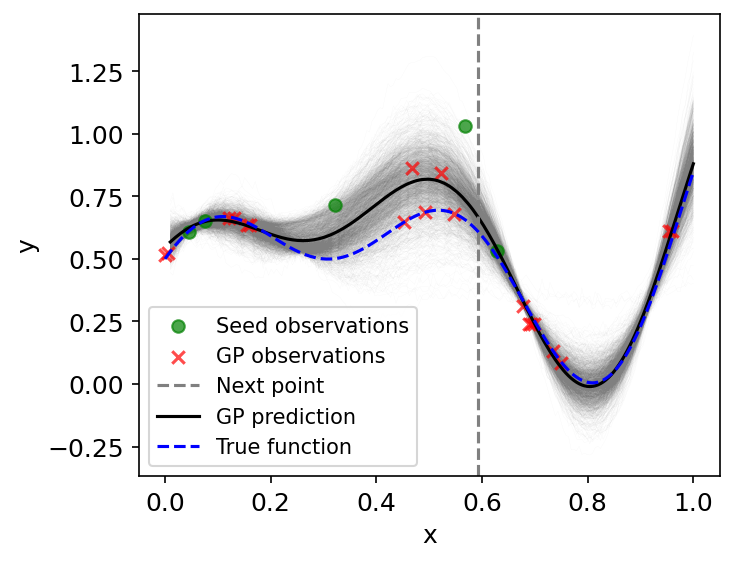


Exploration step 21


sample: 100%|██████████| 4000/4000 [00:18<00:00, 219.05it/s, 15 steps of size 3.08e-01. acc. prob=0.87]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.18      0.10      0.19      0.01      0.33    860.72      1.00
          b     -0.89      0.19     -0.91     -1.22     -0.61    711.55      1.00
          c      0.33      0.60      0.37     -0.64      1.32    992.98      1.01
k_length[0]      3.08      3.45      1.94      0.14      7.04    999.42      1.00
    k_scale      0.81      0.92      0.52      0.02      1.76   1262.51      1.00
      noise      0.01      0.01      0.01      0.00      0.02    454.17      1.00



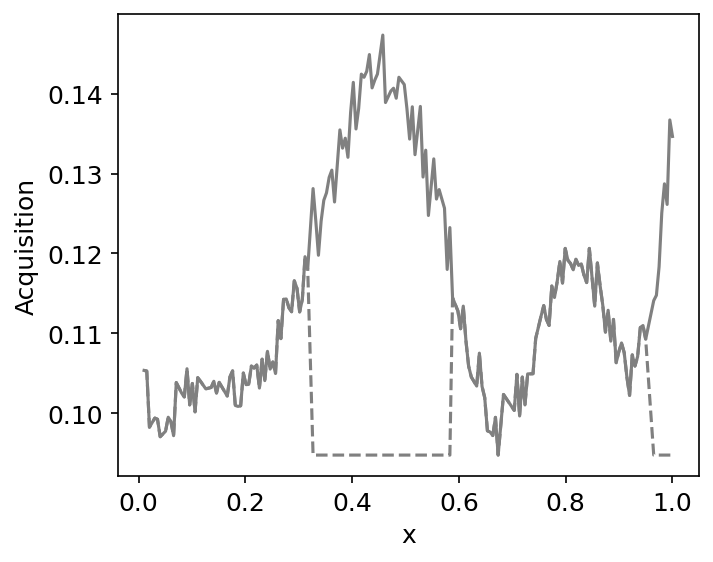

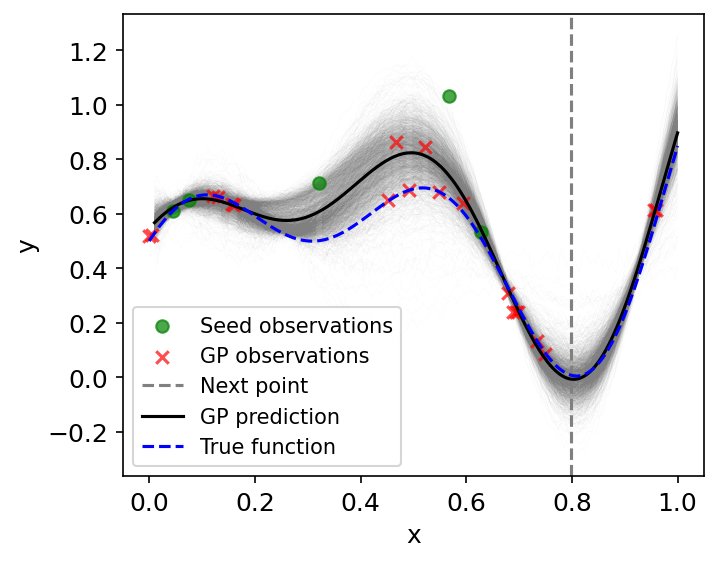


Exploration step 22


sample: 100%|██████████| 4000/4000 [00:15<00:00, 263.23it/s, 15 steps of size 2.52e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.18      0.11      0.19      0.02      0.34    597.54      1.00
          b     -0.87      0.20     -0.88     -1.18     -0.59    476.73      1.00
          c      0.27      0.60      0.31     -0.72      1.24   1031.58      1.00
k_length[0]      2.85      3.25      1.68      0.16      6.52   1206.91      1.00
    k_scale      0.85      1.09      0.53      0.02      1.83   1131.77      1.00
      noise      0.01      0.01      0.01      0.00      0.01   1029.46      1.00



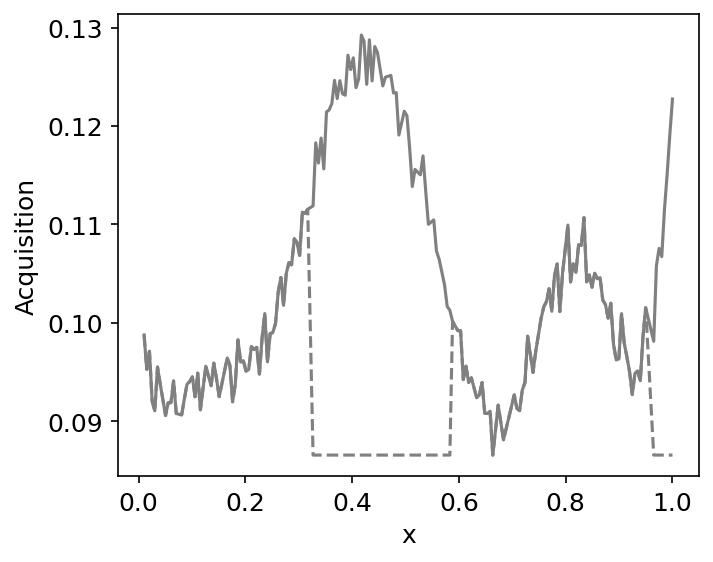

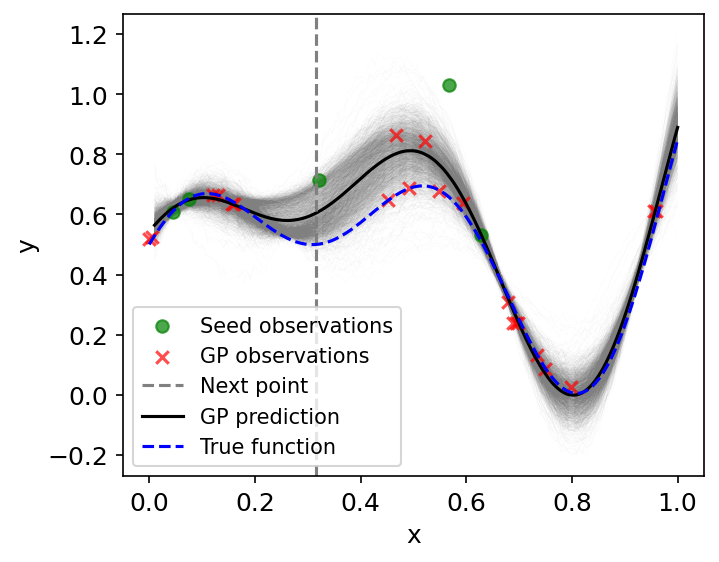


Exploration step 23


sample: 100%|██████████| 4000/4000 [00:19<00:00, 204.33it/s, 15 steps of size 2.42e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.09      0.17      0.03      0.31    672.18      1.01
          b     -0.84      0.16     -0.84     -1.09     -0.59    602.77      1.01
          c      0.31      0.59      0.37     -0.64      1.26    928.74      1.00
k_length[0]      2.53      3.06      1.31      0.25      5.91   1073.46      1.00
    k_scale      0.80      0.89      0.52      0.02      1.73   1422.86      1.00
      noise      0.01      0.00      0.00      0.00      0.01    809.37      1.00



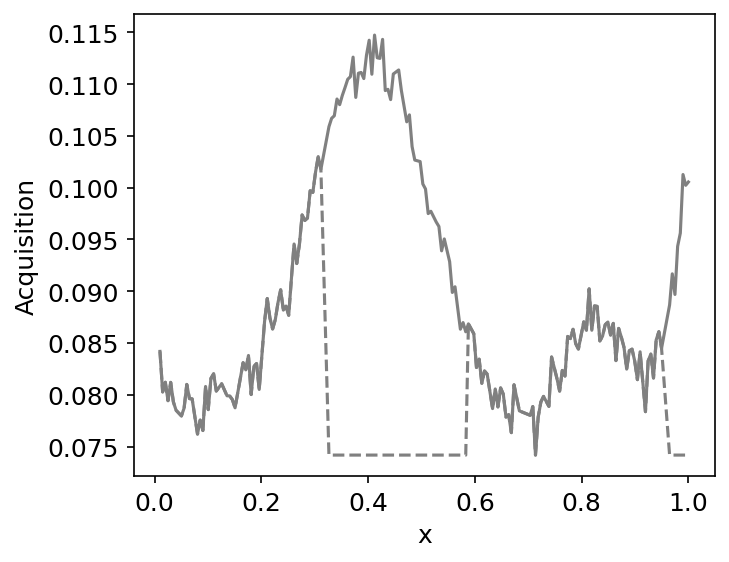

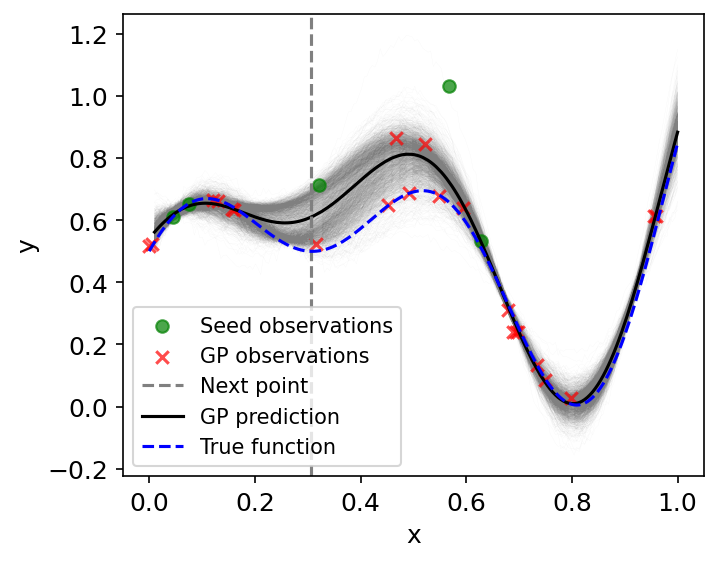


Exploration step 24


sample: 100%|██████████| 4000/4000 [00:14<00:00, 269.53it/s, 15 steps of size 3.01e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.22      0.07      0.22      0.11      0.34    900.57      1.00
          b     -0.93      0.14     -0.93     -1.15     -0.74    513.66      1.00
          c      0.33      0.58      0.35     -0.66      1.29   1379.48      1.00
k_length[0]      4.14      4.07      2.90      0.20      8.48   1179.99      1.00
    k_scale      0.78      0.97      0.50      0.03      1.69   1170.83      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1152.68      1.00



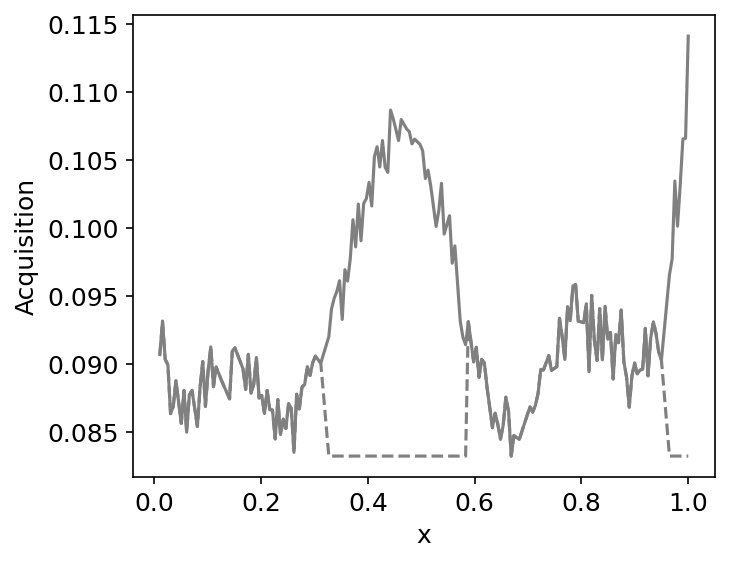

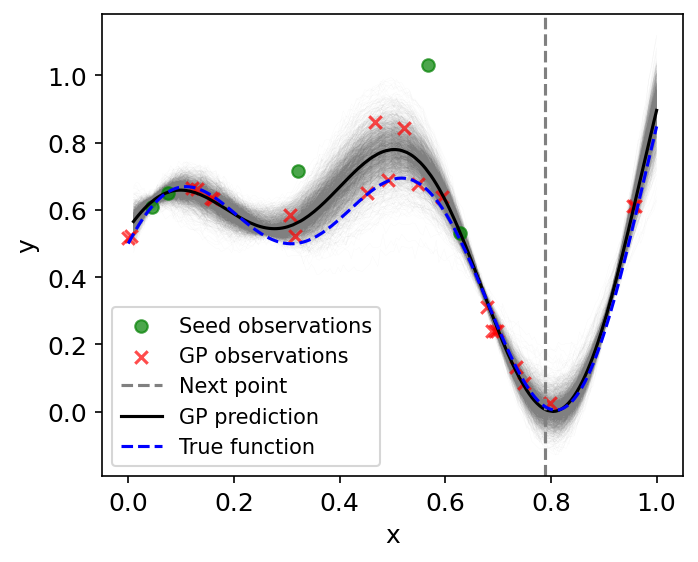


Exploration step 25


sample: 100%|██████████| 4000/4000 [00:14<00:00, 282.26it/s, 15 steps of size 3.97e-01. acc. prob=0.84]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.07      0.21      0.10      0.32    797.26      1.00
          b     -0.91      0.13     -0.92     -1.12     -0.73    779.81      1.00
          c      0.31      0.57      0.34     -0.66      1.15    919.80      1.00
k_length[0]      3.92      3.90      2.77      0.35      7.88   1369.84      1.01
    k_scale      0.79      0.88      0.51      0.02      1.73   1056.92      1.00
      noise      0.01      0.00      0.00      0.00      0.01    839.54      1.00



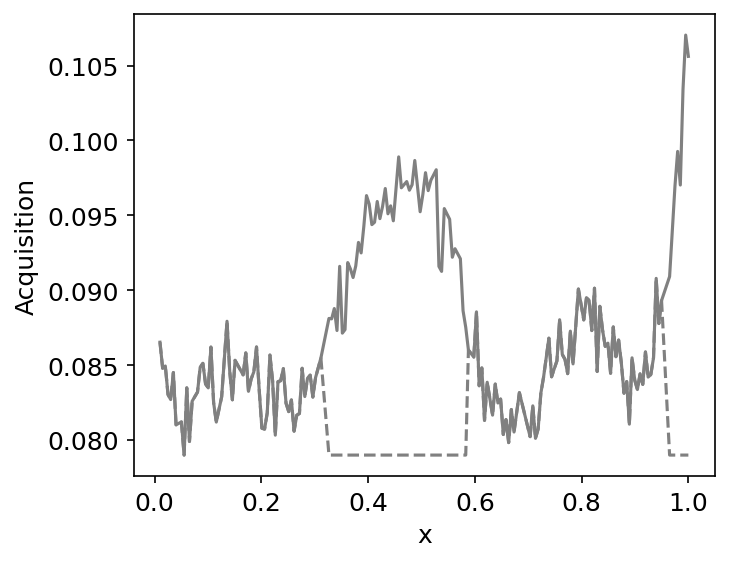

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


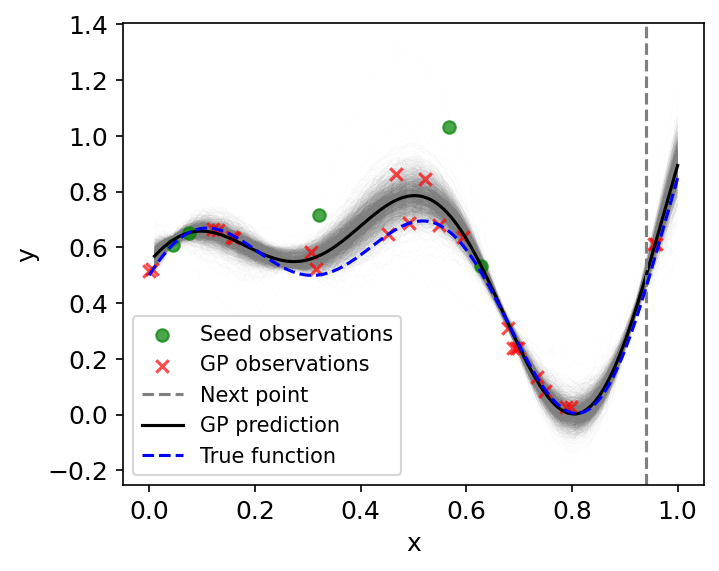


Exploration step 26


sample: 100%|██████████| 4000/4000 [00:18<00:00, 220.67it/s, 7 steps of size 3.58e-01. acc. prob=0.87] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.07      0.21      0.11      0.31    732.75      1.00
          b     -0.91      0.12     -0.91     -1.09     -0.73    655.58      1.00
          c      0.30      0.59      0.34     -0.60      1.30   1001.69      1.00
k_length[0]      3.89      4.15      2.62      0.28      8.07   1178.95      1.00
    k_scale      0.77      0.85      0.52      0.04      1.70   1157.88      1.00
      noise      0.01      0.00      0.00      0.00      0.01    852.92      1.00



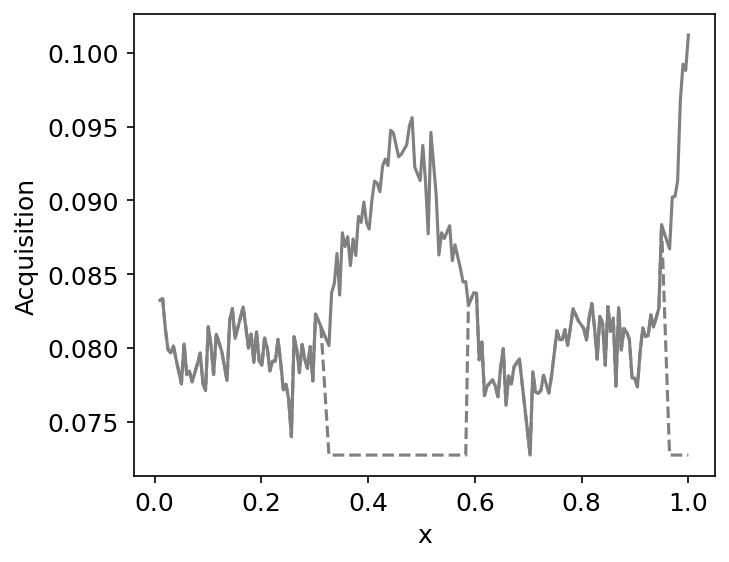

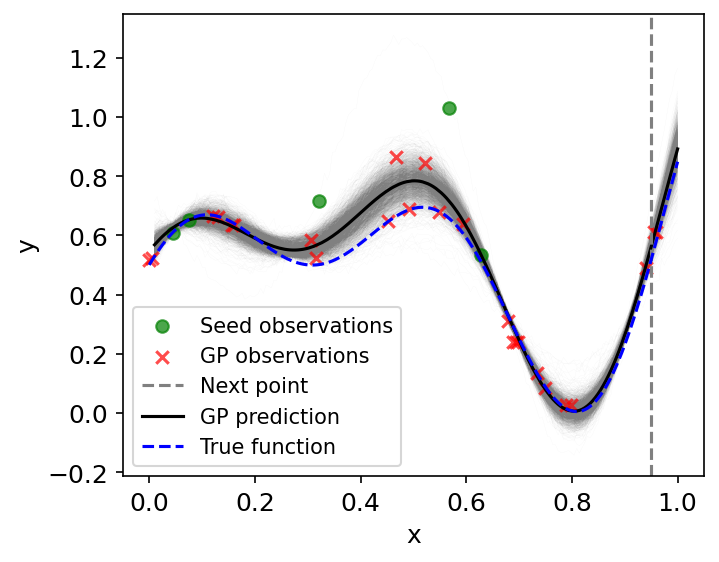


Exploration step 27


sample: 100%|██████████| 4000/4000 [00:15<00:00, 259.86it/s, 15 steps of size 3.50e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.21      0.06      0.21      0.11      0.30   1088.22      1.00
          b     -0.91      0.10     -0.91     -1.08     -0.74   1102.64      1.00
          c      0.32      0.58      0.36     -0.70      1.23    928.01      1.00
k_length[0]      3.93      3.96      2.68      0.37      7.86   1131.30      1.00
    k_scale      0.76      0.84      0.49      0.04      1.72   1443.38      1.00
      noise      0.00      0.00      0.00      0.00      0.01    991.00      1.00



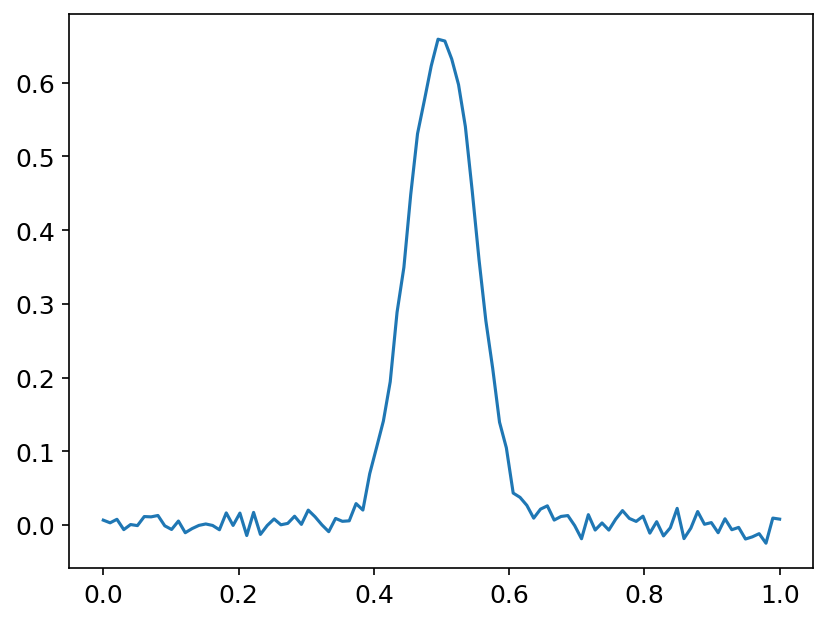

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


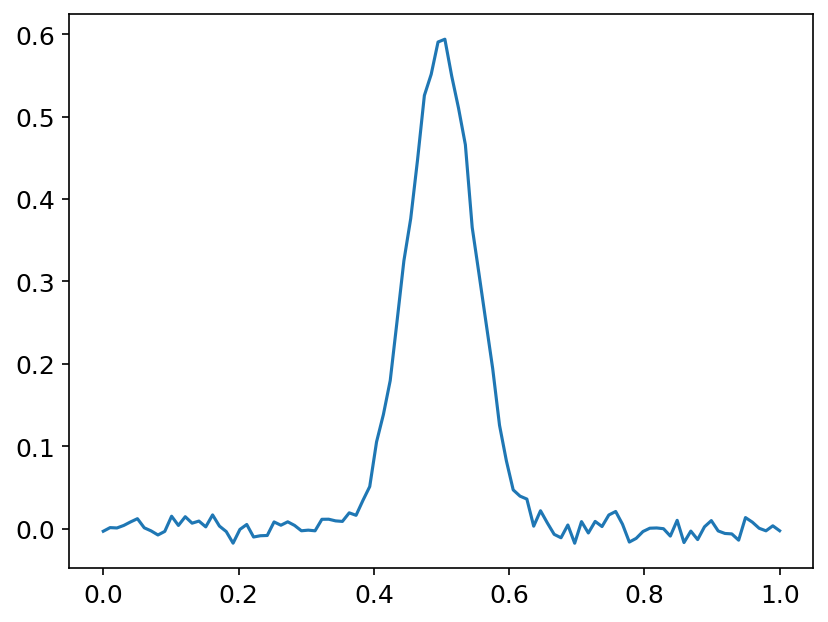

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


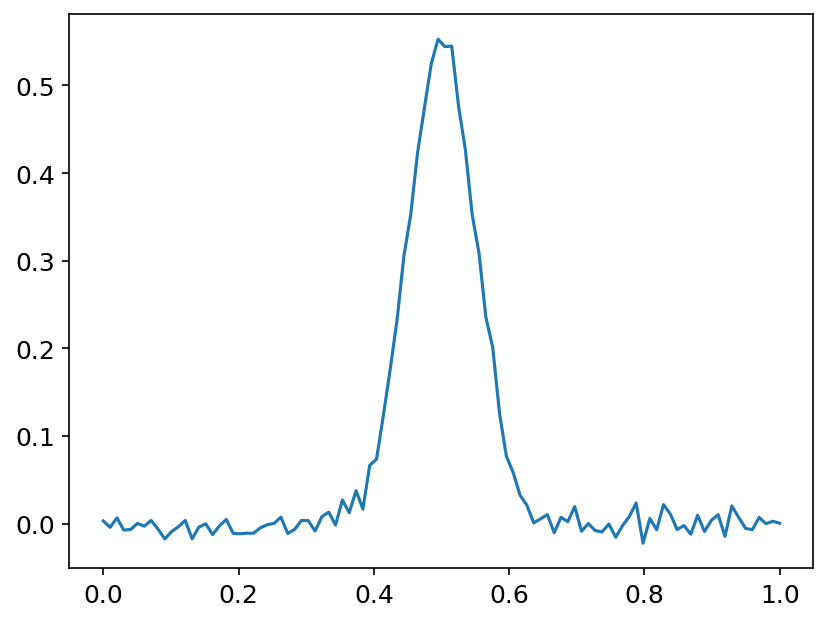

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


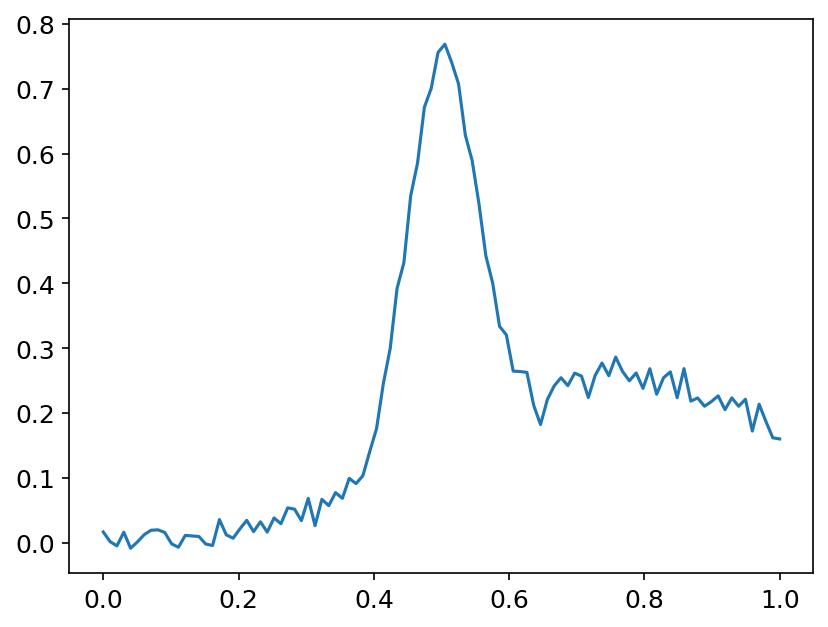

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
2


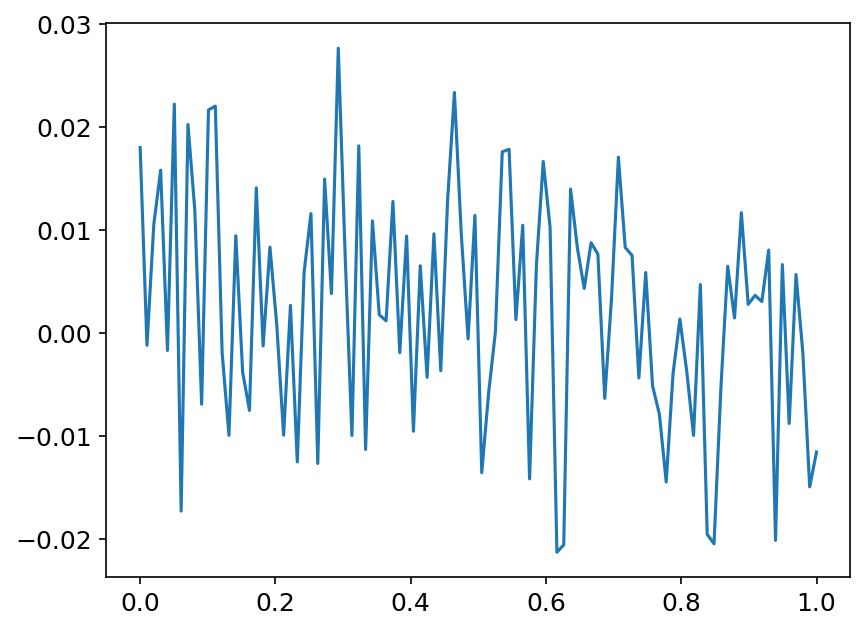

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
4


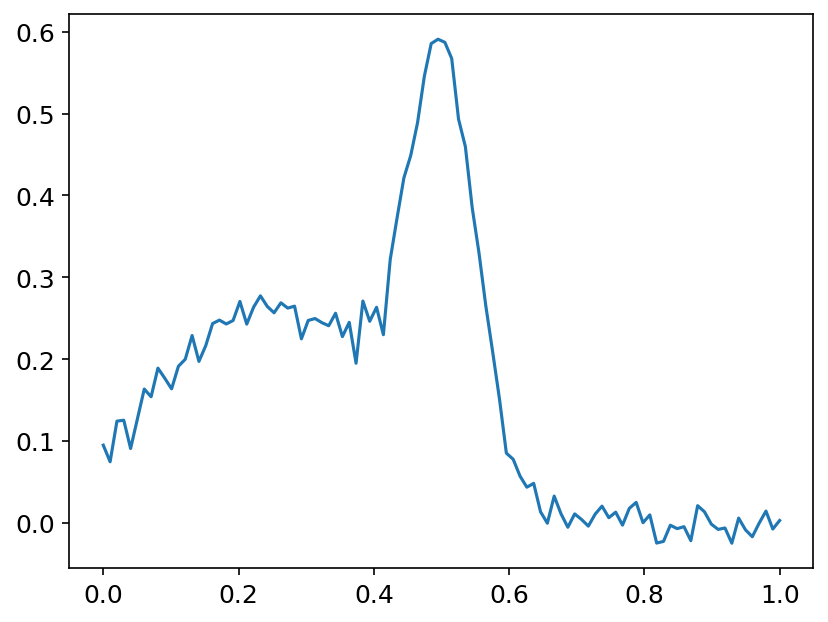

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
1


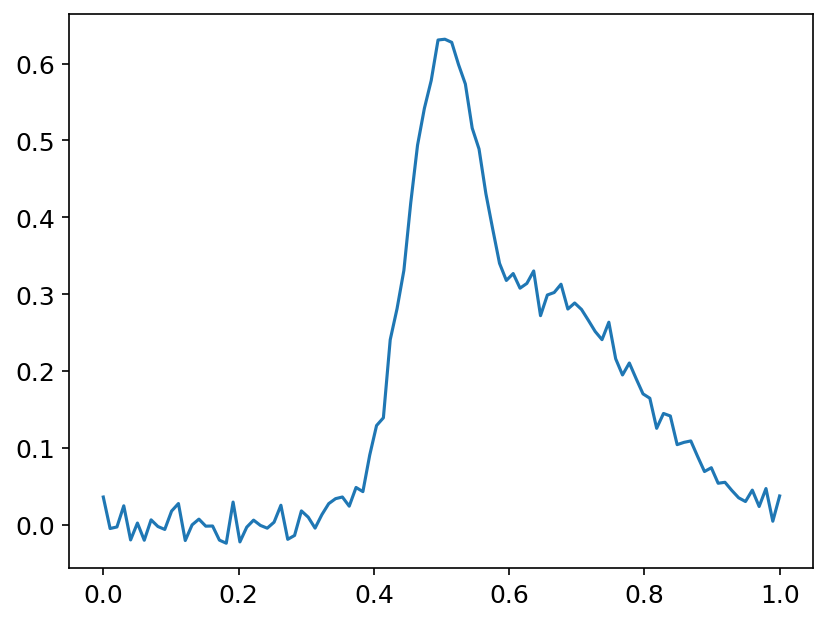

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
1


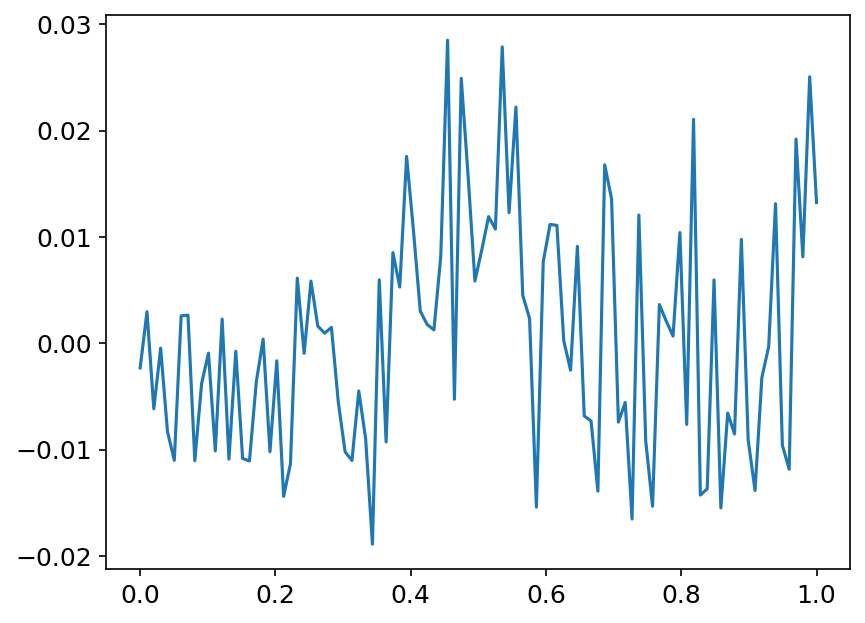

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
4


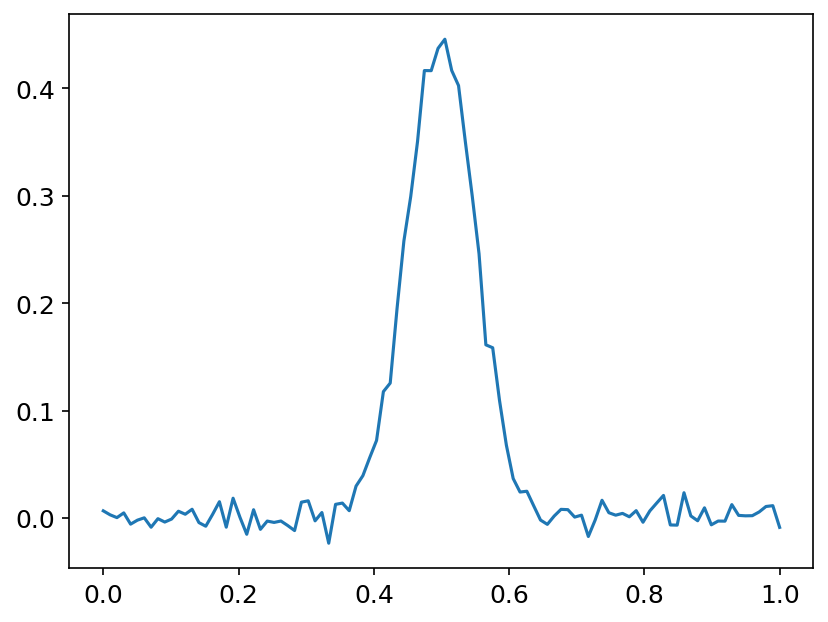

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


sample: 100%|██████████| 4000/4000 [00:26<00:00, 153.29it/s, 7 steps of size 4.05e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.00      1.59      0.54      0.08      2.04    788.55      1.00
    k_scale      1.19      1.15      0.86      0.13      2.41    687.61      1.00
      noise      0.12      0.04      0.11      0.05      0.18    857.66      1.00



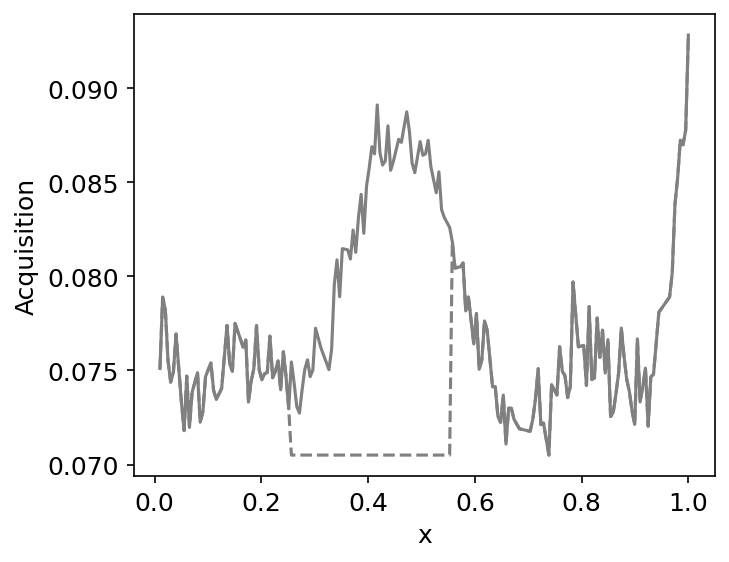

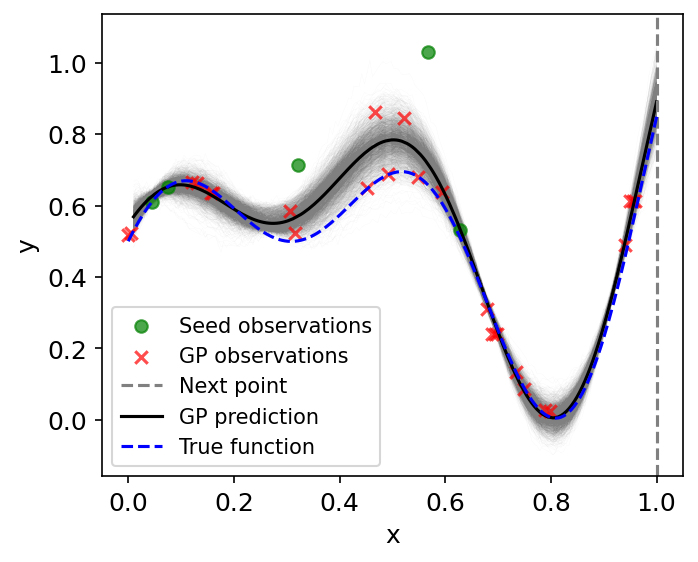


Exploration step 28


sample: 100%|██████████| 4000/4000 [00:16<00:00, 248.51it/s, 15 steps of size 2.44e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.14      0.18     -0.02      0.37    287.24      1.00
          b     -0.93      0.23     -0.96     -1.27     -0.64    241.85      1.00
          c      0.30      0.57      0.33     -0.61      1.21   1040.48      1.00
k_length[0]      3.36      3.55      2.37      0.14      7.10   1239.87      1.00
    k_scale      0.83      0.97      0.53      0.03      1.86   1414.05      1.00
      noise      0.01      0.01      0.01      0.00      0.02   1183.30      1.00



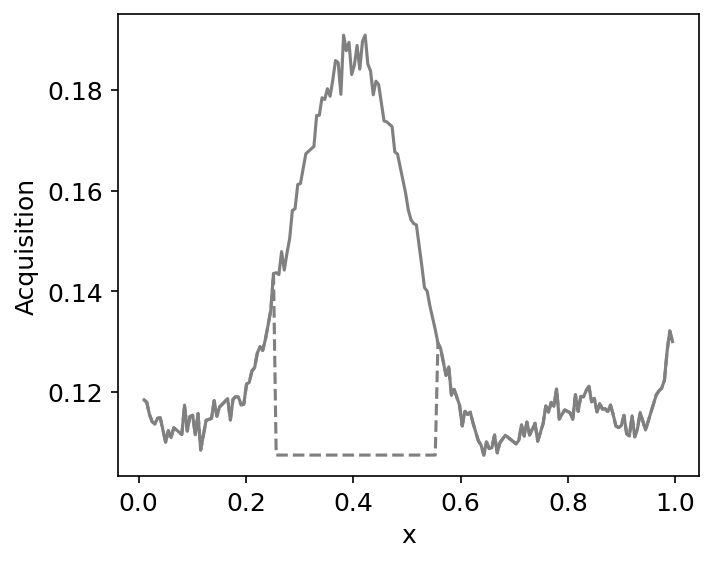

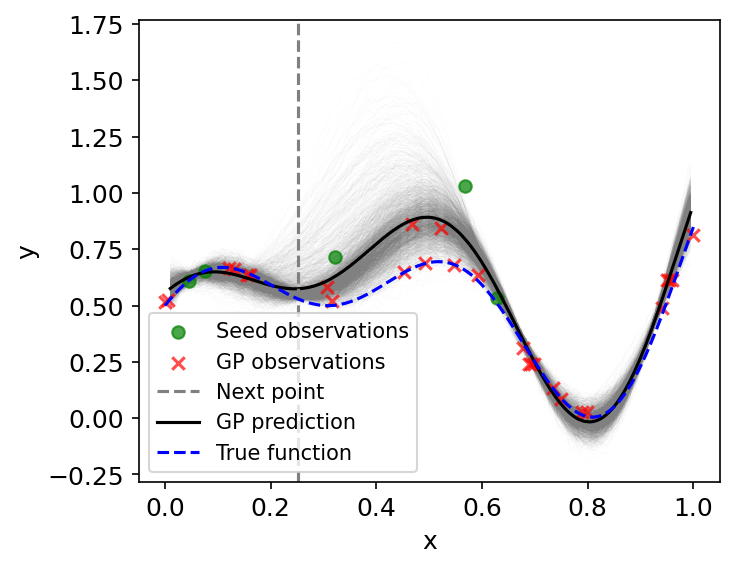


Exploration step 29


sample: 100%|██████████| 4000/4000 [00:16<00:00, 241.80it/s, 15 steps of size 2.20e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.13      0.15      0.15     -0.07      0.34    299.69      1.00
          b     -0.85      0.25     -0.88     -1.16     -0.55    242.71      1.00
          c      0.24      0.59      0.28     -0.72      1.21   1111.65      1.00
k_length[0]      2.90      3.39      2.02      0.19      5.99    880.65      1.00
    k_scale      0.83      1.06      0.55      0.03      1.74   1434.65      1.00
      noise      0.01      0.01      0.01      0.00      0.02   1033.24      1.00



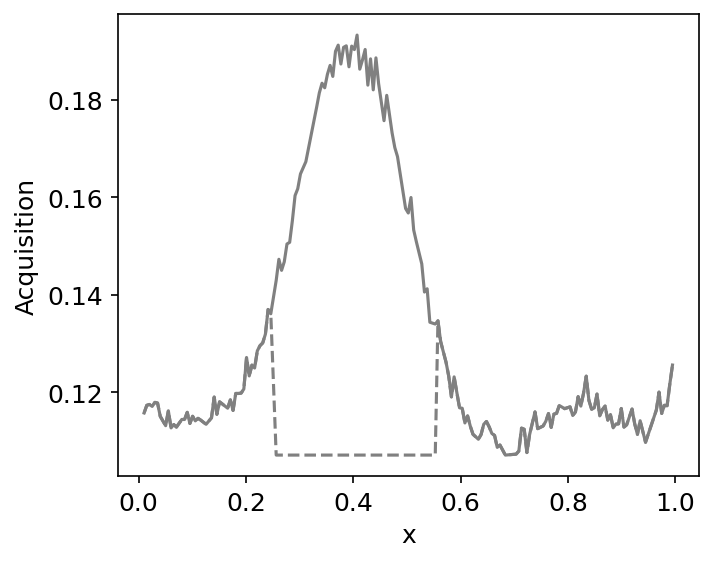

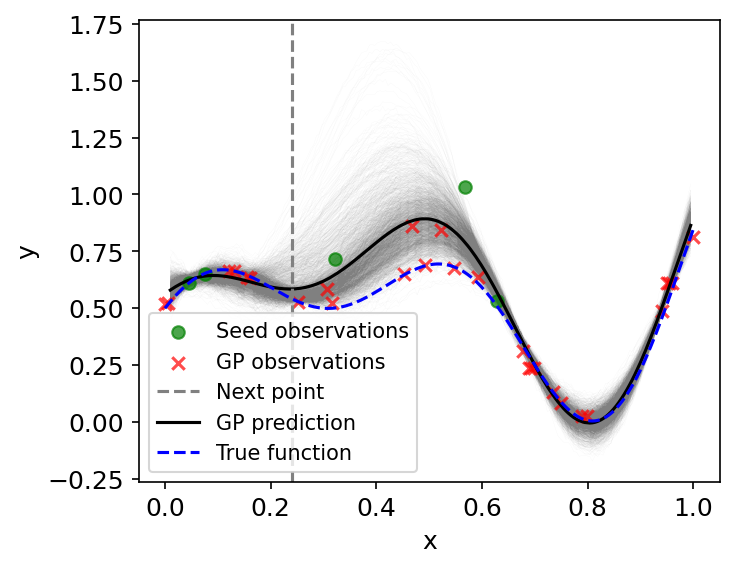


Exploration step 30


sample: 100%|██████████| 4000/4000 [00:15<00:00, 258.46it/s, 15 steps of size 2.61e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.10      0.17      0.02      0.33   1478.94      1.00
          b     -0.90      0.15     -0.91     -1.14     -0.66   1474.34      1.00
          c      0.26      0.57      0.31     -0.71      1.17   1329.68      1.00
k_length[0]      3.55      3.70      2.42      0.26      7.28   1307.52      1.00
    k_scale      0.83      0.95      0.55      0.03      1.78   1377.84      1.00
      noise      0.01      0.00      0.01      0.00      0.02   1330.99      1.00



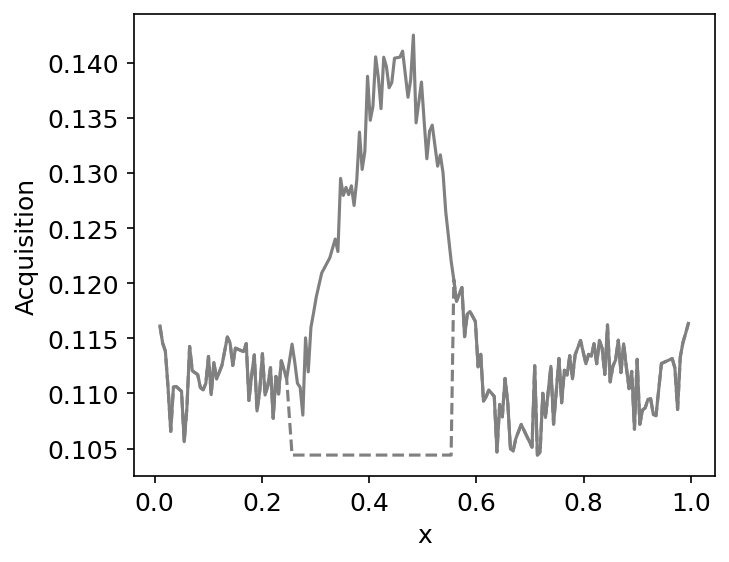

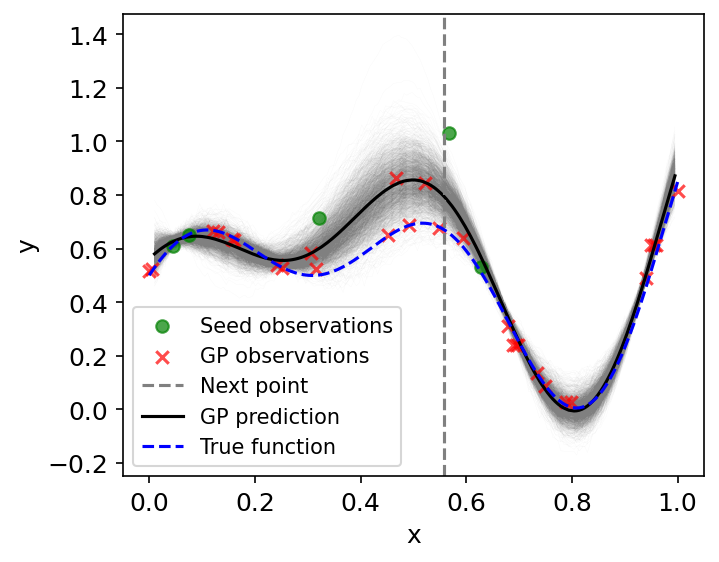


Exploration step 31


sample: 100%|██████████| 4000/4000 [00:16<00:00, 235.79it/s, 15 steps of size 2.43e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.09      0.17      0.01      0.31   1058.42      1.00
          b     -0.90      0.14     -0.91     -1.13     -0.69    952.77      1.00
          c      0.28      0.58      0.32     -0.62      1.25   1459.51      1.00
k_length[0]      3.65      3.63      2.55      0.14      7.29    917.51      1.00
    k_scale      0.81      0.92      0.52      0.03      1.75   1383.44      1.00
      noise      0.01      0.00      0.01      0.00      0.02   1393.83      1.00



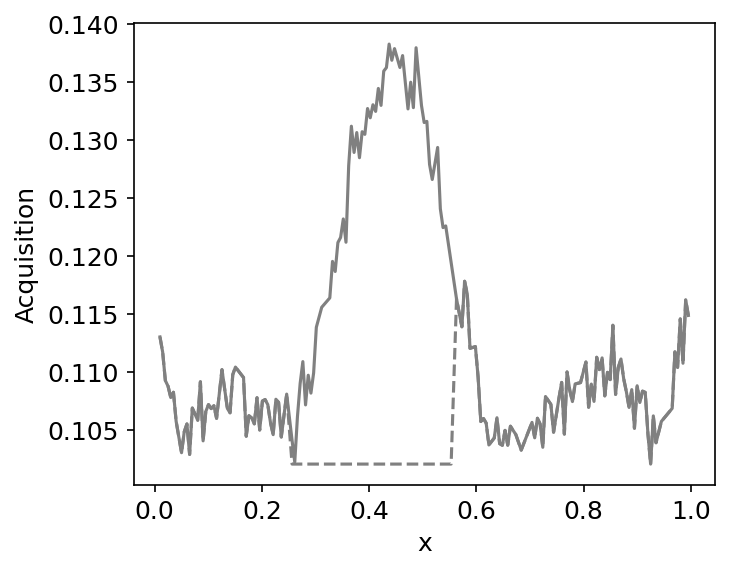

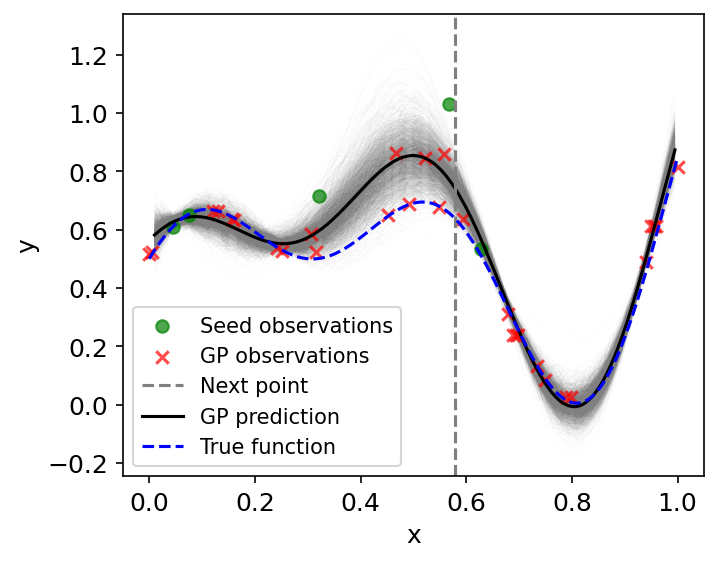


Exploration step 32


sample: 100%|██████████| 4000/4000 [00:16<00:00, 235.65it/s, 15 steps of size 2.78e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.16      0.09      0.16      0.02      0.30   1164.41      1.00
          b     -0.90      0.14     -0.91     -1.10     -0.67   1223.68      1.00
          c      0.26      0.58      0.28     -0.68      1.21   1391.45      1.00
k_length[0]      3.30      3.16      2.32      0.27      6.77   1247.06      1.00
    k_scale      0.81      0.89      0.54      0.05      1.78   1560.71      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1289.19      1.00



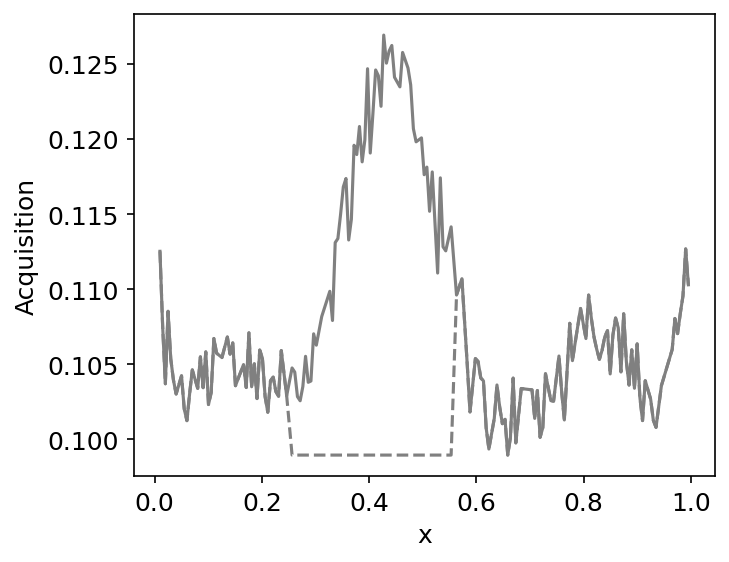

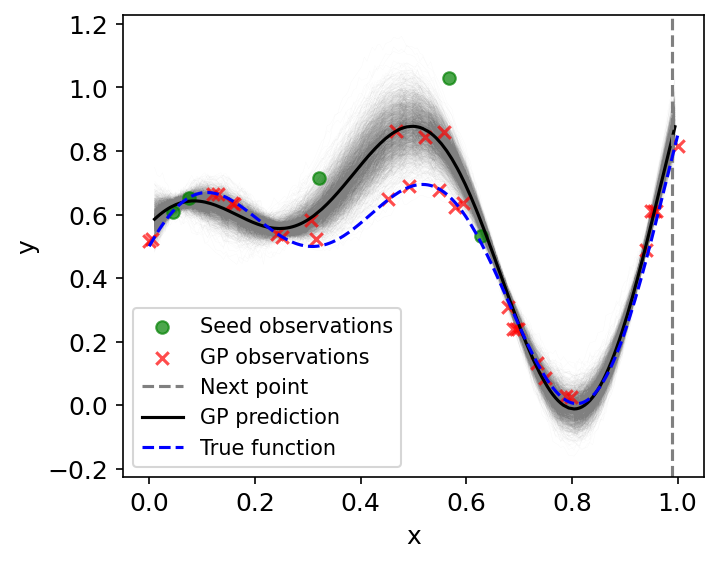


Exploration step 33


sample: 100%|██████████| 4000/4000 [00:17<00:00, 226.49it/s, 7 steps of size 2.87e-01. acc. prob=0.89] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.18      0.09      0.18      0.02      0.31   1400.56      1.00
          b     -0.91      0.13     -0.92     -1.13     -0.70   1629.11      1.00
          c      0.28      0.59      0.30     -0.73      1.23   1347.95      1.00
k_length[0]      3.76      3.30      2.72      0.30      7.40   1353.05      1.00
    k_scale      0.84      0.98      0.53      0.04      1.81   1087.99      1.00
      noise      0.01      0.00      0.01      0.00      0.02   1530.86      1.00



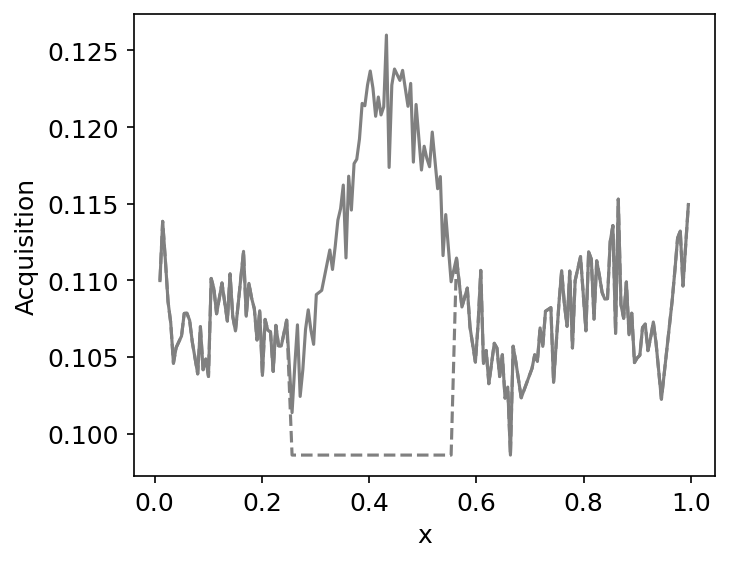

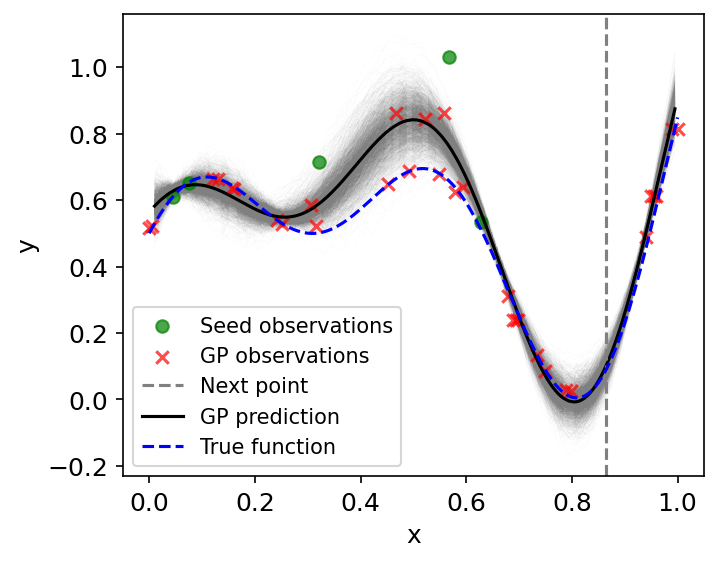


Exploration step 34


sample: 100%|██████████| 4000/4000 [00:16<00:00, 239.83it/s, 15 steps of size 2.33e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.08      0.17      0.05      0.31    813.29      1.00
          b     -0.90      0.13     -0.90     -1.09     -0.69    650.52      1.00
          c      0.28      0.61      0.34     -0.68      1.28   1245.80      1.00
k_length[0]      3.87      3.90      2.73      0.20      7.52    951.19      1.00
    k_scale      0.84      1.02      0.54      0.03      1.82   1530.93      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1387.49      1.00



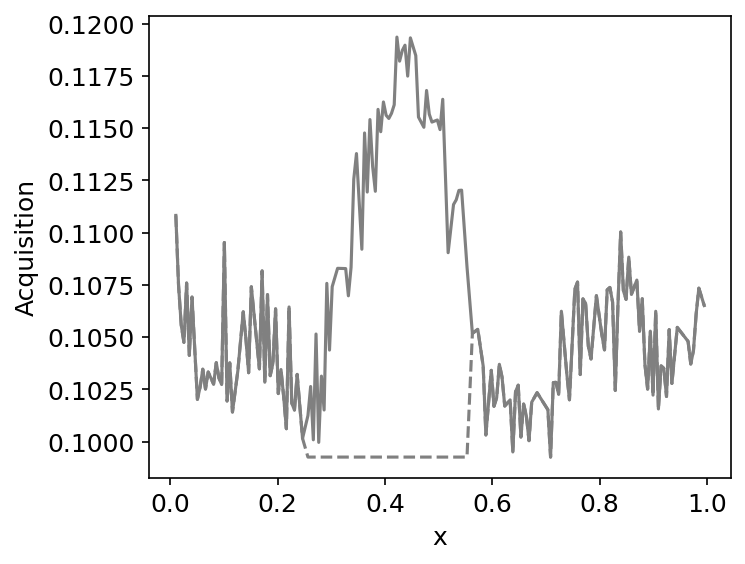

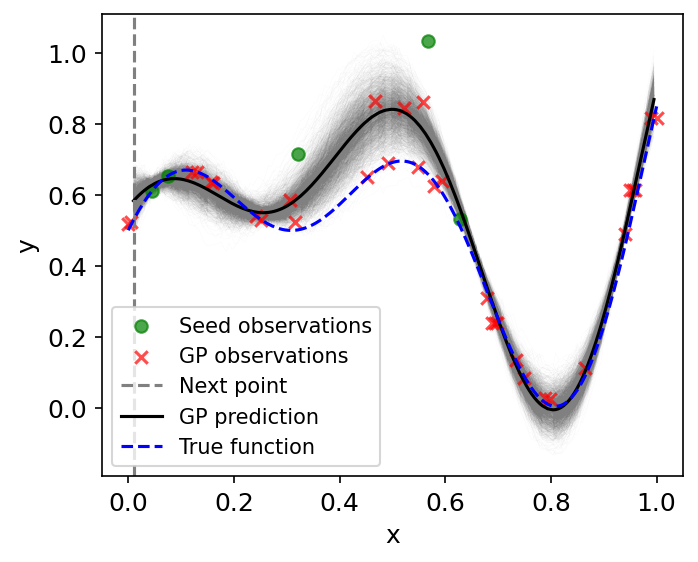


Exploration step 35


sample: 100%|██████████| 4000/4000 [00:17<00:00, 230.38it/s, 15 steps of size 2.68e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.17      0.08      0.18      0.05      0.30   1363.58      1.00
          b     -0.90      0.12     -0.90     -1.09     -0.70   1268.44      1.00
          c      0.26      0.59      0.28     -0.72      1.20   1367.39      1.00
k_length[0]      3.74      3.51      2.69      0.41      7.44   1044.27      1.00
    k_scale      0.81      0.89      0.54      0.03      1.75   1184.36      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1428.32      1.00



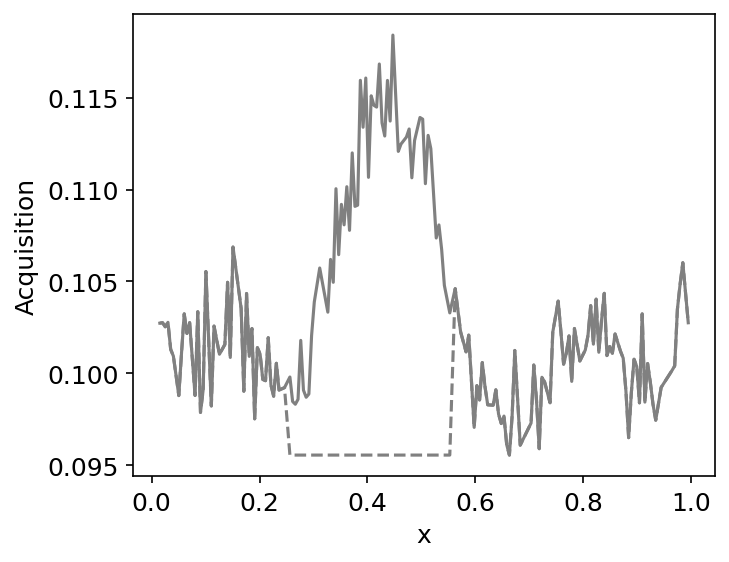

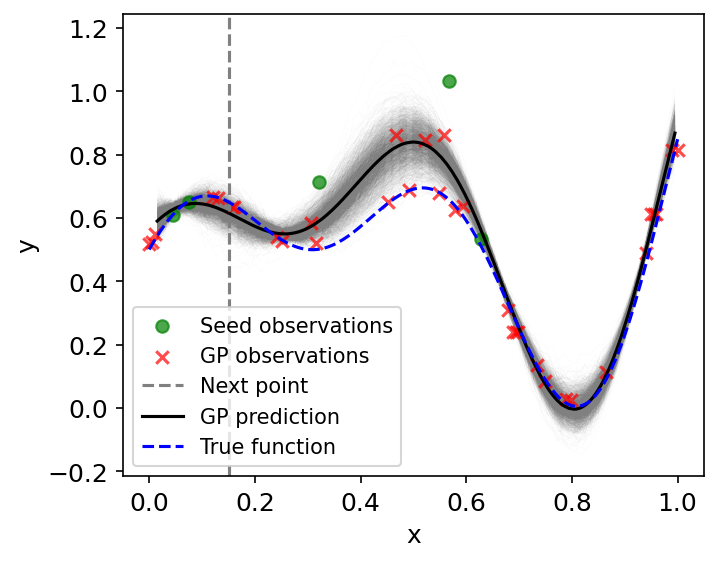


Exploration step 36


sample: 100%|██████████| 4000/4000 [00:17<00:00, 225.43it/s, 15 steps of size 2.88e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.18      0.08      0.18      0.04      0.29   1394.41      1.00
          b     -0.91      0.12     -0.91     -1.09     -0.72   1118.37      1.00
          c      0.25      0.60      0.28     -0.73      1.24   1104.73      1.00
k_length[0]      3.68      3.32      2.63      0.19      7.49   1307.15      1.00
    k_scale      0.83      1.05      0.54      0.05      1.79    989.50      1.00
      noise      0.01      0.00      0.01      0.00      0.01   1474.90      1.00



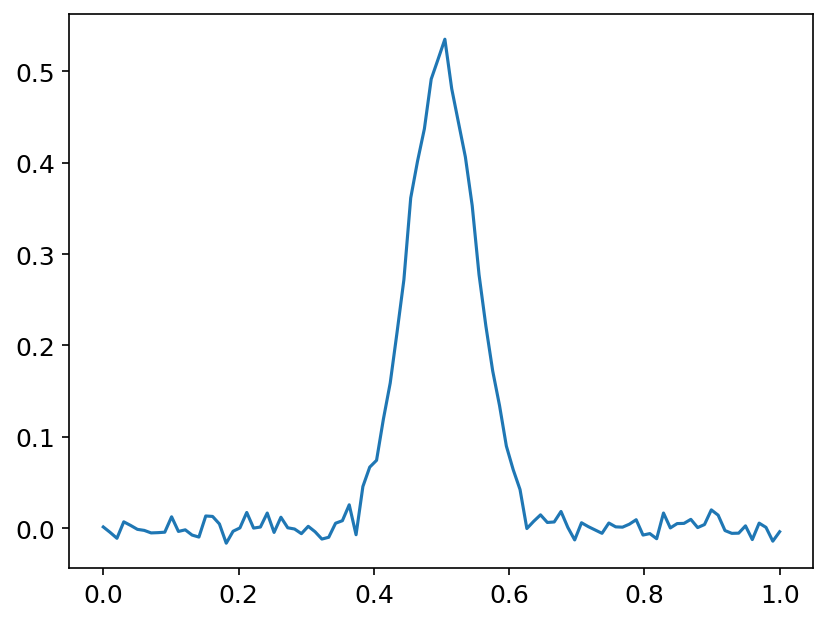

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


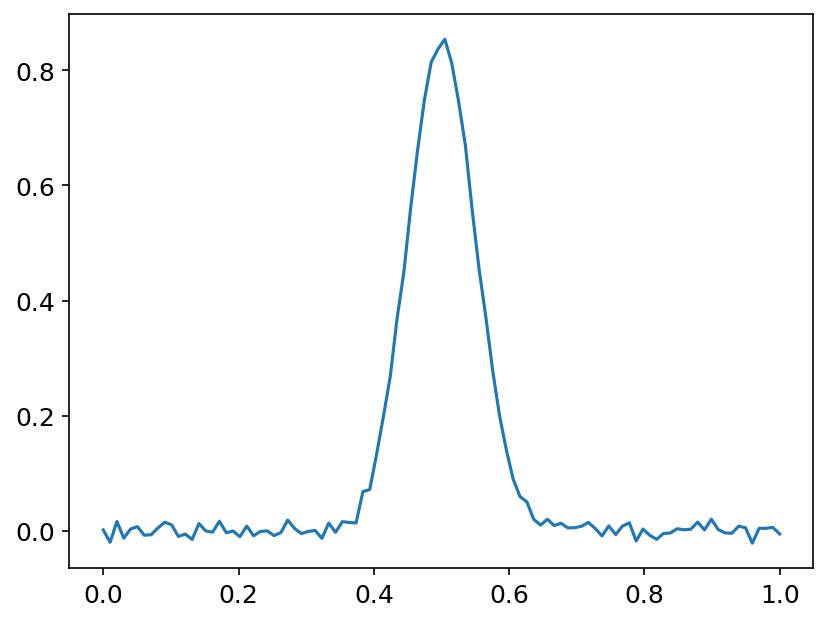

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


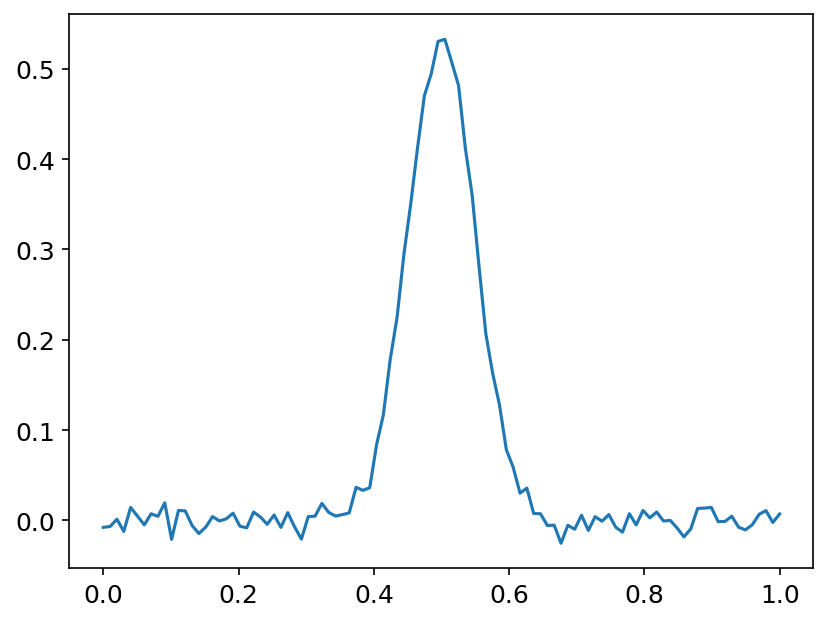

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


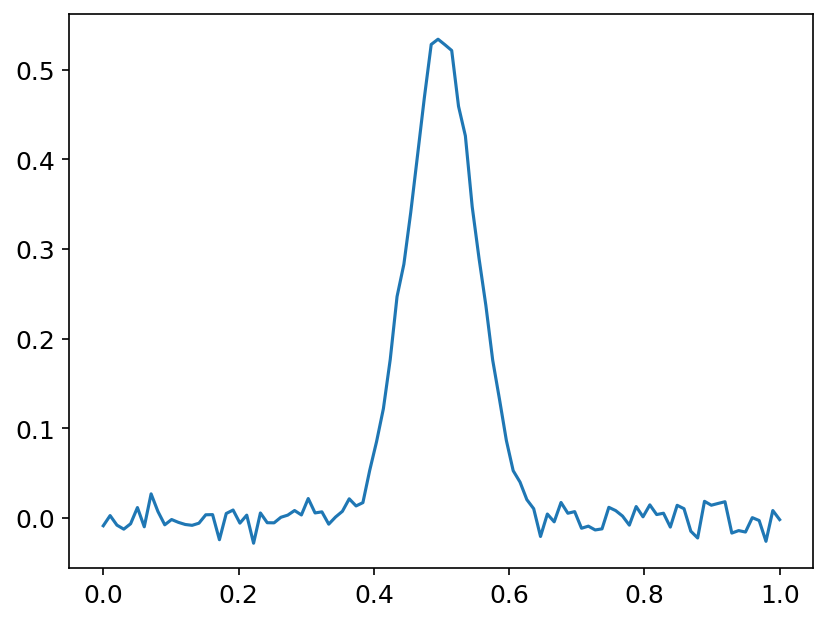

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
8


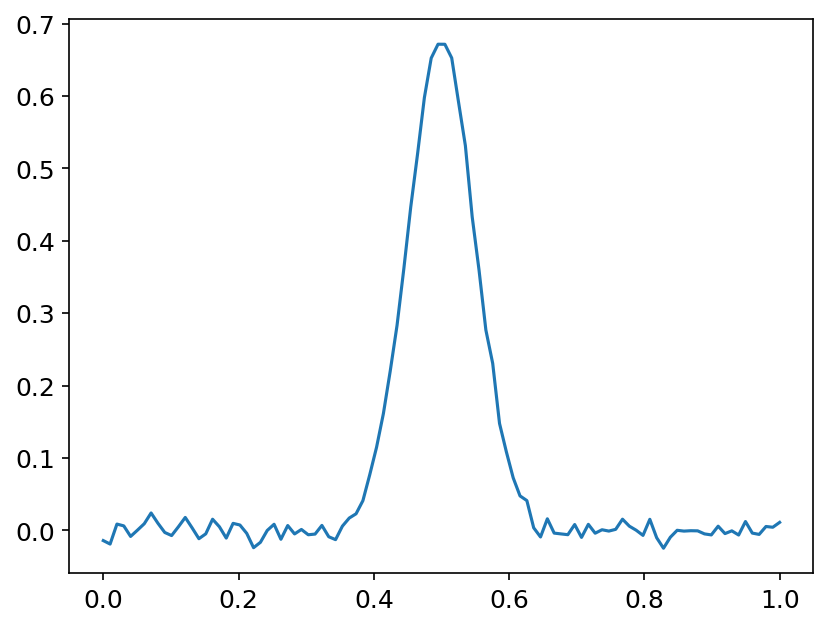

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


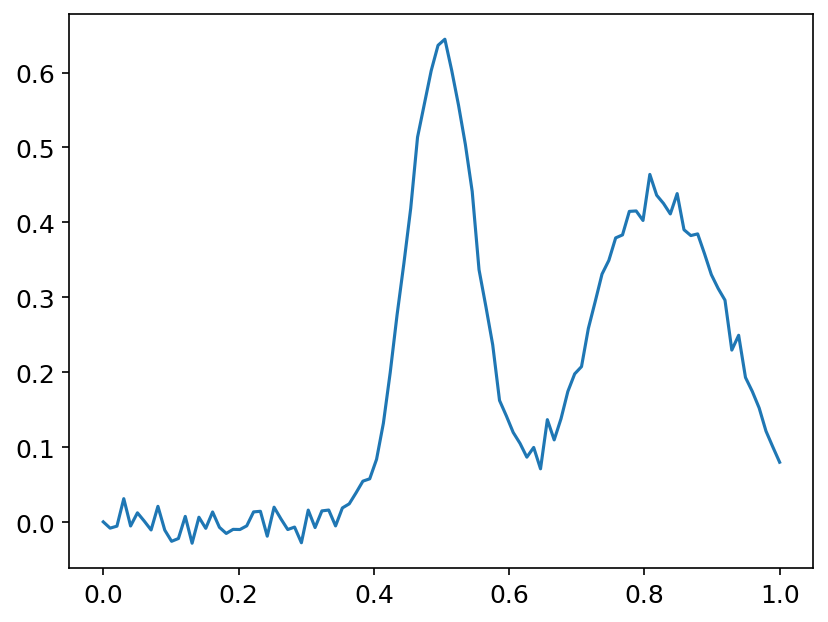

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
1


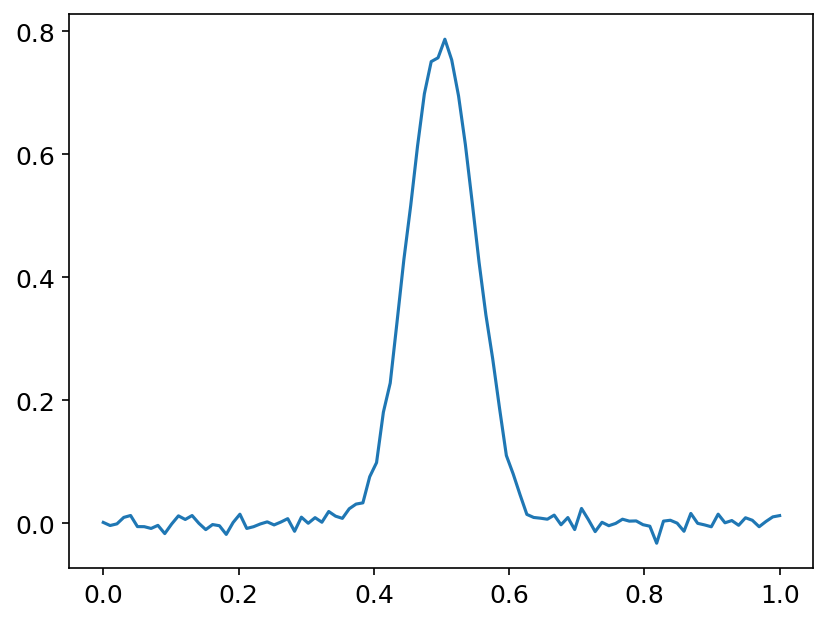

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


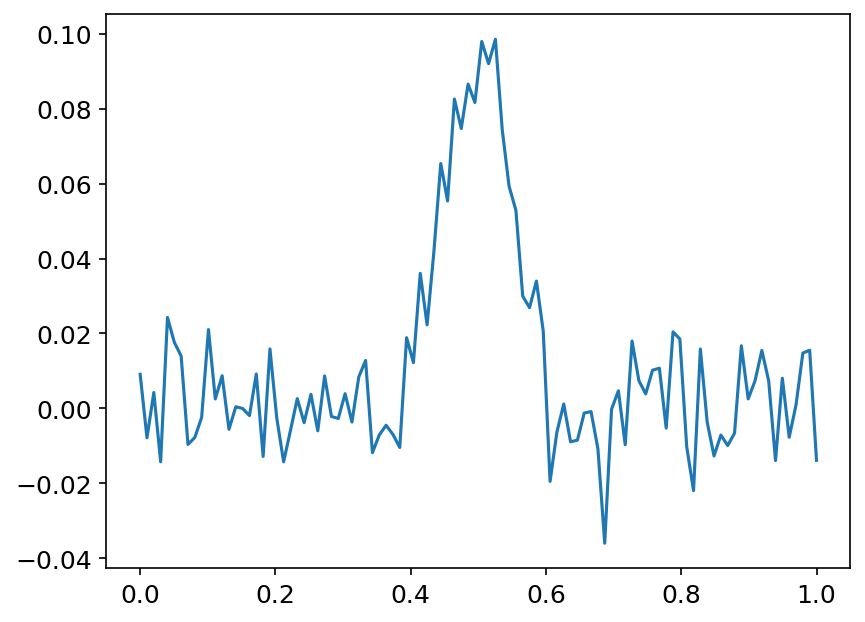

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
7


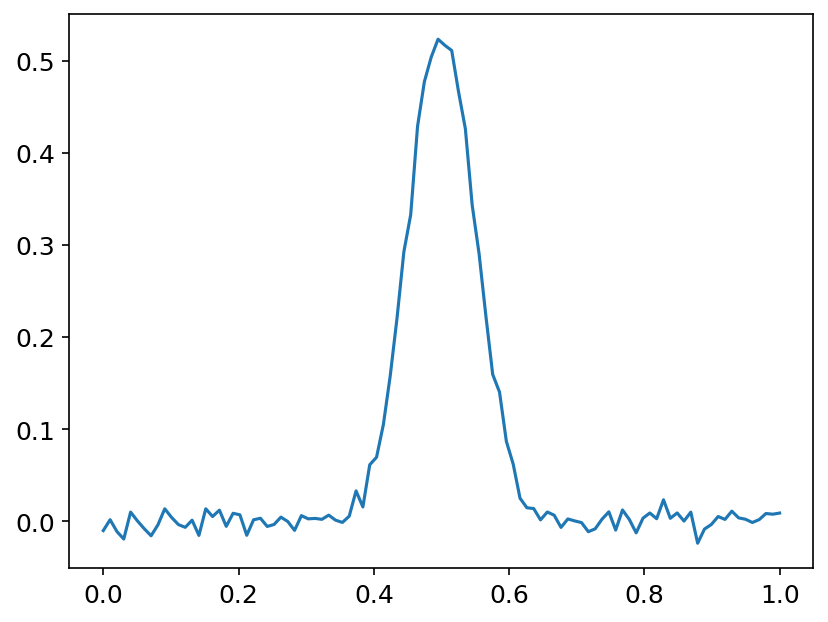

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


sample: 100%|██████████| 4000/4000 [00:23<00:00, 171.03it/s, 7 steps of size 6.21e-01. acc. prob=0.88]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      1.02      1.94      0.72      0.09      1.61    725.67      1.00
    k_scale      1.33      1.18      1.00      0.19      2.63    889.03      1.00
      noise      0.12      0.03      0.11      0.06      0.16   1242.17      1.00



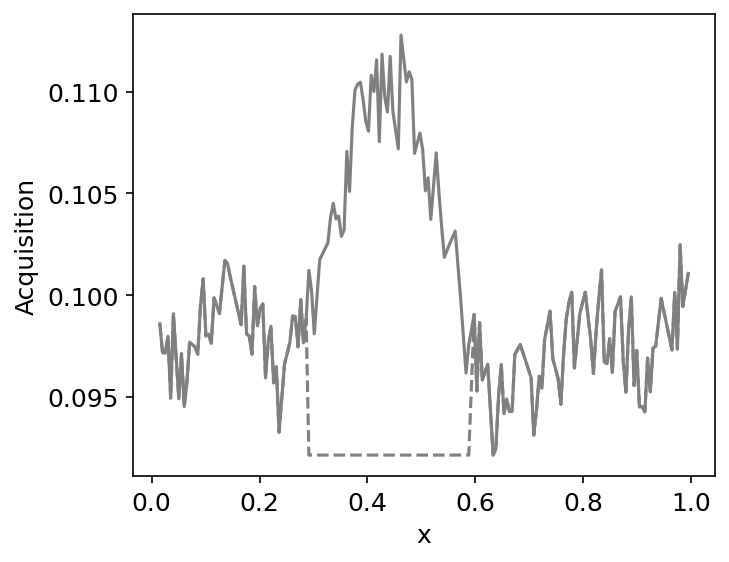

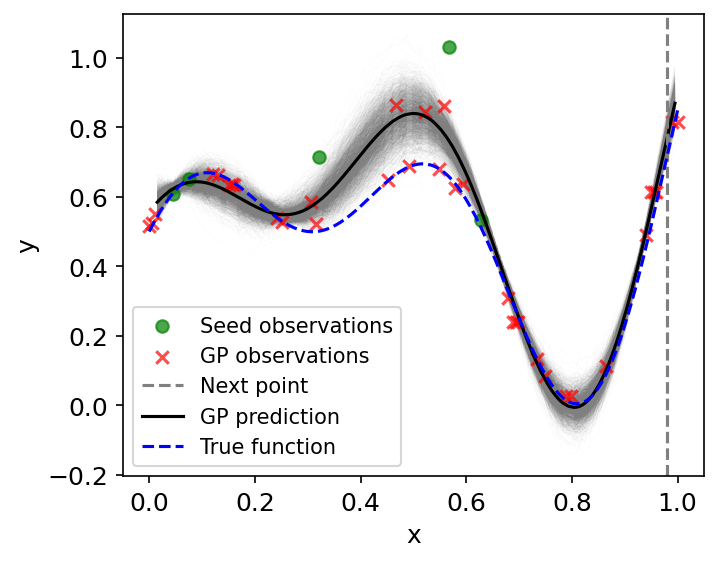


Exploration step 37


sample: 100%|██████████| 4000/4000 [00:23<00:00, 172.97it/s, 7 steps of size 3.81e-01. acc. prob=0.88] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.26      0.03      0.26      0.21      0.31   1018.35      1.00
          b     -0.95      0.04     -0.95     -1.01     -0.87   1008.62      1.00
          c      0.33      0.58      0.37     -0.58      1.31   1103.83      1.00
k_length[0]      6.42      5.94      4.69      0.78     13.17   1013.19      1.00
    k_scale      0.71      0.84      0.44      0.03      1.54   1316.20      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1212.18      1.00



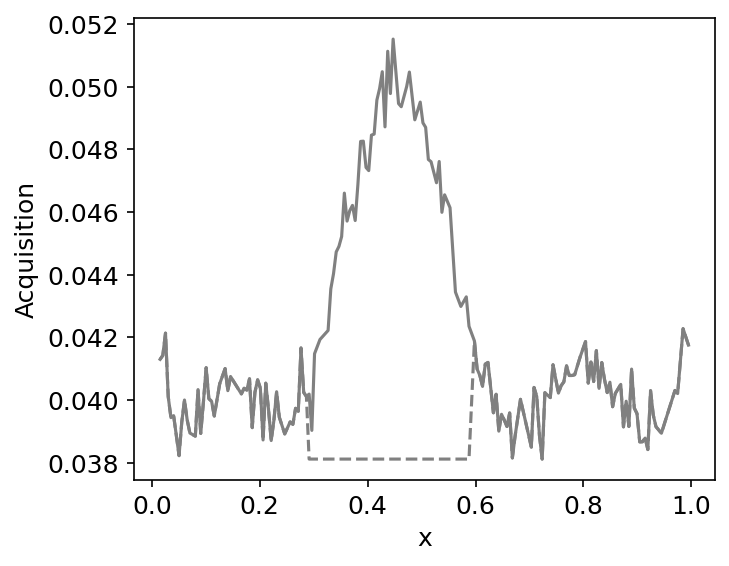

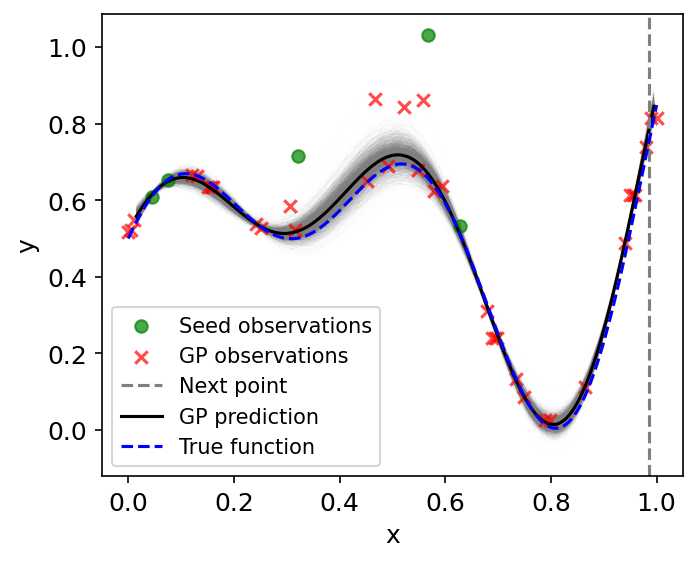


Exploration step 38


sample: 100%|██████████| 4000/4000 [00:21<00:00, 185.57it/s, 15 steps of size 2.89e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.26      0.03      0.26      0.21      0.31   1487.14      1.00
          b     -0.95      0.04     -0.95     -1.02     -0.88   1514.52      1.00
          c      0.37      0.54      0.39     -0.57      1.23   1833.15      1.00
k_length[0]      6.52      5.55      4.83      0.66     13.39   1422.48      1.00
    k_scale      0.69      0.80      0.44      0.02      1.46   1467.92      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1153.10      1.00



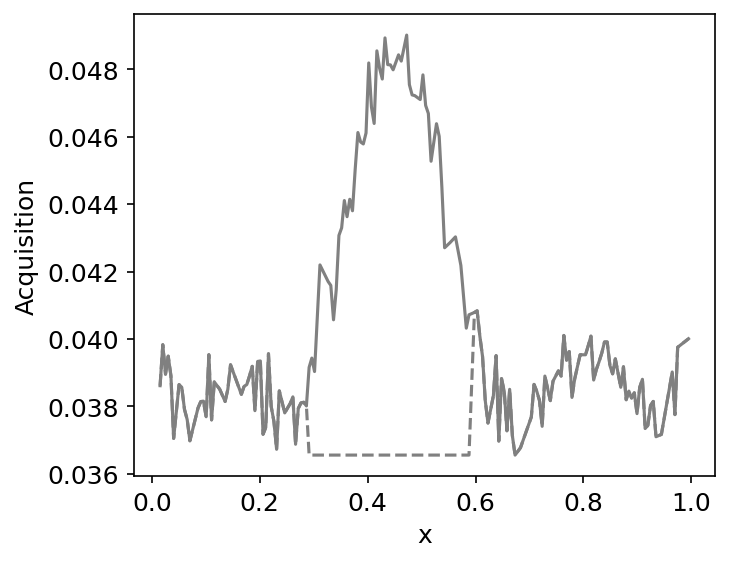

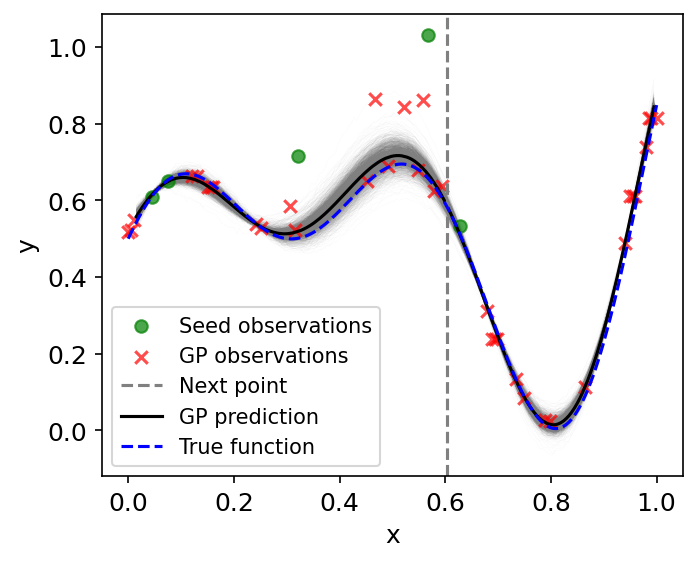


Exploration step 39


sample: 100%|██████████| 4000/4000 [00:19<00:00, 207.46it/s, 15 steps of size 2.98e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.26      0.03      0.26      0.21      0.31   1297.77      1.00
          b     -0.95      0.04     -0.95     -1.02     -0.88   1142.68      1.00
          c      0.34      0.57      0.37     -0.60      1.26   1323.74      1.00
k_length[0]      6.54      5.74      4.79      0.49     13.14   1237.73      1.00
    k_scale      0.69      0.80      0.45      0.03      1.48   1533.62      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1212.39      1.00



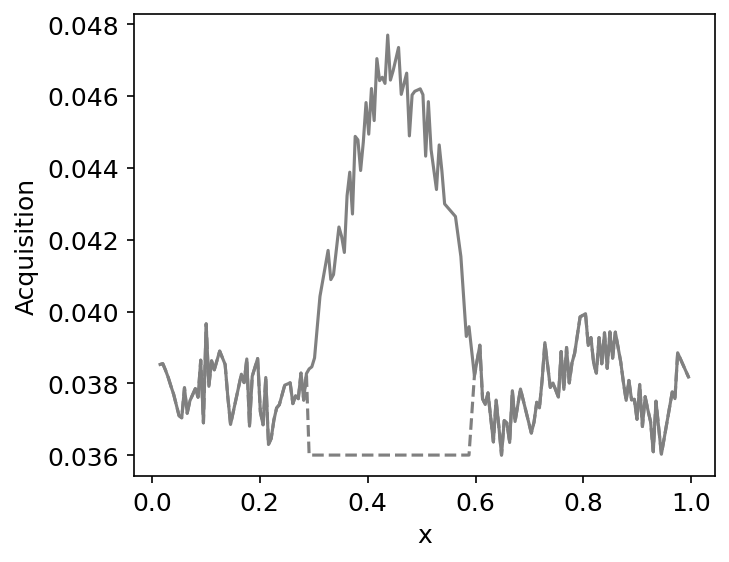

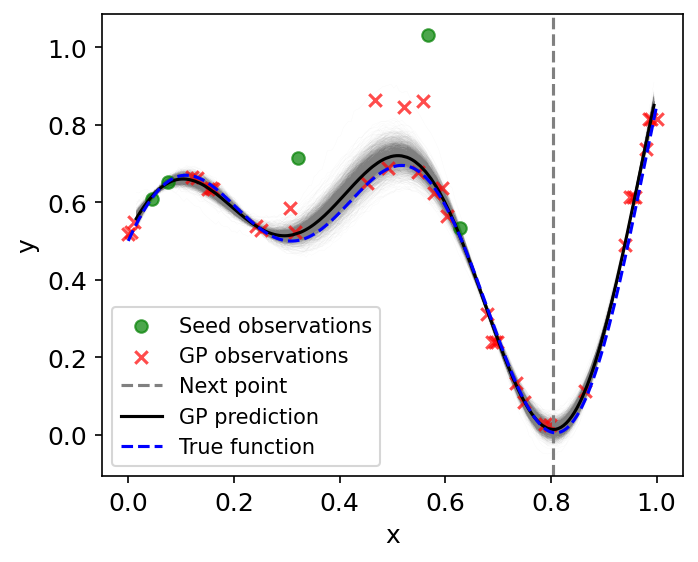


Exploration step 40


sample: 100%|██████████| 4000/4000 [00:31<00:00, 127.35it/s, 15 steps of size 2.59e-01. acc. prob=0.94]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.27      0.03      0.27      0.22      0.31   1384.40      1.00
          b     -0.95      0.04     -0.95     -1.02     -0.89   1320.02      1.00
          c      0.37      0.56      0.40     -0.60      1.22   1268.66      1.00
k_length[0]      6.56      5.73      4.93      0.74     12.94   1280.83      1.00
    k_scale      0.69      0.79      0.45      0.02      1.53   1451.88      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1476.55      1.00



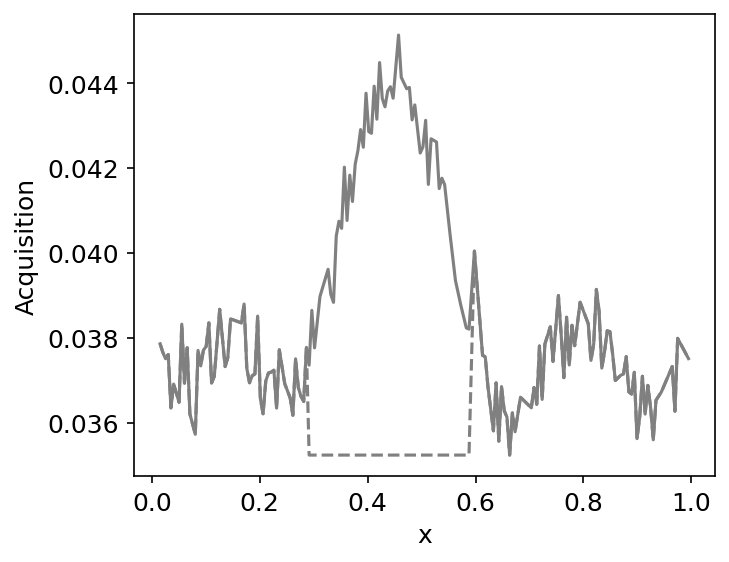

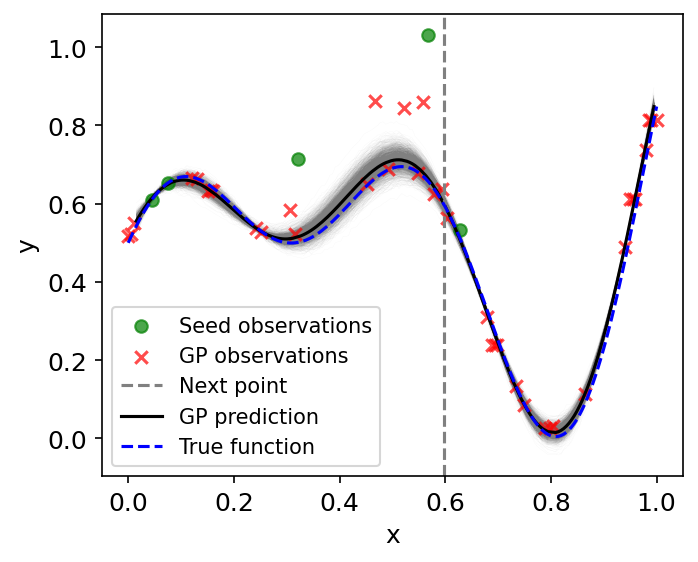


Exploration step 41


sample: 100%|██████████| 4000/4000 [00:31<00:00, 125.33it/s, 15 steps of size 3.22e-01. acc. prob=0.87]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.26      0.03      0.26      0.22      0.32   1076.88      1.00
          b     -0.95      0.05     -0.95     -1.02     -0.89    488.41      1.00
          c      0.35      0.60      0.39     -0.58      1.39   1199.91      1.00
k_length[0]      6.37      5.30      4.82      0.46     12.77   1237.74      1.00
    k_scale      0.71      0.80      0.48      0.02      1.61   1386.13      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1087.89      1.00



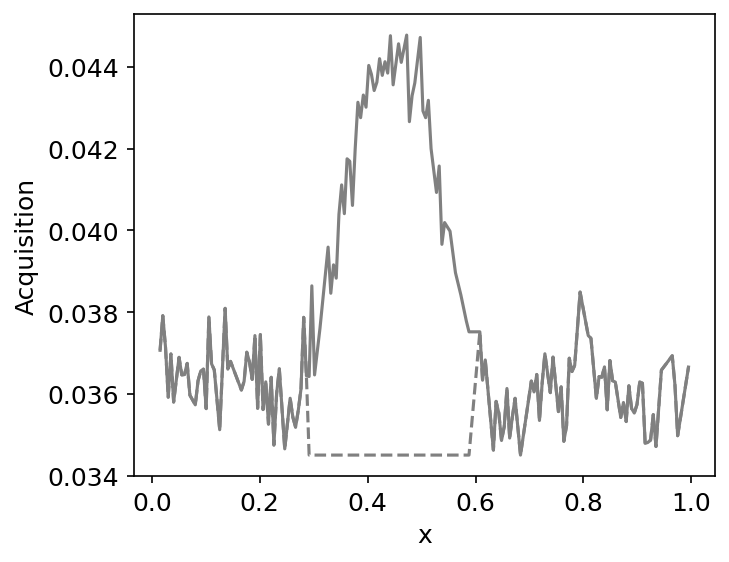

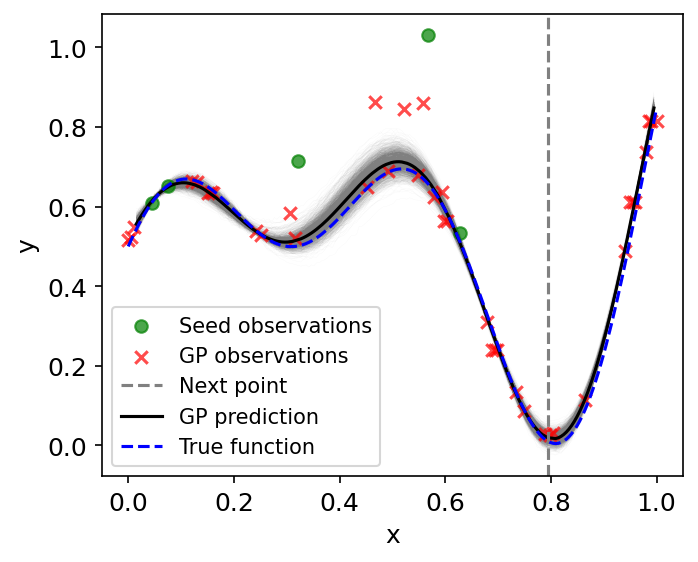


Exploration step 42


sample: 100%|██████████| 4000/4000 [00:32<00:00, 123.85it/s, 7 steps of size 3.48e-01. acc. prob=0.86] 



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.27      0.03      0.27      0.22      0.31    931.56      1.00
          b     -0.95      0.04     -0.95     -1.02     -0.88    881.93      1.00
          c      0.39      0.57      0.42     -0.53      1.32   1056.74      1.00
k_length[0]      6.29      5.83      4.57      0.48     12.59    979.85      1.00
    k_scale      0.72      0.90      0.45      0.03      1.62   1393.69      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1263.50      1.00



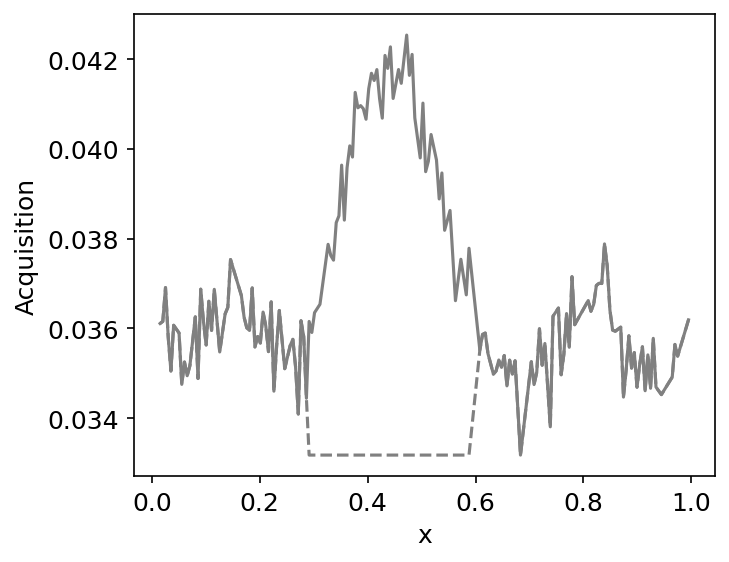

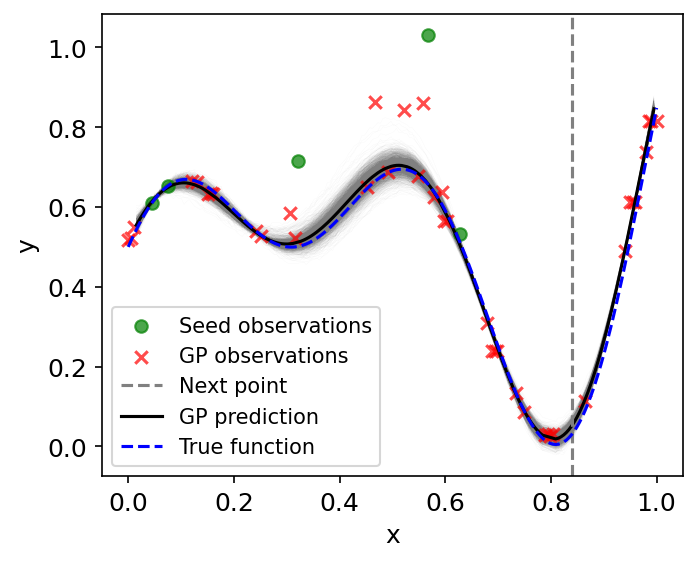


Exploration step 43


sample: 100%|██████████| 4000/4000 [00:32<00:00, 123.62it/s, 15 steps of size 2.92e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.27      0.03      0.27      0.22      0.31   1543.26      1.00
          b     -0.95      0.04     -0.95     -1.01     -0.89   1455.80      1.00
          c      0.41      0.56      0.42     -0.53      1.32   1525.55      1.00
k_length[0]      6.29      5.88      4.62      0.91     12.47   1157.28      1.00
    k_scale      0.73      0.90      0.47      0.02      1.61   1293.69      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1373.97      1.00



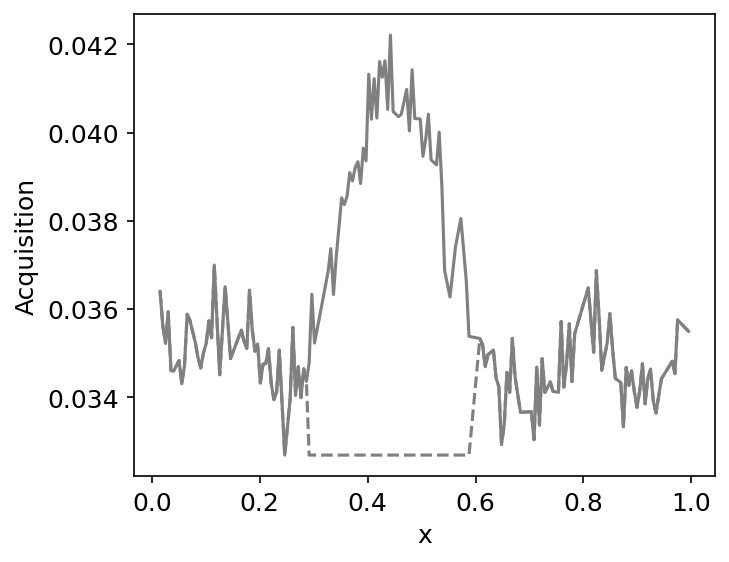

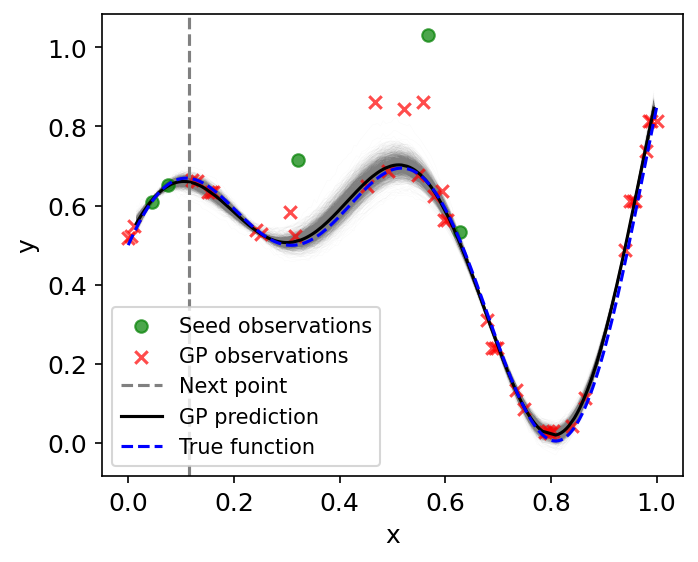


Exploration step 44


sample: 100%|██████████| 4000/4000 [00:32<00:00, 124.04it/s, 15 steps of size 3.18e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.27      0.03      0.27      0.23      0.31   1489.16      1.00
          b     -0.95      0.04     -0.95     -1.01     -0.89   1400.95      1.00
          c      0.39      0.59      0.42     -0.55      1.41   1137.14      1.00
k_length[0]      6.38      6.19      4.52      0.70     12.57   1251.98      1.00
    k_scale      0.73      0.90      0.46      0.02      1.59   1133.56      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1303.74      1.00



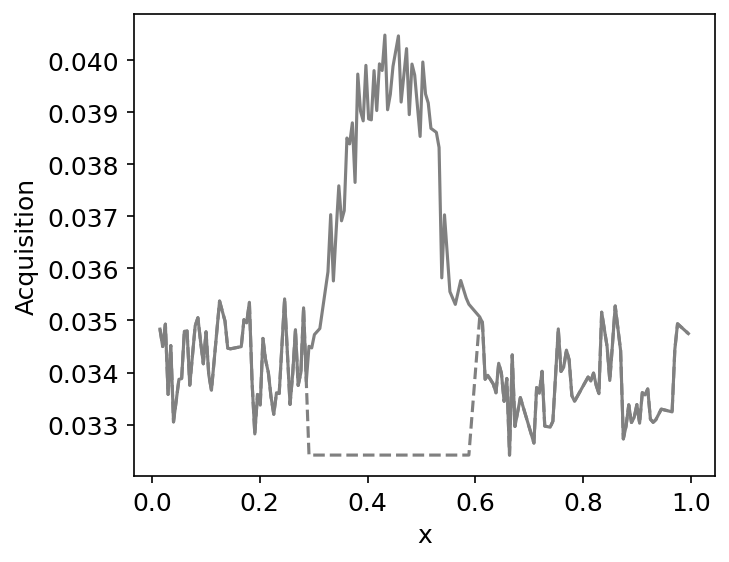

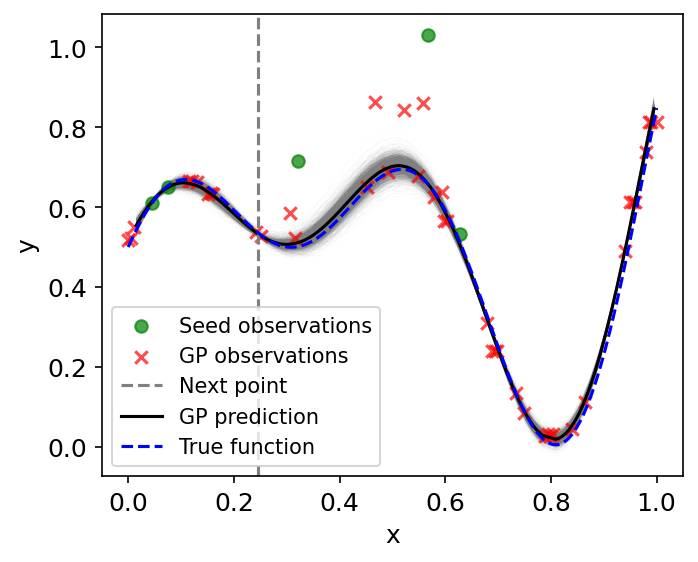


Exploration step 45


sample: 100%|██████████| 4000/4000 [00:39<00:00, 102.54it/s, 15 steps of size 2.45e-01. acc. prob=0.93]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.27      0.02      0.27      0.23      0.31   1236.30      1.00
          b     -0.95      0.03     -0.95     -1.01     -0.90   1136.78      1.00
          c      0.39      0.57      0.41     -0.48      1.37   1405.85      1.00
k_length[0]      6.51      5.93      4.81      0.62     12.79    919.97      1.00
    k_scale      0.74      0.85      0.48      0.02      1.61   1552.65      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1513.78      1.00



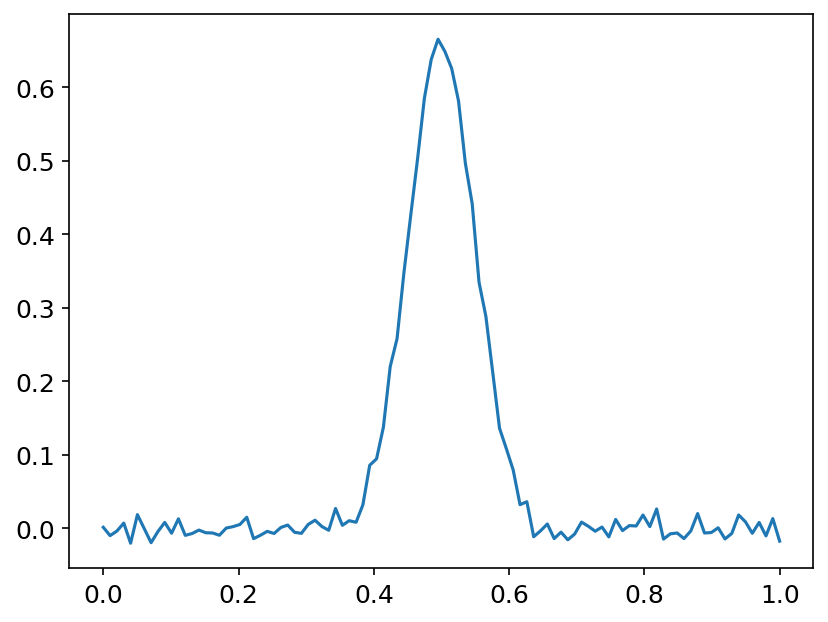

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


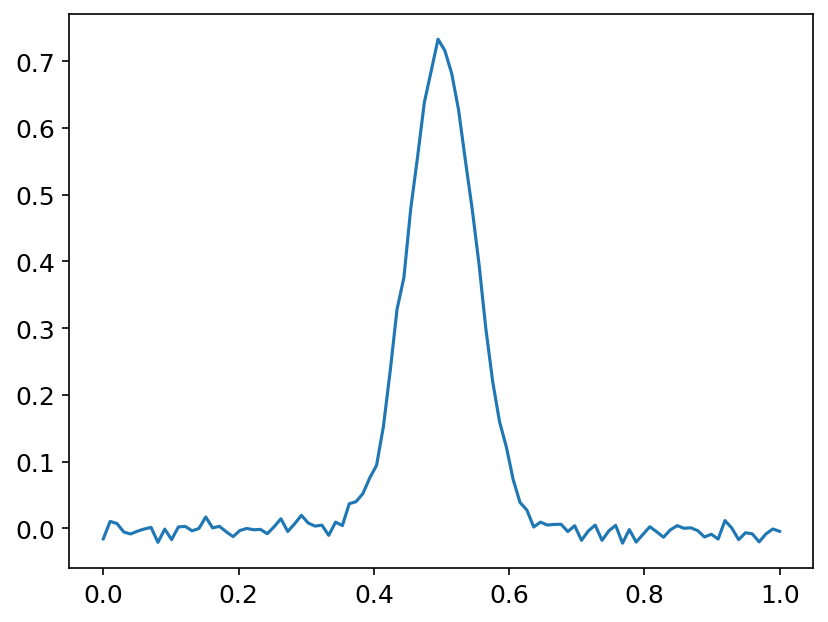

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


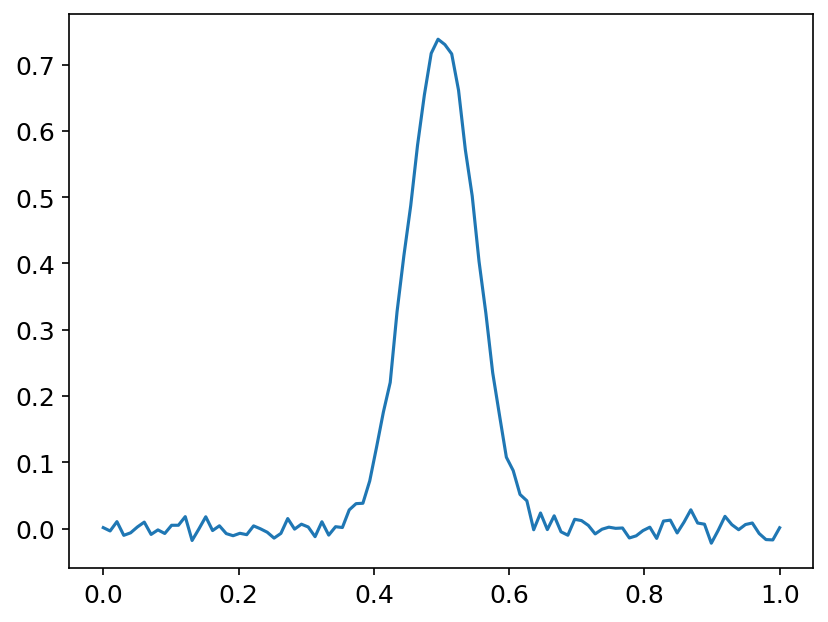

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


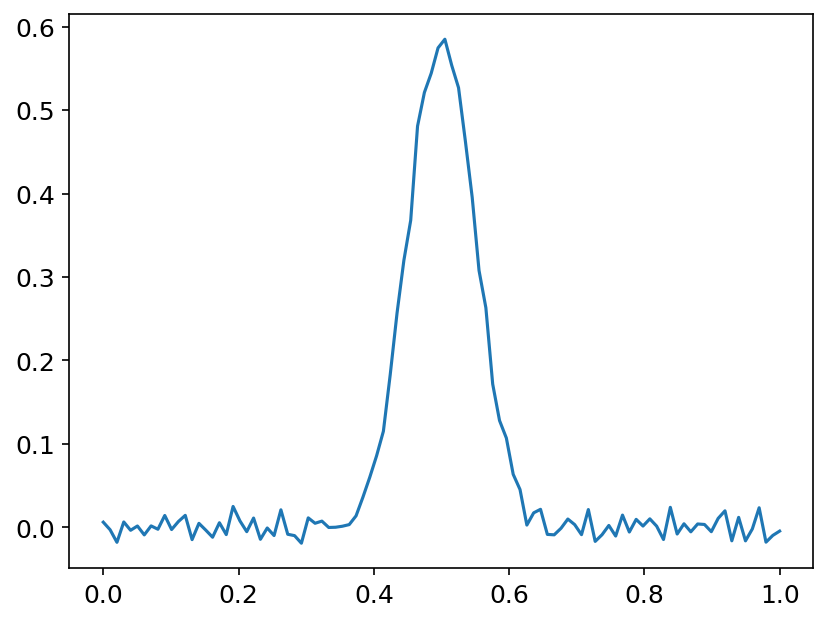

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


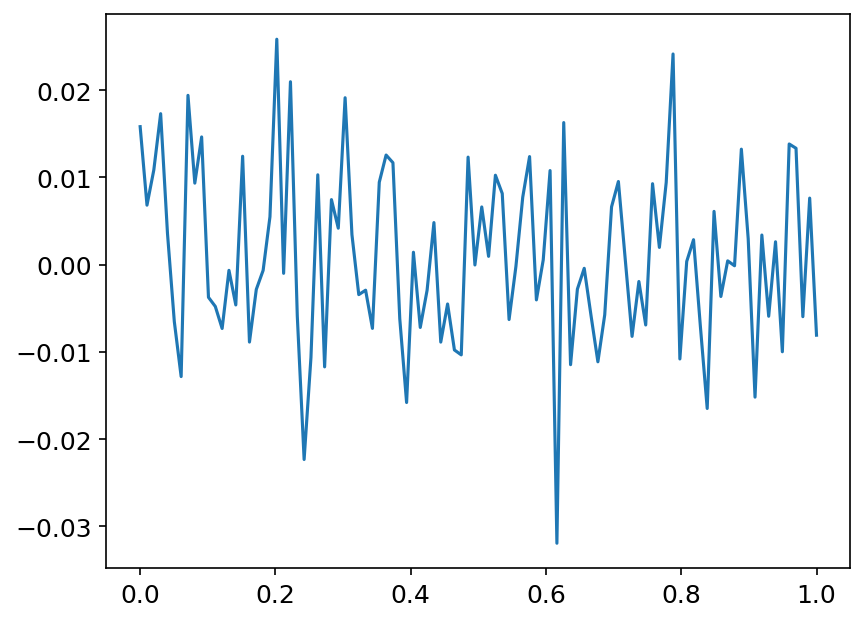

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
7


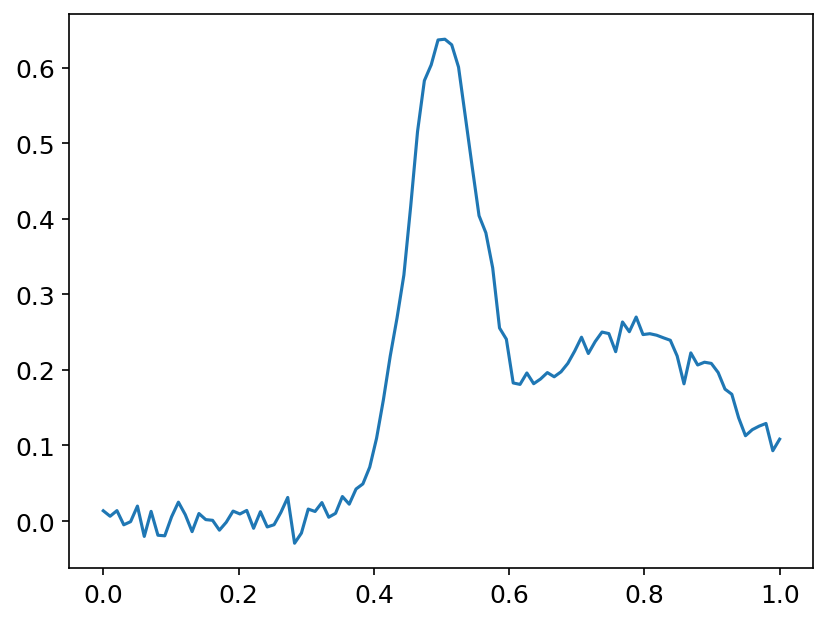

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
1


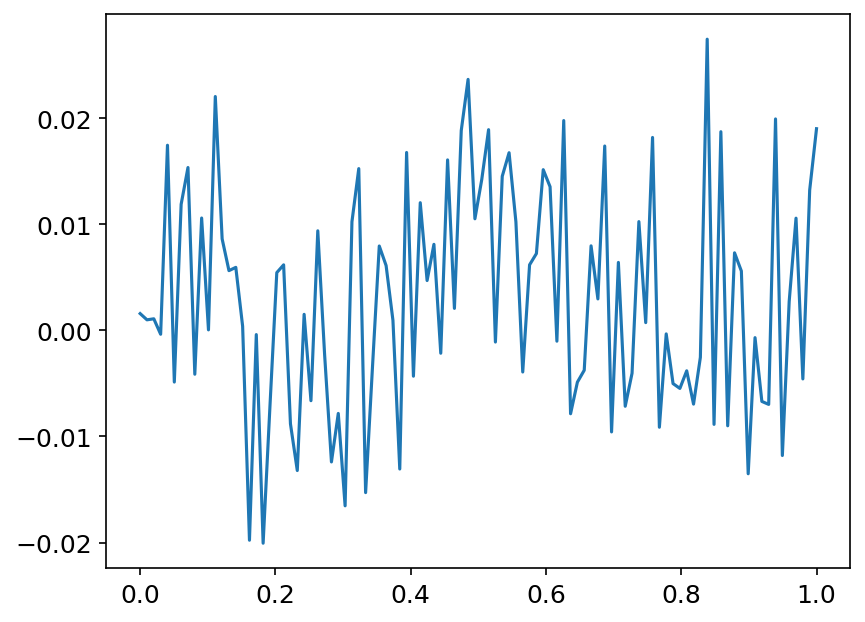

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
5


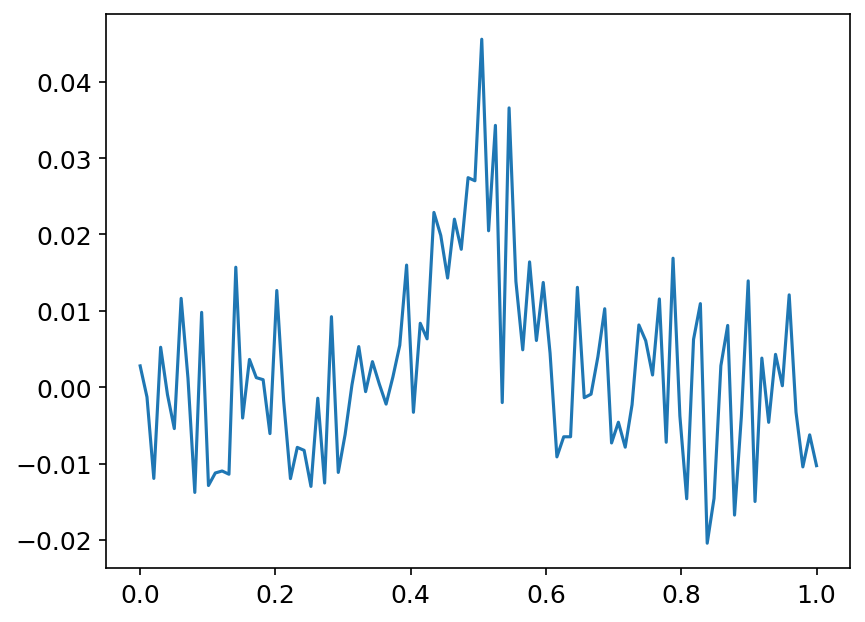

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
7


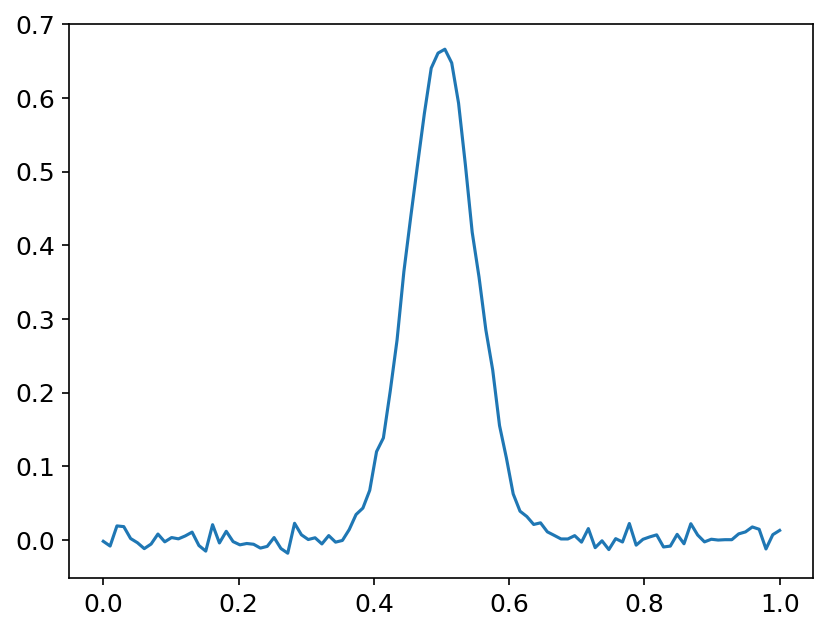

Please input a quality score 1 to 10 
for this raw spectrum, 1 means bad, 10 means good: 
9


sample: 100%|██████████| 4000/4000 [00:23<00:00, 168.74it/s, 7 steps of size 5.39e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
k_length[0]      0.76      1.00      0.64      0.11      1.26    826.73      1.00
    k_scale      1.30      1.14      0.96      0.19      2.57    800.69      1.00
      noise      0.10      0.03      0.10      0.06      0.14   1221.11      1.00



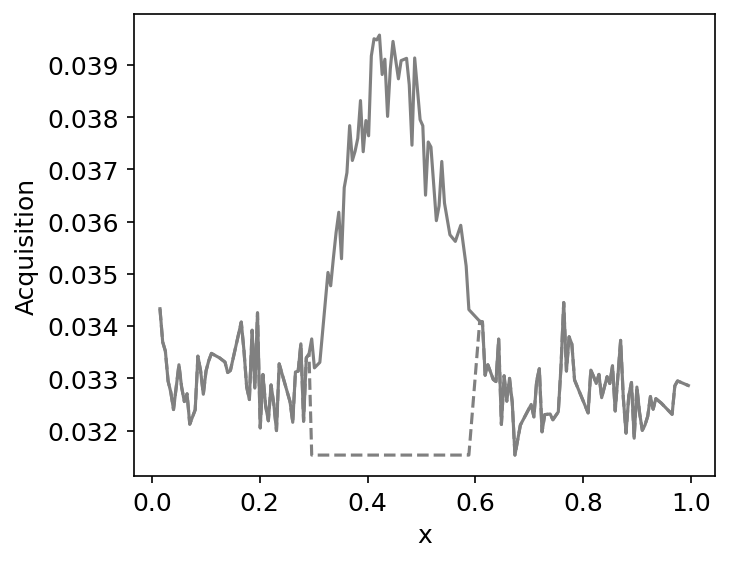

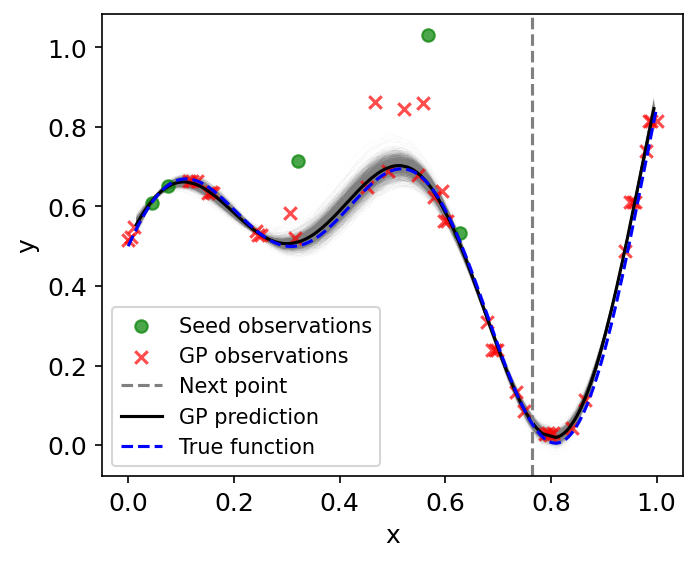


Exploration step 46


sample: 100%|██████████| 4000/4000 [00:35<00:00, 114.12it/s, 15 steps of size 2.98e-01. acc. prob=0.91]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.28      0.02      0.28      0.24      0.31   1390.50      1.00
          b     -0.95      0.04     -0.95     -1.00     -0.89   1151.18      1.00
          c      0.42      0.55      0.44     -0.48      1.28   1331.42      1.00
k_length[0]      5.36      4.76      4.03      0.71     10.78   1542.71      1.00
    k_scale      0.69      0.76      0.46      0.04      1.51   1641.64      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1573.50      1.00



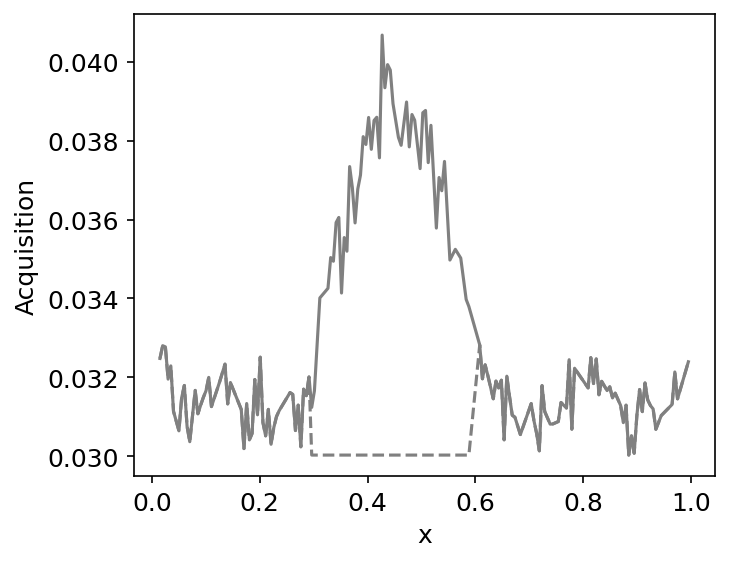

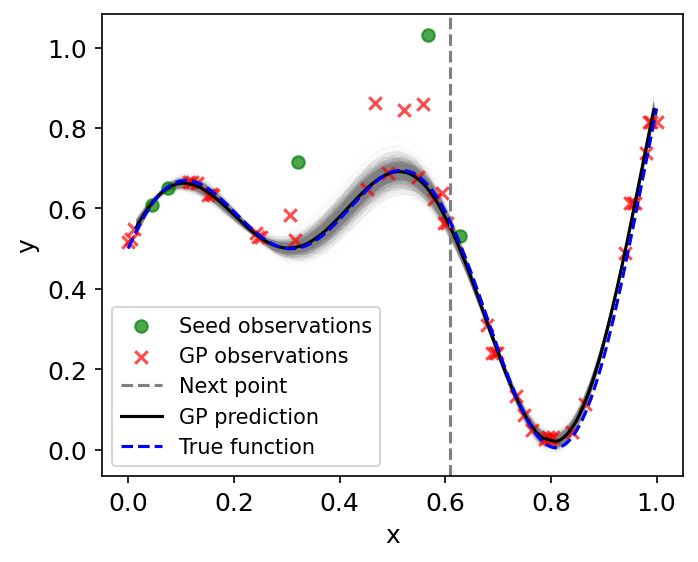


Exploration step 47


sample: 100%|██████████| 4000/4000 [00:43<00:00, 91.66it/s, 15 steps of size 2.85e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.28      0.03      0.28      0.24      0.32   1082.14      1.00
          b     -0.96      0.04     -0.96     -1.01     -0.90    893.79      1.00
          c      0.43      0.60      0.44     -0.60      1.40   1423.14      1.00
k_length[0]      5.59      5.31      4.03      0.70     11.06   1251.49      1.00
    k_scale      0.74      0.85      0.47      0.02      1.64   1519.71      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1458.67      1.00



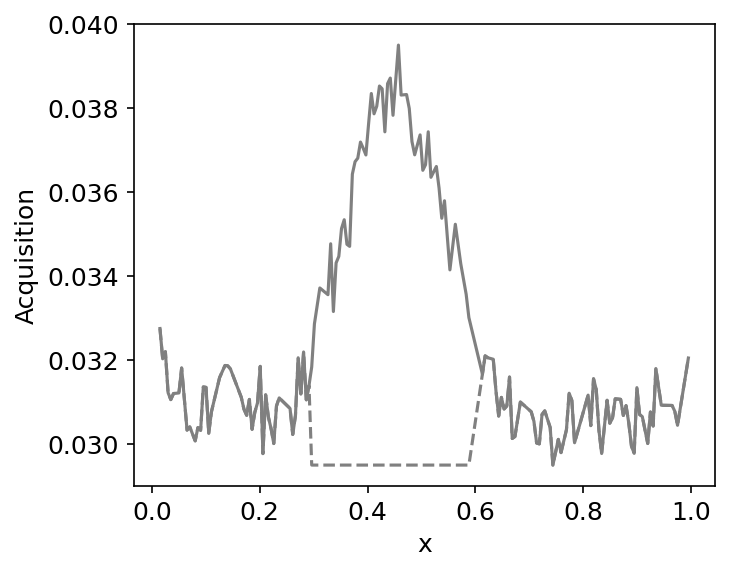

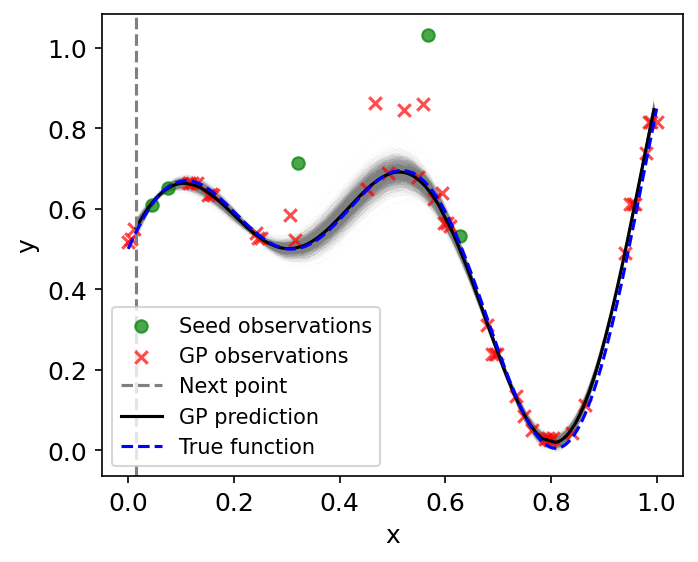


Exploration step 48


sample: 100%|██████████| 4000/4000 [00:39<00:00, 100.15it/s, 15 steps of size 3.07e-01. acc. prob=0.89]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.28      0.02      0.28      0.24      0.31   1321.10      1.00
          b     -0.95      0.03     -0.95     -1.01     -0.90   1342.40      1.00
          c      0.42      0.57      0.44     -0.61      1.27   1338.23      1.00
k_length[0]      5.35      4.79      3.83      0.81     10.62   1080.32      1.00
    k_scale      0.73      0.95      0.46      0.02      1.53   1180.40      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1473.57      1.00



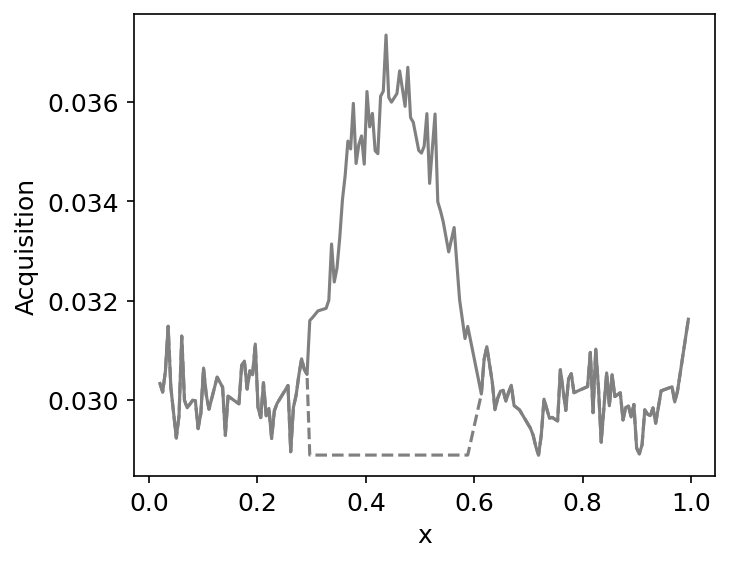

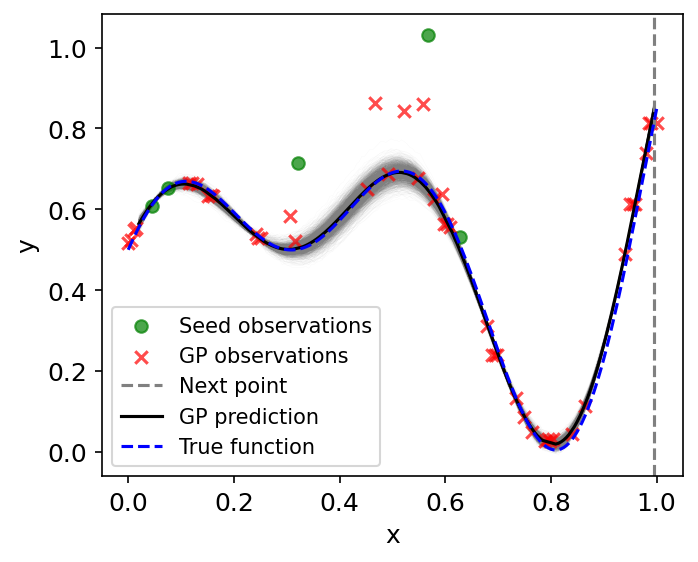


Exploration step 49


sample: 100%|██████████| 4000/4000 [00:33<00:00, 118.50it/s, 15 steps of size 2.36e-01. acc. prob=0.92]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.28      0.02      0.28      0.24      0.31   1328.07      1.00
          b     -0.95      0.03     -0.95     -1.00     -0.90   1498.43      1.00
          c      0.40      0.59      0.44     -0.52      1.42   1375.74      1.00
k_length[0]      5.46      5.13      3.97      0.71     10.46   1031.42      1.00
    k_scale      0.75      0.91      0.49      0.01      1.65   1480.89      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1476.21      1.00



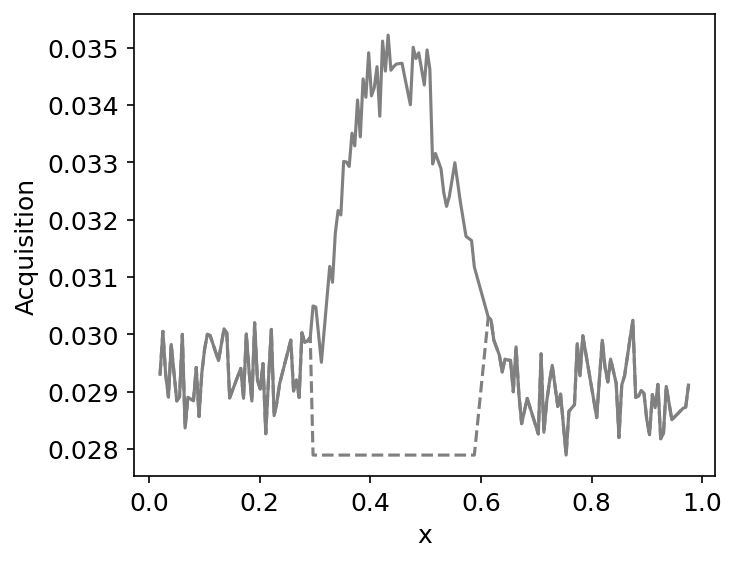

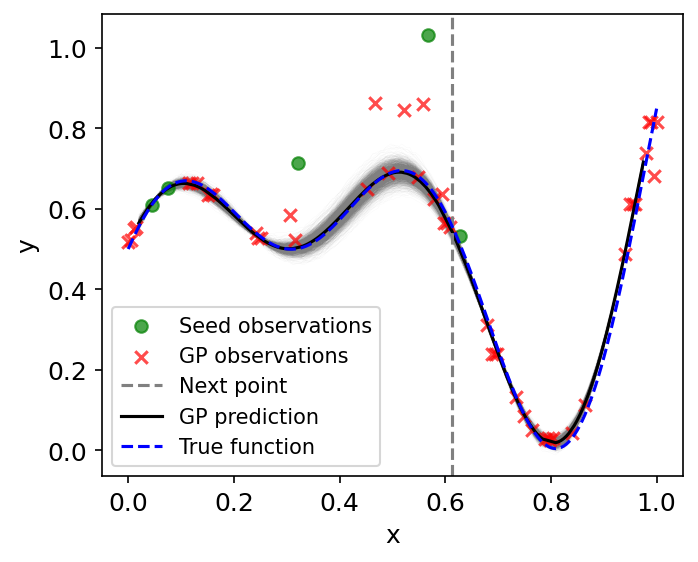


Exploration step 50


sample: 100%|██████████| 4000/4000 [00:35<00:00, 113.77it/s, 15 steps of size 3.13e-01. acc. prob=0.90]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
          a      0.27      0.03      0.27      0.21      0.32   1137.23      1.00
          b     -0.93      0.04     -0.93     -1.00     -0.85   1036.01      1.00
          c      0.36      0.57      0.39     -0.57      1.28   1220.15      1.00
k_length[0]      6.09      5.49      4.57      0.70     11.87   1101.84      1.00
    k_scale      0.72      0.85      0.46      0.03      1.59   1156.94      1.00
      noise      0.00      0.00      0.00      0.00      0.00   1537.31      1.00



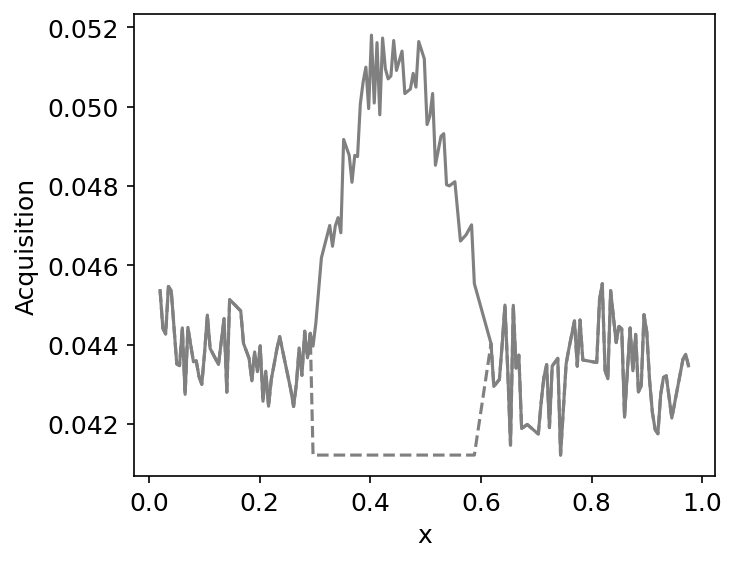

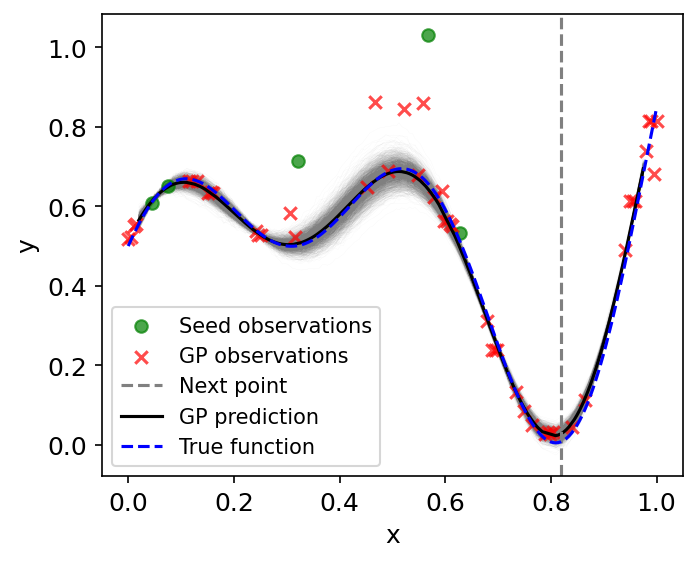

In [ ]:
rng_key, rng_key_predict = gpax.utils.get_keys(3)
exploration_steps = 50
intervation_interval = 9

for i in range(exploration_steps):
    print("\nExploration step {}".format(i+1))

    # Execute GP
    if i == 0:
      filter_score = second_GP(X_train_filter, norm_(y_train_filter), X)
      gpbo, obj, posterior_mean, f_samples = run_GP(X_train, y_train, X_test,
                                                    fn = custom_structure, fn_priors = custom_structure_priors)
    else:
      gpbo, obj, posterior_mean, f_samples = run_GP(X_train_update, y_train_update, X_test,
                                                    fn = custom_structure, fn_priors = custom_structure_priors)

    # Execute 2nd GP
    if (i+1) % intervation_interval == 0:
    # if i == 5 or i == 20:
      X_train_filter, y_train_filter, indices_train_filter = update_filter_data(intervation_interval, i)
      filter_score = second_GP(X_train_filter, norm_(y_train_filter), X)

    (obj1, obj2, X_train_update, y_train_update,
     y_train_spec_update, indices_train_update) = interven(filter_score, obj, X_train, y_train, y_train_spec,
                                                                                indices_train, indices_test)

    # Next point
    # get the next point to measure
    next_point_idx = obj1.argmax()
    y_next = y_test_spec[next_point_idx]
    next_point = X_test[next_point_idx]

    # Plot acquisition-------------------------
    fig, ax = plt.subplots(1, 1, figsize=(5, 4))
    ax.set_xlabel("x")
    ax.set_ylabel("Acquisition")
    ax.plot(X_test, obj, c = 'Gray', label = "Original Acquisition Function")
    ax.plot(X_test, obj1, c = 'Gray', linestyle='--', label = "Adjusted Acquisition Function")
    plt.show()

    # Plot results-------------------------
    fig, ax = plt.subplots(1, 1, figsize=(5, 4))
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.scatter(X_seed, y_seed, marker='o', c='g', zorder=1, label="Seed observations", alpha=0.7)
    ax.scatter(X_train[init_points:], y_train[init_points:], marker='x', c='r', zorder=1, label="GP observations", alpha=0.7)
    ax.axvline(next_point, linestyle = "--", c = "Gray", label="Next point")
    for y1 in f_samples:
      ax.plot(X_test, y1.mean(0), lw=.1, zorder=0, c='Gray', alpha=.1)
    l, = ax.plot(X_test, f_samples[0].mean(0), lw=1, c='Gray', alpha=1)
    ax.plot(X_test, posterior_mean, lw=1.5, zorder=1, c='black', label='GP prediction')
    ax.plot(X, y_amp, c='blue', linestyle='--', label='True function')
    ax.legend(); l.set_alpha(0)
    plt.show()
    #------------------------------------------#

    # Get mean function parameters
    fn_params = gpbo.get_samples()
    fn_a, fn_b, fn_c = fn_params['a'], fn_params['b'], fn_params['c']

    # Save results for post analysis
    np.savez("DualGP_step{}.npz".format(i+1), next_point_idx = next_point_idx, obj = obj,
             posterior_mean = posterior_mean, f_samples = f_samples, X_train = X_train,
             X_test = X_test, y_train_spec = y_train_spec, y_train = y_train,
             indices_train = indices_train, indices_test = indices_test,
             X_train_filter = X_train_filter, y_train_filter = y_train_filter,
             indices_train_filter = indices_train_filter, fn_a = fn_a, fn_b = fn_b, fn_c = fn_c)

    # Update Train and Test datasets
    (X_train, X_test, y_train, y_train_spec, y_test_spec,
     indices_train, indices_test) = update_data(next_point_idx, X_train, X_test, y_train,
                                                y_train_spec, y_test_spec, indices_train, indices_test)

# Compare single GP and dual GP performance

### Load Results

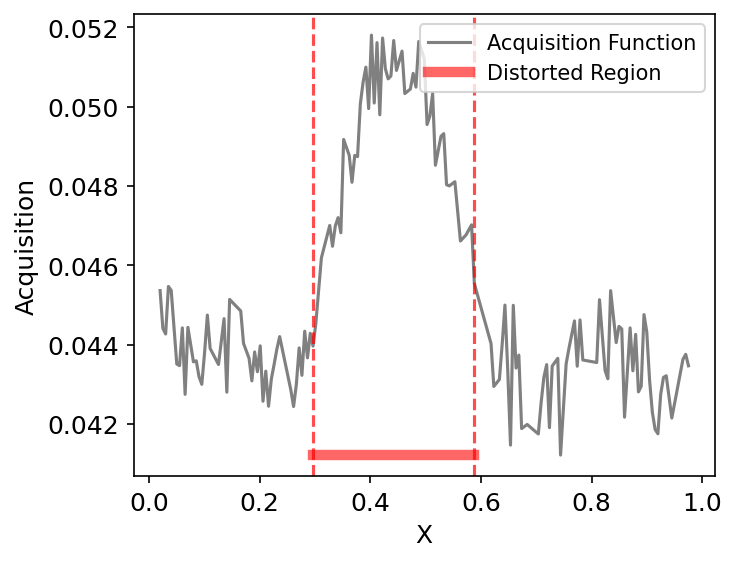

In [ ]:
# Plot acquisition-------------------------
obj_ = jnp.delete(obj, next_point_idx)
obj1_ = jnp.delete(obj1, next_point_idx)
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
ax.set_xlabel("X")
ax.set_ylabel("Acquisition")
ax.plot(X_test, obj_, c = 'Gray', label = "Acquisition Function")
ax.plot(X_test[np.where(obj1_ == obj1_.min())][:-1], obj1_[np.where(obj1_ == obj1_.min())][:-1],
           c = 'r', linewidth = 5, label = "Distorted Region", alpha = 0.6)
ax.axvline(x = X_test[np.where(obj1_ == obj1_.min())][-2], linestyle = "--", c = "r", alpha = 0.7)
ax.axvline(x = X_test[np.where(obj1_ == obj1_.min())][0], linestyle = "--", c = "r", alpha = 0.7)
plt.legend()
plt.show()

In [ ]:
params_a_s = []; params_b_s = []; params_c_s = []; uncertainty_s = []
params_a_d = []; params_b_d = []; params_c_d = []; uncertainty_d = []

for i in range (exploration_steps):
  # Load Single GP results
  fitresults = np.load("singleGP_step{}.npz".format(i))
  params_a_s.append(fitresults['fn_a'].mean())
  params_b_s.append(fitresults['fn_b'].mean())
  params_c_s.append(fitresults['fn_c'].mean())
  uncertainty_s.append(fitresults['f_samples'].mean())

  # LoaD Dual GP results
  fitresults = np.load("DualGP_step{}.npz".format(i+1))
  params_a_d.append(fitresults['fn_a'].mean())
  params_b_d.append(fitresults['fn_b'].mean())
  params_c_d.append(fitresults['fn_c'].mean())
  uncertainty_d.append(fitresults['f_samples'].mean())

### Plot Results

In [ ]:
human_intervention = np.asarray([8, 17, 26, 35, 44])

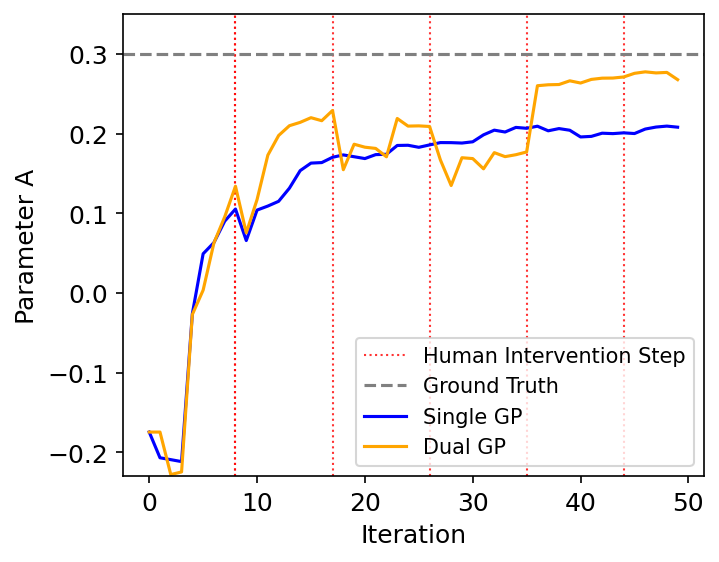

In [ ]:
# Plot Results-------------------------
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
ax.set_xlabel("Iteration")
ax.set_ylabel("Parameter A")
ax.set_ylim(-0.23, 0.35)
for i in human_intervention:
  ax.axvline(x = i, linestyle = ':', linewidth = 1, c = 'r', alpha = 0.8)
ax.axvline(x = 8, linestyle = ':', linewidth = 1, c = 'r', alpha = 0.8, label = "Human Intervention Step")
ax.axhline(y=A, color='Gray', linestyle='--', label = "Ground Truth")
ax.plot(params_a_s, c = 'Blue', label = "Single GP")
ax.plot(params_a_d, c = 'orange', label = "Dual GP")

ax.legend();
plt.show()

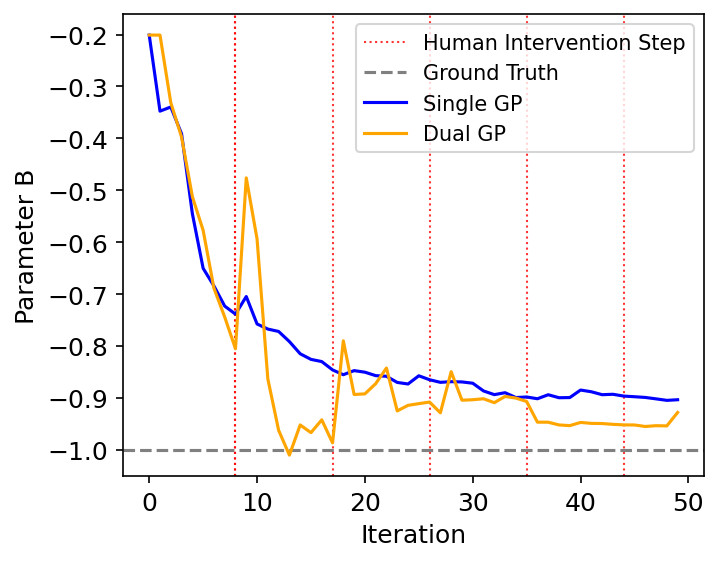

In [ ]:
# Plot Results-------------------------
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
ax.set_xlabel("Iteration")
ax.set_ylabel("Parameter B")
for i in human_intervention:
  ax.axvline(x = i, linestyle = ':', linewidth = 1, c = 'r', alpha = 0.8)
ax.axvline(x = 8, linestyle = ':', linewidth = 1, c = 'r', alpha = 0.8, label = "Human Intervention Step")
ax.axhline(y=B, color='Gray', linestyle='--', label = "Ground Truth")
ax.plot(params_b_s, c = 'Blue', label = "Single GP")
ax.plot(params_b_d, c = 'orange', label = "Dual GP")

ax.legend();
plt.show()

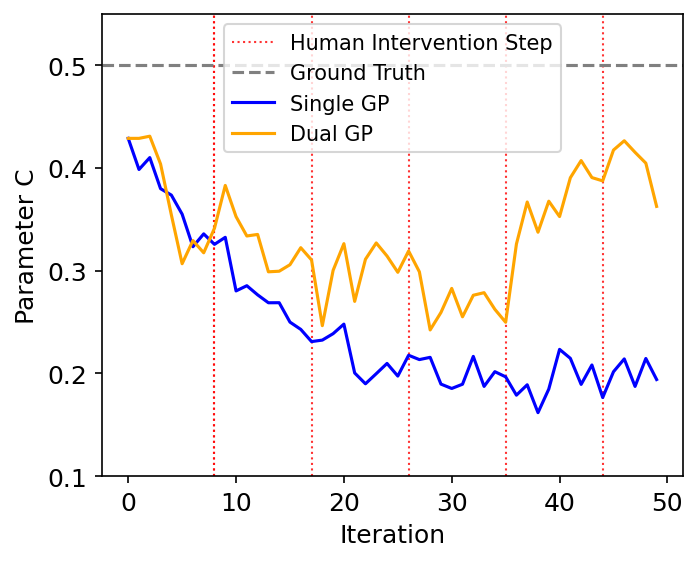

In [ ]:
# Plot Results-------------------------
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
ax.set_xlabel("Iteration")
ax.set_ylabel("Parameter C")
ax.set_ylim(0.1, 0.55)
for i in human_intervention:
  ax.axvline(x = i, linestyle = ':', linewidth = 1, c = 'r', alpha = 0.8)
ax.axvline(x = 8, linestyle = ':', linewidth = 1, c = 'r', alpha = 0.8, label = "Human Intervention Step")
ax.axhline(y=C, color='Gray', linestyle='--', label = "Ground Truth")
ax.plot(params_c_s, c = 'Blue', label = "Single GP")
ax.plot(params_c_d, c = 'orange', label = "Dual GP")
ax.legend();
plt.show()

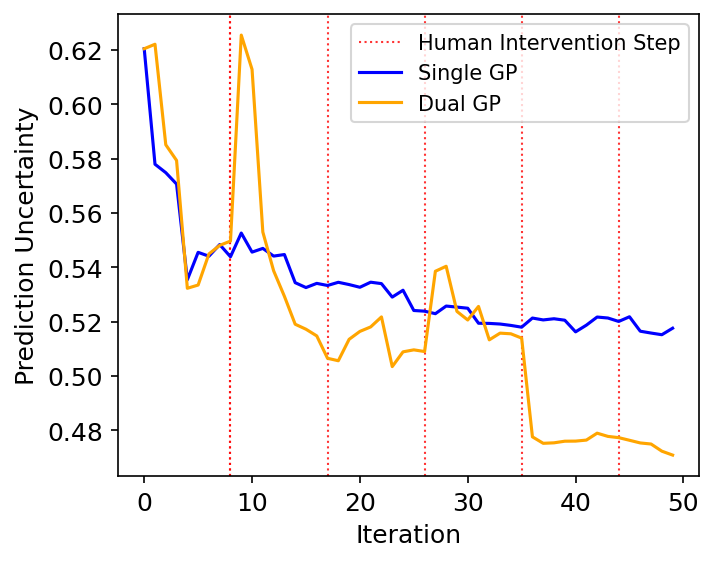

In [ ]:
# Plot Results-------------------------
fig, ax = plt.subplots(1, 1, figsize=(5, 4))
ax.set_xlabel("Iteration")
ax.set_ylabel("Prediction Uncertainty")
for i in human_intervention:
  ax.axvline(x = i, linestyle = ':', linewidth = 1, c = 'r', alpha = 0.8)
ax.axvline(x = 8, linestyle = ':', linewidth = 1, c = 'r', alpha = 0.8, label = "Human Intervention Step")
ax.plot(uncertainty_s, c = 'Blue', label = "Single GP")
ax.plot(uncertainty_d, c = 'orange', label = "Dual GP")
ax.legend();
plt.show()